# Данные для экспериментов

## Эксперимент 1 - Данные

In [ ]:
import kagglehub
import pandas as pd

path = kagglehub.dataset_download("martj42/international-football-results-from-1872-to-2017")
data = pd.read_csv(f'{path}/results.csv')

# Создание новых признаков
data['score_diff'] = data['home_score'] - data['away_score']
data['home_win'] = (data['home_score'] > data['away_score']).astype(int)
data['result'] = pd.cut(data['score_diff'], bins=[-float('inf'), -1, 0, float('inf')],
                        labels=['away_win', 'draw', 'home_win'])

# Удаление неинформативных признаков
data.drop(['home_score', 'away_score', 'score_diff', 'home_win'], axis=1, inplace=True)

100%|██████████| 1.14M/1.14M [00:00<00:00, 1.47MB/s]

Extracting files...


In [ ]:
data.to_csv('Experiment_1.csv', index=False)

## Эксперимент 2 - Данные

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
import kagglehub

path = kagglehub.dataset_download("martj42/international-football-results-from-1872-to-2017")
data = pd.read_csv(f'{path}/results.csv')
# Преобразование категориальных признаков
data = pd.get_dummies(data, columns=['home_team', 'away_team', 'tournament', 'city', 'country'])

# Извлечение признаков из даты
data['date'] = pd.to_datetime(data['date'])
data['year'] = data['date'].dt.year
data['month'] = data['date'].dt.month
data['dayofweek'] = data['date'].dt.dayofweek

data['score_diff'] = data['home_score'] - data['away_score']
data['home_win'] = (data['home_score'] > data['away_score']).astype(int)
# Создание категориальной целевой переменной
data['result'] = pd.cut(data['score_diff'], bins=[-float('inf'), -1, 0, float('inf')], labels=['away_win', 'draw', 'home_win'])
data = data.drop(['score_diff', 'home_score', 'away_score', 'date', 'home_win'], axis=1)

100%|██████████| 1.14M/1.14M [00:00<00:00, 70.0MB/s]

Extracting files...


In [ ]:
data.to_csv('Experiment_2.csv', index=False)

In [ ]:
#from sklearn.model_selection import train_test_split
#X = data.drop(['result'], axis=1) # признаки
#y = data['result'] # целевая переменная
#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

## Эксперимент 3 - Данные

In [ ]:
import kagglehub
import pandas as pd

path = kagglehub.dataset_download("martj42/international-football-results-from-1872-to-2017")
data = pd.read_csv(f'{path}/results.csv')

# Кодирование категориальных переменных
from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()
data['home_team_encoded'] = label_encoder.fit_transform(data['home_team'])
data['away_team_encoded'] = label_encoder.fit_transform(data['away_team'])
print("Пример кодированных данных:")
print(data[['home_team', 'home_team_encoded']].head())

# Генерация новых признаков
# Разница в счете
data['score_difference'] = data['home_score'] - data['away_score']
print("Пример новых признаков (разница в счете):")
print(data[['home_score', 'away_score', 'score_difference']].head())

# Результат матча
def classify_result(diff):
    if diff > 0:
        return 'win'
    elif diff < 0:
        return 'loss'
    else:
        return 'draw'

data['match_result'] = data['score_difference'].apply(classify_result)
print("Пример новых признаков (результат матча):")
print(data[['score_difference', 'match_result']].head())

# Нормализация данных
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
data[['home_score', 'away_score', 'score_difference']] = scaler.fit_transform(data[['home_score', 'away_score', 'score_difference']])
print("Пример нормализованных данных:")
print(data[['home_score', 'away_score', 'score_difference']].head())
# Генерация дополнительных признаков
# Год и месяц матча
data['year'] = pd.to_datetime(data['date']).dt.year
data['month'] = pd.to_datetime(data['date']).dt.month
print("Пример признаков года и месяца:")
print(data[['date', 'year', 'month']].head())

# День недели матча
data['day_of_week'] = pd.to_datetime(data['date']).dt.day_name()
print("Пример признаков дня недели:")
print(data[['date', 'day_of_week']].head())

# Историческая результативность команд
def calculate_team_performance(team, score_column):
    return data.groupby(team)[score_column].transform('mean')

data['home_team_avg_score'] = calculate_team_performance('home_team', 'home_score')
data['away_team_avg_score'] = calculate_team_performance('away_team', 'away_score')

# Средняя результативность команды за последние N матчей
def calculate_recent_performance(team_column, score_column, n):
    recent_performance = data.groupby(team_column).apply(
        lambda group: group[score_column].rolling(window=n, min_periods=1).mean()
    ).reset_index(level=0, drop=True)
    return recent_performance

data['home_team_recent_performance'] = calculate_recent_performance('home_team', 'home_score', 5)
data['away_team_recent_performance'] = calculate_recent_performance('away_team', 'away_score', 5)
# Исторический баланс матчей между командами
def calculate_head_to_head_balance(home_team_col, away_team_col):
    balance = []
    for _, row in data.iterrows():
        home_team = row[home_team_col]
        away_team = row[away_team_col]
        past_matches = data[(data['home_team'] == home_team) & (data['away_team'] == away_team)]
        wins = (past_matches['score_difference'] > 0).sum()
        losses = (past_matches['score_difference'] < 0).sum()
        balance.append(wins - losses)
    return balance

data['head_to_head_balance'] = calculate_head_to_head_balance('home_team', 'away_team')

from sklearn.preprocessing import LabelEncoder

# Список категориальных переменных для кодирования
categorical_columns = ['home_team', 'away_team', 'tournament']

# Применение LabelEncoder ко всем категориальным переменным
label_encoders = {}
for column in categorical_columns:
    le = LabelEncoder()
    data[column + '_encoded'] = le.fit_transform(data[column])
    label_encoders[column] = le  # Сохраняем энкодеры для использования при тестировании

In [ ]:
data = data.drop(['date', 'home_team', 'away_team', 'tournament',
                      'city', 'country', 'day_of_week', 'score_difference', 'home_score', 'away_score'], axis=1)

In [ ]:
data.to_csv('Experiment_3.csv', index=False)

In [ ]:
# Удаляем ненужные столбцы и формируем признаки
#features = data.drop(['match_result'], axis=1)
#target = data['match_result']

# Разделение данных на обучающую и тестовую выборки
#from sklearn.model_selection import train_test_split

#X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.2, random_state=42)

## Эксперимент 4 - Данные

In [ ]:
import kagglehub
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

path = kagglehub.dataset_download("martj42/international-football-results-from-1872-to-2017")
data = pd.read_csv(f'{path}/results.csv')

# Обработка категориальных данных с использованием частотного кодирования
def frequency_encoding(df, column):
    freq_map = df[column].value_counts(normalize=True).to_dict()
    df[column + '_freq'] = df[column].map(freq_map)
    df.drop(column, axis=1, inplace=True)
    return df

# Применение Frequency Encoding
for col in ['home_team', 'away_team', 'tournament', 'city', 'country']:
    data = frequency_encoding(data, col)

# Извлечение временных признаков
data['date'] = pd.to_datetime(data['date'])
data['year'] = data['date'].dt.year
data['month'] = data['date'].dt.month
data['dayofweek'] = data['date'].dt.dayofweek

# Удаление оригинальной даты
data.drop(['date'], axis=1, inplace=True)

# Создание новых признаков
data['score_diff'] = data['home_score'] - data['away_score']
data['home_win'] = (data['home_score'] > data['away_score']).astype(int)
data['result'] = pd.cut(data['score_diff'], bins=[-float('inf'), -1, 0, float('inf')],
                        labels=['away_win', 'draw', 'home_win'])

# Удаление неинформативных признаков
data.drop(['home_score', 'away_score', 'score_diff', 'home_win'], axis=1, inplace=True)

In [ ]:
data.to_csv('Experiment_4.csv', index=False)

In [ ]:
# Разделение данных
#X = data.drop(['result'], axis=1)  # Признаки
#y = data['result']  # Целевая переменная

# Масштабирование данных
#scaler = StandardScaler()
#X_scaled = scaler.fit_transform(X)

# Снижение размерности (опционально)
#pca = PCA(n_components=min(X_scaled.shape[0], X_scaled.shape[1]))
#X_pca = pca.fit_transform(X_scaled)

# Разделение на обучающую и тестовую выборки
#X_train, X_test, y_train, y_test = train_test_split(X_pca, y, test_size=0.2, random_state=42, stratify=y)

## Эксперимент 5 - Данные

In [ ]:
import numpy as np
import kagglehub
import pandas as pd

path = kagglehub.dataset_download("martj42/international-football-results-from-1872-to-2017")
data = pd.read_csv(f'{path}/results.csv')

# Преобразуем дату в datetime, если она не в нужном формате
data['date'] = pd.to_datetime(data['date'])

# Создаём два отдельных датафрейма: для домашней и гостевой команды
home_data = data[['date', 'home_team', 'home_score', 'away_score']].copy()
home_data.rename(columns={'home_team': 'team', 'home_score': 'goals_scored', 'away_score': 'goals_conceded'}, inplace=True)
home_data['is_home'] = 1

away_data = data[['date', 'away_team', 'away_score', 'home_score']].copy()
away_data.rename(columns={'away_team': 'team', 'away_score': 'goals_scored', 'home_score': 'goals_conceded'}, inplace=True)
away_data['is_home'] = 0

# Объединяем обе таблицы
team_data = pd.concat([home_data, away_data])
team_data = team_data.sort_values(by=['team', 'date']).reset_index(drop=True)

# Генерация скользящих окон
window_sizes = [3, 5]  # Размеры окон
for window in window_sizes:
    team_data[f'rolling_avg_goals_scored_{window}'] = team_data.groupby('team')['goals_scored'].transform(
        lambda x: x.rolling(window, min_periods=1).mean()
    )
    team_data[f'rolling_avg_goals_conceded_{window}'] = team_data.groupby('team')['goals_conceded'].transform(
        lambda x: x.rolling(window, min_periods=1).mean()
    )

# Генерация лагов
lags = [1, 2]  # Лаги на 1 и 2 игры назад
for lag in lags:
    team_data[f'lag_goals_scored_{lag}'] = team_data.groupby('team')['goals_scored'].shift(lag)
    team_data[f'lag_goals_conceded_{lag}'] = team_data.groupby('team')['goals_conceded'].shift(lag)

# Дополнительные признаки
team_data['rolling_goal_diff'] = team_data['rolling_avg_goals_scored_3'] - team_data['rolling_avg_goals_conceded_3']

# Удаление строк с NaN (вызванных лагами)
team_data = team_data.dropna().reset_index(drop=True)

# Создание целевой переменной
team_data['match_result'] = team_data.apply(
    lambda row: 2 if row['goals_scored'] > row['goals_conceded'] else (0 if row['goals_scored'] < row['goals_conceded'] else 1),
    axis=1
)
team_data = team_data.drop(['goals_scored', 'goals_conceded'], axis=1)



In [ ]:
team_data.to_csv('Experiment_5.csv', index=False)

In [ ]:
# Выбираем признаки и целевую переменную
#features = team_data.drop(columns=['match_result'])
#target = team_data['match_result']

## Не вошедшее - Данные

In [ ]:
from sklearn.preprocessing import PolynomialFeatures
import numpy as np

# Загрузка данных
data = pd.read_csv(f'{path}/results.csv')

# ====== Шаг 2: Извлечение и преобразование признаков ======
# Убедитесь, что дата преобразована
data['date'] = pd.to_datetime(data['date'])

# Извлечение временных признаков
data['year'] = data['date'].dt.year
data['month'] = data['date'].dt.month
data['dayofweek'] = data['date'].dt.dayofweek

# Добавление новых временных взаимодействий
data['year_month'] = data['year'] * data['month']
data['day_of_week_month'] = data['dayofweek'] * data['month']

# 2.1. Создание взаимодействий между категориальными признаками
data['home_away_interaction'] = data['home_team'] + '_' + data['away_team']
data['home_tournament_interaction'] = data['home_team'] + '_' + data['tournament']

# 2.2. Генерация числовых признаков
# Удаляем признаки, напрямую связанные с целевой переменной
# Вместо этого используем отношения и взаимодействия между признаками
data['score_ratio'] = data['home_score'] / (data['away_score'] + 1e-5)
data['score_sum'] = data['home_score'] + data['away_score']
data['score_product'] = data['home_score'] * data['away_score']

# 2.3. Сгруппировать редкие категории (например, команды)
top_teams = data['home_team'].value_counts().nlargest(10).index
data['home_team'] = data['home_team'].apply(lambda x: x if x in top_teams else 'Other')
top_teams_away = data['away_team'].value_counts().nlargest(10).index
data['away_team'] = data['away_team'].apply(lambda x: x if x in top_teams_away else 'Other')

# 2.4. Полиномиальные взаимодействия между числовыми признаками
data['home_score'] = pd.to_numeric(data['home_score'], errors='coerce')
data['away_score'] = pd.to_numeric(data['away_score'], errors='coerce')
data = data.dropna(subset=['home_score', 'away_score'])  # Drop rows with NaN in these columns

numerical_data = data[['home_score', 'away_score', 'year']]
poly = PolynomialFeatures(degree=2, interaction_only=True, include_bias=False)
poly_features = poly.fit_transform(numerical_data)

# Explicitly create column names for poly_df
poly_feature_names = poly.get_feature_names_out(numerical_data.columns)
poly_df = pd.DataFrame(poly_features, columns=poly_feature_names, index=data.index) # Use the same index as data

# --- FIX: Drop existing columns to avoid conflicts before concatenation ---
data = data.drop(columns=['home_score', 'away_score', 'year'], errors='ignore')
data = pd.concat([data, poly_df], axis=1)

# 2.5. Логарифмическое преобразование и корень
# Вместо логарифмического преобразования используем нормализацию
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
data[['score_ratio', 'score_sum', 'score_product']] = scaler.fit_transform(
    data[['score_ratio', 'score_sum', 'score_product']])

# 2.6. Удаление ненужных столбцов
data.drop(columns=['home_team', 'away_team', 'tournament', 'score_diff', 'home_score_log', 'away_score_sqrt'], inplace=True, errors='ignore')

# ====== Шаг 3: Экспорт подготовленных данных ======
data.to_csv('nevoshedshee.csv', index=False)

# Зависимости

In [ ]:
!pip install h2o
!pip install tpot
!pip install autogluon
!pip install dask[dataframe]

In [ ]:
import re
import h2o
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from h2o.automl import H2OAutoML
from tpot import TPOTClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from xgboost import XGBClassifier, DMatrix
from autogluon.tabular import TabularPredictor
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import StratifiedKFold
from tpot.config import classifier_config_dict
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, roc_auc_score, f1_score, precision_score, recall_score, confusion_matrix

# Эксперимент 1

In [ ]:
data = pd.read_csv('/content/Experiment_1.csv')

In [ ]:
print(data['result'].value_counts())

result
home_win    23484
away_win    13531
draw        10902
Name: count, dtype: int64


In [ ]:
data.head()

,date,home_team,away_team,tournament,city,country,neutral,result
0,1872-11-30,Scotland,England,Friendly,Glasgow,Scotland,False,draw
1,1873-03-08,England,Scotland,Friendly,London,England,False,home_win
2,1874-03-07,Scotland,England,Friendly,Glasgow,Scotland,False,home_win
3,1875-03-06,England,Scotland,Friendly,London,England,False,draw
4,1876-03-04,Scotland,England,Friendly,Glasgow,Scotland,False,home_win


## H2O

In [ ]:
metrics_data = []

def print_metric():
  y_pred = aml.leader.predict(test)
  y_pred_df = y_pred.as_data_frame()['predict']

  y_test_df = test['result'].as_data_frame()['result']
  y_pred_df = y_pred_df.astype(y_test_df.dtype)

  accuracy = accuracy_score(y_test_df, y_pred_df)
  f1 = f1_score(y_test_df, y_pred_df, average='weighted')
  precision = precision_score(y_test_df, y_pred_df, average='weighted')
  recall = recall_score(y_test_df, y_pred_df, average='weighted')
  roc_auc = roc_auc_score(y_test_df, y_pred.as_data_frame()[y_pred.as_data_frame().columns[1:]], multi_class='ovr', average='weighted')
  cm = confusion_matrix(y_test_df, y_pred_df)


  print(f"Accuracy: {accuracy}")
  print(f"F1-score: {f1}")
  print(f"Precision: {precision}")
  print(f"Recall: {recall}")
  print(f"ROC-AUC: {roc_auc}")
  print("Confusion Matrix:\n", cm)
  print(classification_report(y_test_df, y_pred_df))

In [ ]:
h2o.init()
h2o_df = h2o.import_file('Experiment_1.csv')
target = 'result'
features = [col for col in h2o_df.columns if col != target]
train, test = h2o_df.split_frame(ratios=[0.8], seed=42)

Checking whether there is an H2O instance running at http://localhost:54321..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "11.0.25" 2024-10-15; OpenJDK Runtime Environment (build 11.0.25+9-post-Ubuntu-1ubuntu122.04); OpenJDK 64-Bit Server VM (build 11.0.25+9-post-Ubuntu-1ubuntu122.04, mixed mode, sharing)
  Starting server from /usr/local/lib/python3.11/dist-packages/h2o/backend/bin/h2o.jar
  Ice root: /tmp/tmp7_z_pl3b
  JVM stdout: /tmp/tmp7_z_pl3b/h2o_unknownUser_started_from_python.out
  JVM stderr: /tmp/tmp7_z_pl3b/h2o_unknownUser_started_from_python.err
  Server is running at http://127.0.0.1:54321
Connecting to H2O server at http://127.0.0.1:54321 ... successful.


H2O_cluster_uptime:,10 secs
H2O_cluster_timezone:,Etc/UTC
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.46.0.6
H2O_cluster_version_age:,2 months and 14 days
H2O_cluster_name:,H2O_from_python_unknownUser_v6r7di
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,3.170 Gb
H2O_cluster_total_cores:,2
H2O_cluster_allowed_cores:,2
H2O_cluster_status:,"locked, healthy"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


In [ ]:
aml = H2OAutoML(max_runtime_secs=3600, seed=42, project_name="feature_e11", balance_classes=True)
aml.train(x=features, y=target, training_frame=train)

AutoML progress: |███████████████████████████████████████████████████████████████| (done) 100%


key,value
Stacking strategy,cross_validation
Number of base models (used / total),27/28
# GBM base models (used / total),13/13
# XGBoost base models (used / total),9/9
# DeepLearning base models (used / total),3/3
# DRF base models (used / total),2/2
# GLM base models (used / total),0/1
Metalearner algorithm,GLM
Metalearner fold assignment scheme,Random
Metalearner nfolds,5


In [ ]:
aml.leaderboard

model_id,mean_per_class_error,logloss,rmse,mse
StackedEnsemble_AllModels_3_AutoML_1_20250116_91727,0.525974,0.909032,0.582187,0.338942
StackedEnsemble_AllModels_2_AutoML_1_20250116_91727,0.527152,0.911278,0.583186,0.340106
StackedEnsemble_BestOfFamily_3_AutoML_1_20250116_91727,0.528387,0.912435,0.583725,0.340735
StackedEnsemble_AllModels_1_AutoML_1_20250116_91727,0.52986,0.913166,0.583912,0.340953
StackedEnsemble_BestOfFamily_2_AutoML_1_20250116_91727,0.530602,0.914686,0.584535,0.341681
StackedEnsemble_BestOfFamily_1_AutoML_1_20250116_91727,0.531792,0.915698,0.584903,0.342111
GBM_5_AutoML_1_20250116_91727,0.535659,0.934868,0.586646,0.344153
GBM_grid_1_AutoML_1_20250116_91727_model_6,0.536558,0.945243,0.587763,0.345465
GBM_grid_1_AutoML_1_20250116_91727_model_1,0.537052,0.941582,0.58846,0.346285
GBM_3_AutoML_1_20250116_91727,0.537484,0.951875,0.588383,0.346195


# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,mean_per_class_error,logloss,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
StackedEnsemble_BestOfFamily_1_AutoML_1_20250116_91727,0.522889,0.91553,0.585795,0.343156,16738,0.060795,StackedEnsemble
StackedEnsemble_AllModels_1_AutoML_1_20250116_91727,0.524584,0.912553,0.584951,0.342167,19823,0.319241,StackedEnsemble
StackedEnsemble_AllModels_3_AutoML_1_20250116_91727,0.524642,0.910226,0.582852,0.339717,88173,1.3323,StackedEnsemble
StackedEnsemble_BestOfFamily_2_AutoML_1_20250116_91727,0.525279,0.915472,0.586124,0.343541,15552,0.339246,StackedEnsemble
StackedEnsemble_AllModels_2_AutoML_1_20250116_91727,0.526256,0.911775,0.583948,0.340996,32191,0.546809,StackedEnsemble
StackedEnsemble_BestOfFamily_3_AutoML_1_20250116_91727,0.530346,0.91446,0.584998,0.342223,17515,0.431513,StackedEnsemble
GBM_grid_1_AutoML_1_20250116_91727_model_6,0.531728,0.942347,0.588613,0.346465,7250,0.044383,GBM
GBM_grid_1_AutoML_1_20250116_91727_model_1,0.531753,0.940983,0.589909,0.347992,4019,0.033441,GBM
GBM_1_AutoML_1_20250116_91727,0.53176,0.955047,0.589627,0.347661,11063,0.039716,GBM
GBM_grid_1_AutoML_1_20250116_91727_model_5,0.533795,0.956548,0.589286,0.347258,4481,0.046705,GBM


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## StackedEnsemble_AllModels_3_AutoML_1_20250116_91727

away_win,draw,home_win,Error,Rate
1504.0,28.0,1219.0,0.4532897,"1,247 / 2,751"
638.0,24.0,1564.0,0.9892183,"2,202 / 2,226"
571.0,28.0,3959.0,0.1314173,"599 / 4,558"
2713.0,80.0,6742.0,0.4245412,"4,048 / 9,535"


# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

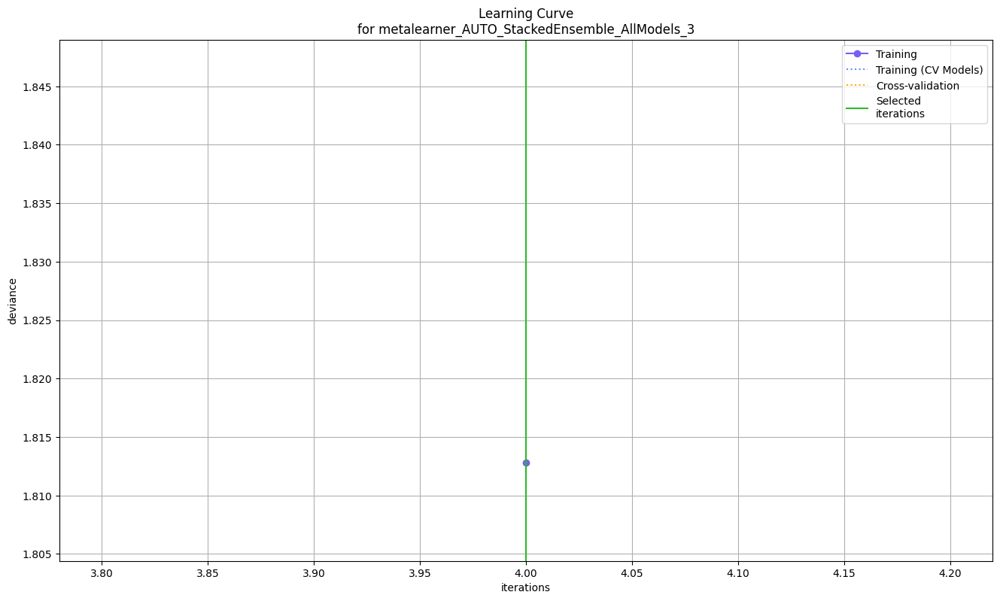

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

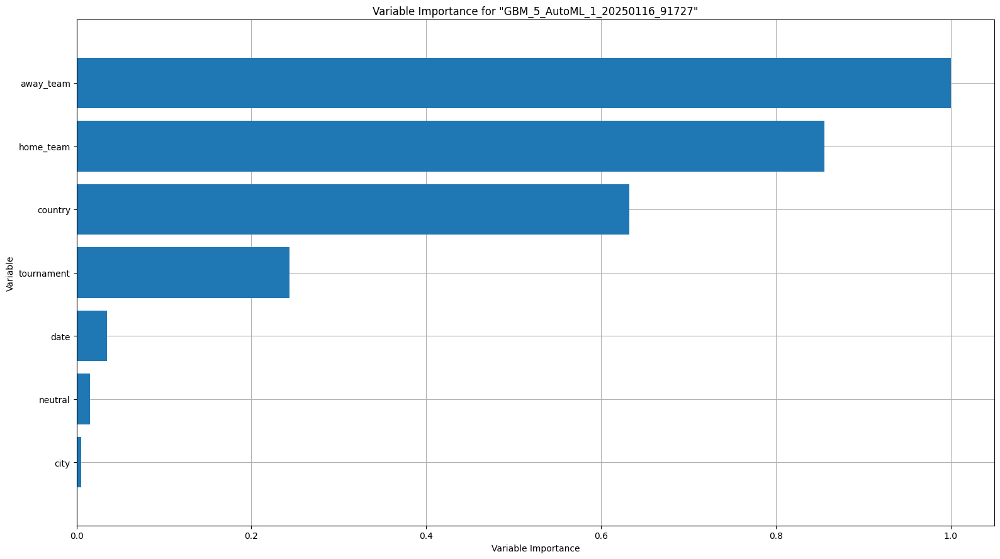

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

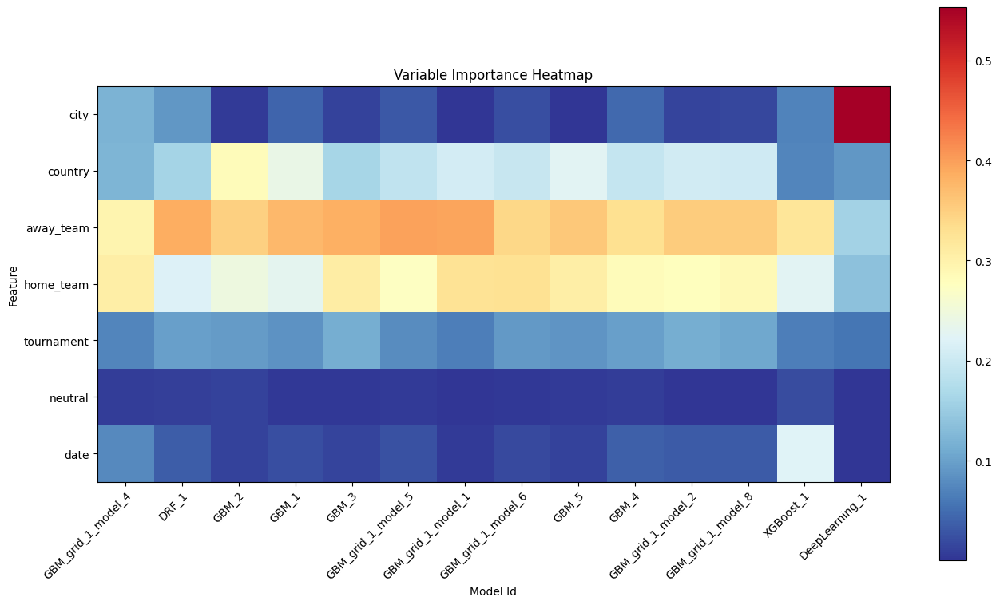

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

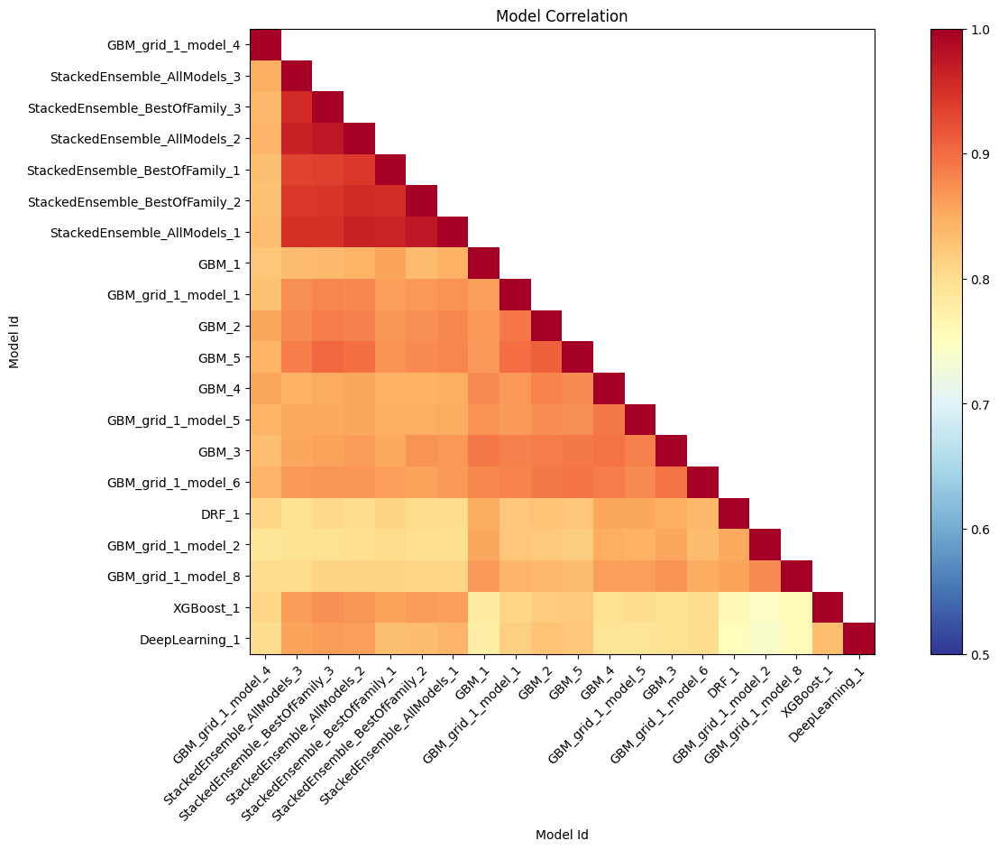

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

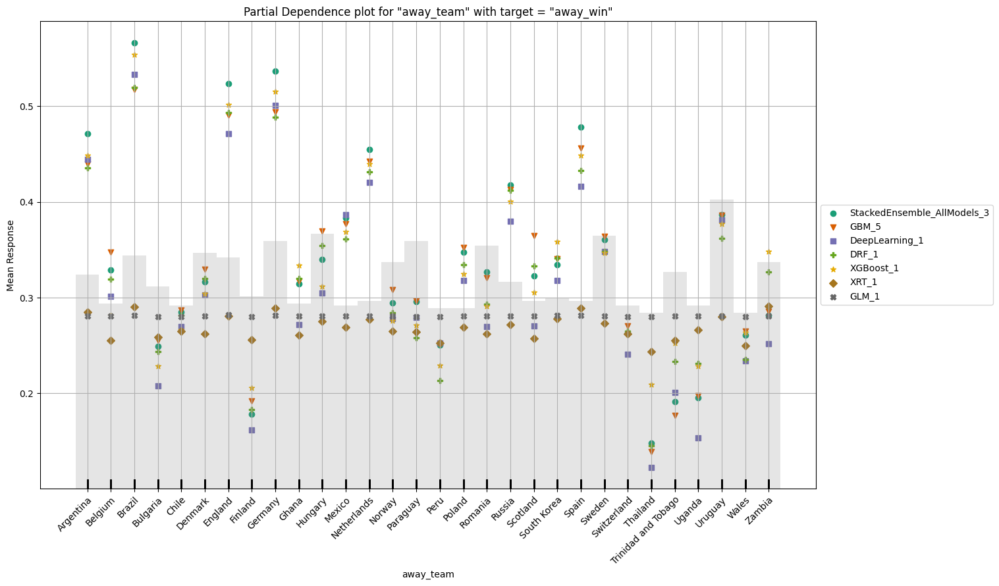

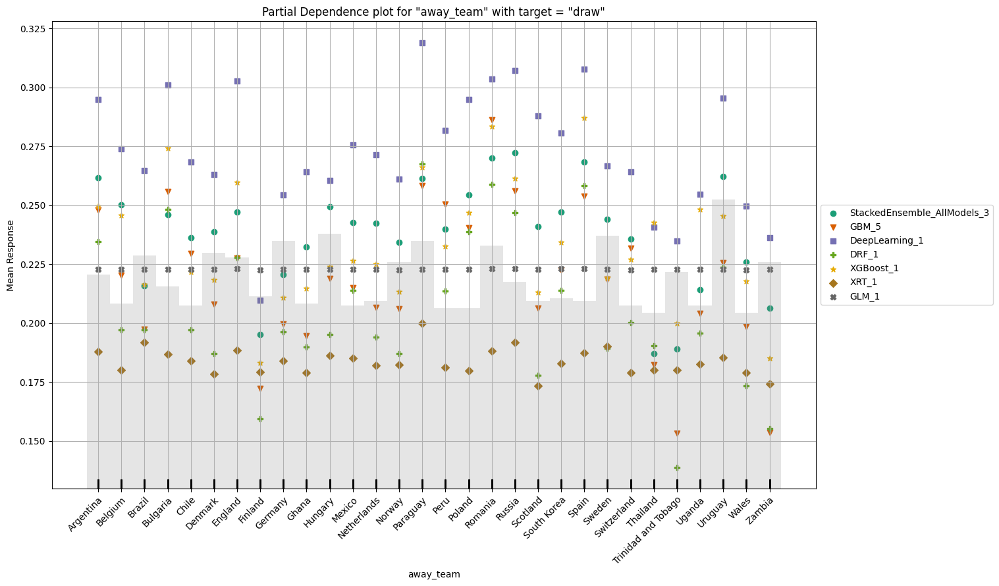

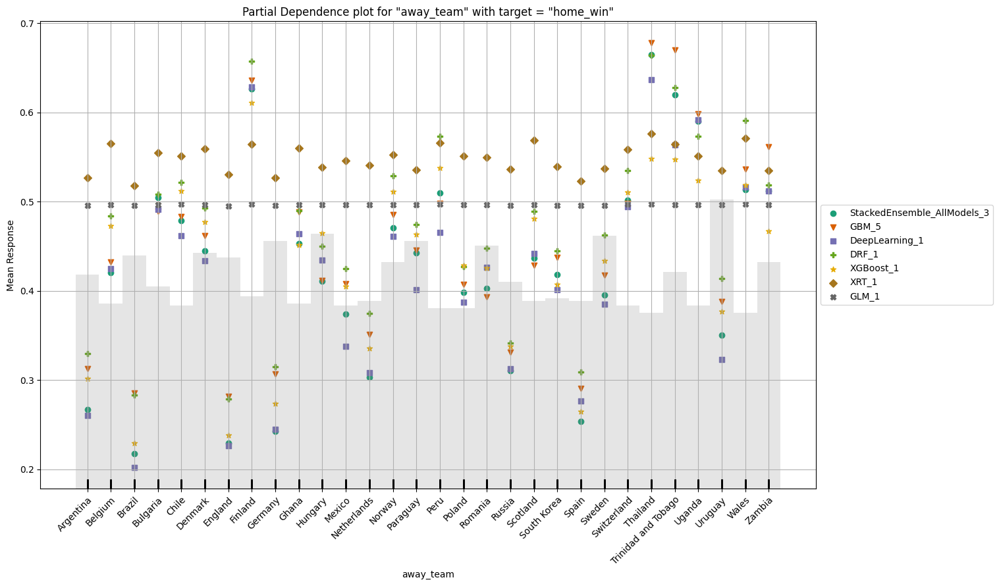

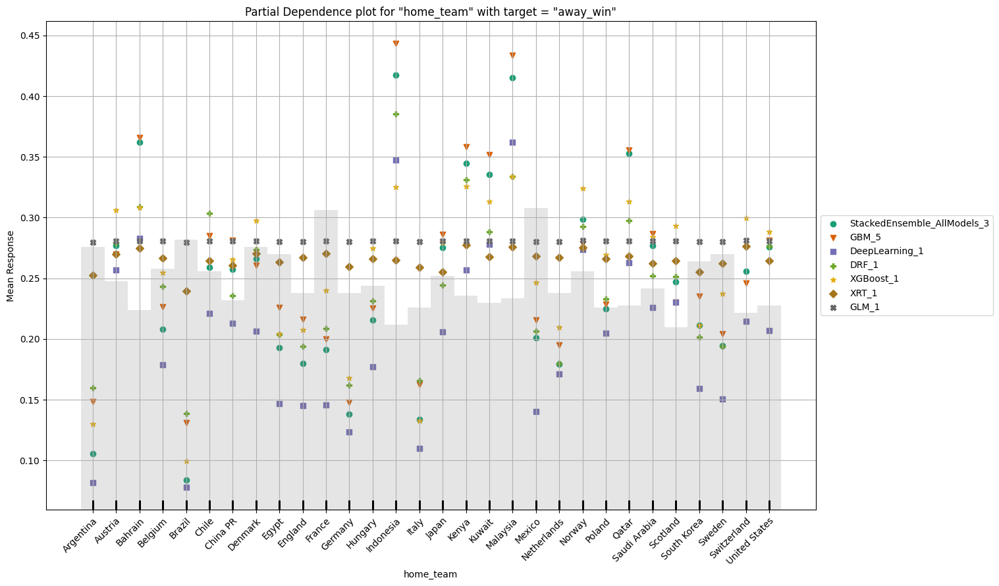

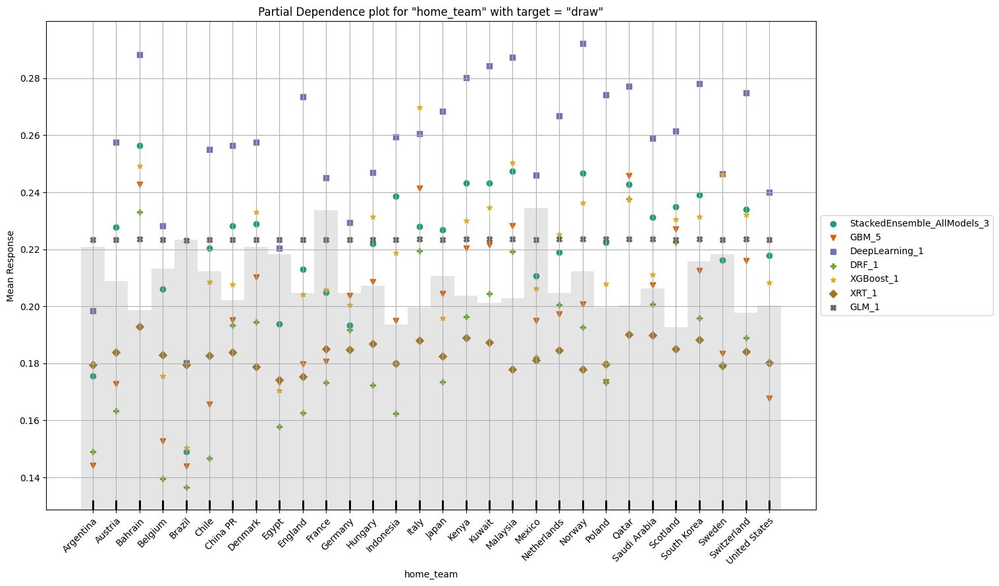

...

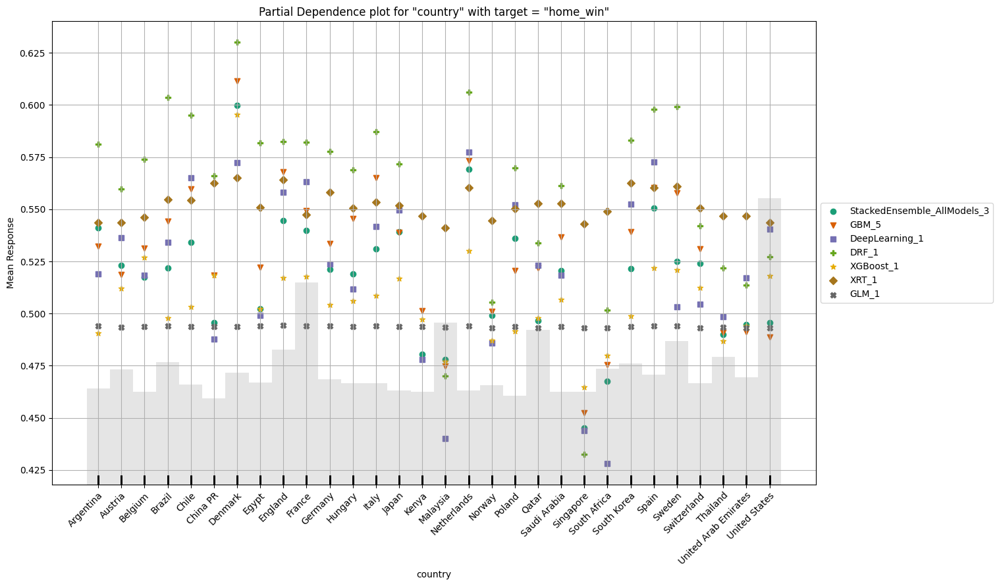

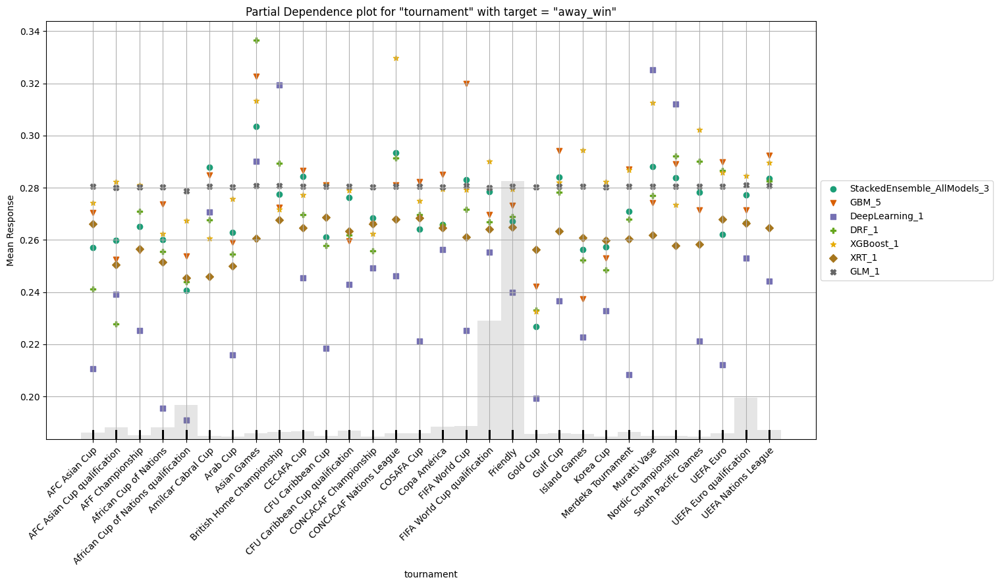

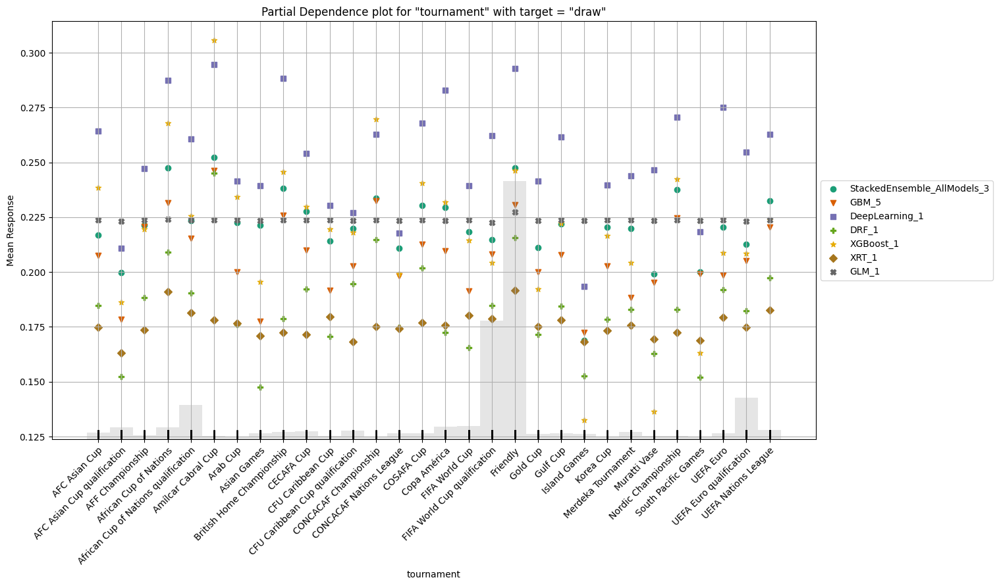

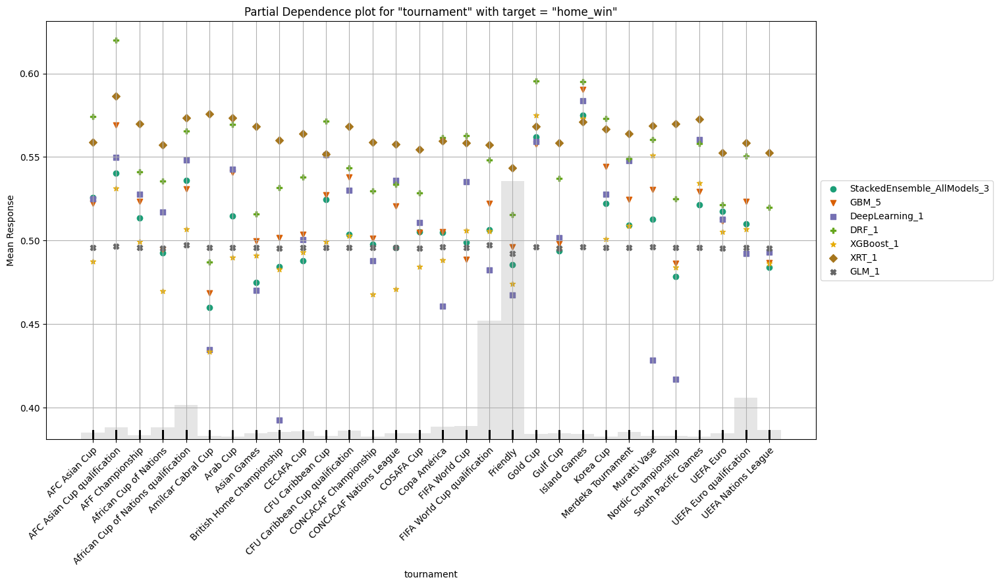

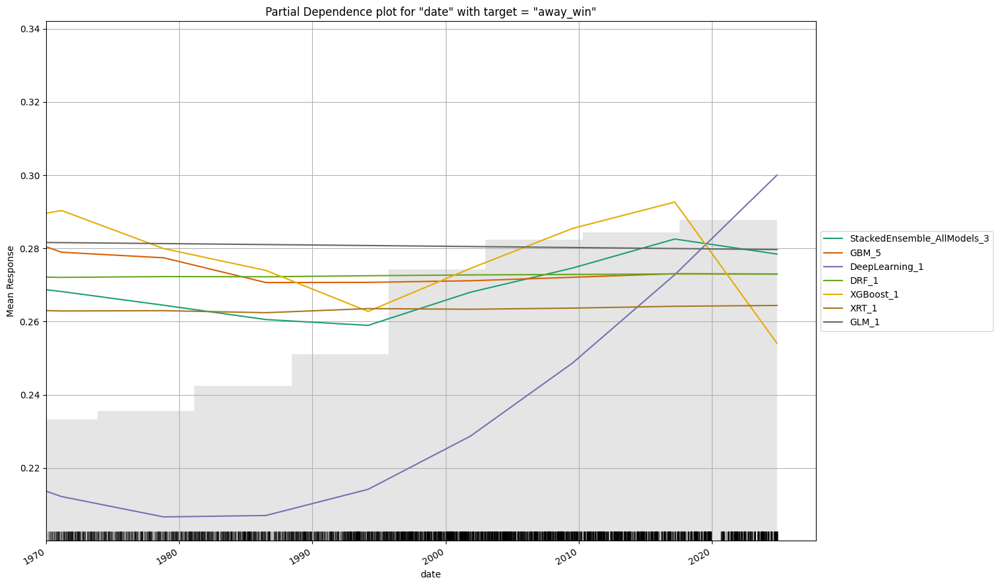

H2OJobCancelled: Job<$03017f00000132d4ffffffff$_b2bdabe6fb9303753c8eeeb6468a414f> was cancelled by the user.

<Figure size 1600x900 with 0 Axes>

In [ ]:
aml.explain(frame=test)

In [ ]:
print_metric()

stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.11/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install polars and pyarrow and use it as pandas_df = h2o_df.as_data_frame(use_multi_thread=True)

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"
/usr/local/lib/python3.11/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install polars and pyarrow and use it as pandas_df = h2o_df.as_data_frame(use_multi_thread=True)

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"
/usr/local/lib/python3.11/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install polars and pyarrow a

Accuracy: 0.5754588358678553
F1-score: 0.4986493359149962
Precision: 0.5106858481518437
Recall: 0.5754588358678553
ROC-AUC: 0.7280383928163554
Confusion Matrix:
 [[1504   28 1219]
 [ 638   24 1564]
 [ 571   28 3959]]
              precision    recall  f1-score   support

    away_win       0.55      0.55      0.55      2751
        draw       0.30      0.01      0.02      2226
    home_win       0.59      0.87      0.70      4558

    accuracy                           0.58      9535
   macro avg       0.48      0.48      0.42      9535
weighted avg       0.51      0.58      0.50      9535



## TPOT

In [ ]:
data['date'] = pd.to_datetime(data['date'])
data['year'] = data['date'].dt.year
data['month'] = data['date'].dt.month
data['day'] = data['date'].dt.day
data['dayofweek'] = data['date'].dt.dayofweek

data['date_numeric'] = data['year'] * 365 + data['month'] * 31 + data['day']
data = data.drop(columns=['date', 'year', 'month', 'day'])

In [ ]:
# Разделение на признаки и целевую переменную
target = 'result'
X = data_encoded.drop(columns=[target])
y = data_encoded[target]

In [ ]:
# Разделение на train/test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
custom_config = {
    'sklearn.preprocessing.OneHotEncoder': {
        'handle_unknown': ['ignore']
    },
    'sklearn.preprocessing.OrdinalEncoder': {
        'handle_unknown': ['use_encoded_value', -1]
    }
}

tpot_config = {**classifier_config_dict, **custom_config}
tpot_config.pop('tpot.builtins.OneHotEncoder', None)
tpot_config.pop('tpot.builtins.OrdinalEncoder', None)


{'handle_unknown': ['use_encoded_value', -1]}

In [ ]:
# Настройка TPOT
# Инициализация TPOT с расширенной конфигурацией
tpot = TPOTClassifier(
        generations=5,
        population_size=25,
        verbosity=3,
        random_state=42,
        n_jobs=-1,
        max_time_mins=60,
        config_dict=tpot_config,
        scoring='balanced_accuracy',
        cv=StratifiedKFold(n_splits=5),
        warm_start=True
    )

# Запуск обучения
tpot.fit(X_train, y_train)

33 operators have been imported by TPOT.


Optimization Progress:   0%|          | 0/25 [00:00<?, ?pipeline/s]

Skipped pipeline #4 due to time out. Continuing to the next pipeline.
Skipped pipeline #17 due to time out. Continuing to the next pipeline.
_pre_test decorator: _random_mutation_operator: num_test=0 could not convert string to float: 'Chile'.
_pre_test decorator: _random_mutation_operator: num_test=1 could not convert string to float: 'Chile'.
_pre_test decorator: _random_mutation_operator: num_test=2 could not convert string to float: 'Chile'.
_pre_test decorator: _random_mutation_operator: num_test=3 could not convert string to float: 'Chile'.
_pre_test decorator: _random_mutation_operator: num_test=4 could not convert string to float: 'Chile'.
_pre_test decorator: _random_mutation_operator: num_test=5 The 'loss' parameter of SGDClassifier must be a str among {'epsilon_insensitive', 'squared_epsilon_insensitive', 'modified_huber', 'log_loss', 'perceptron', 'huber', 'hinge', 'squared_error', 'squared_hinge'}. Got 'log' instead..
_pre_test decorator: _random_mutation_operator: num_tes

ValueError: could not convert string to float: 'Kenya'

In [ ]:
if hasattr(tpot.fitted_pipeline_, 'transform'):
    transformed_X_train = tpot.fitted_pipeline_.transform(X_train)
    print("Features после трансформации(TPOT):", transformed_X_train.shape)
if hasattr(tpot.fitted_pipeline_.steps[-1][1], 'feature_importances_'):
    importances = pipeline.steps[-1][1].feature_importances_
    feature_names = X_train.columns
    feature_importance_df = pd.DataFrame({'feature': feature_names, 'importance': importances})
    feature_importance_df = feature_importance_df.sort_values(by=['importance'], ascending=False)

    # Визуализация
    plt.figure(figsize=(10, 6))
    sns.barplot(x='importance', y='feature', data=feature_importance_df)
    plt.title('TPOT Feature Importance')
    plt.show()

In [ ]:
y_pred = tpot.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
cm = confusion_matrix(y_test, y_pred)

print(f"Accuracy: {accuracy}")
print(f"F1-score: {f1}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print("Confusion Matrix:\n", cm)
print(classification_report(y_test, y_pred))

Accuracy: 0.5311978297161937
F1-score: 0.4834468605686892
Precision: 0.48743546781853814
Recall: 0.5311978297161937
Confusion Matrix:
 [[1041  203 1446]
 [ 462  213 1509]
 [ 611  262 3837]]
              precision    recall  f1-score   support

    away_win       0.49      0.39      0.43      2690
        draw       0.31      0.10      0.15      2184
    home_win       0.56      0.81      0.67      4710

    accuracy                           0.53      9584
   macro avg       0.46      0.43      0.42      9584
weighted avg       0.49      0.53      0.48      9584



## AutoGluon

In [ ]:
data.head()

,date,home_team,away_team,tournament,city,country,neutral,result
0,1872-11-30,Scotland,England,Friendly,Glasgow,Scotland,False,draw
1,1873-03-08,England,Scotland,Friendly,London,England,False,home_win
2,1874-03-07,Scotland,England,Friendly,Glasgow,Scotland,False,home_win
3,1875-03-06,England,Scotland,Friendly,London,England,False,draw
4,1876-03-04,Scotland,England,Friendly,Glasgow,Scotland,False,home_win


In [ ]:
target = 'result'
features = data.drop(columns=['result'])
data.dropna(subset=[target], inplace=True)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(
    features, data[target], test_size=0.2, random_state=42)

In [ ]:
# Объединяем X и y для AutoGluon (он требует один датафрейм)
train_data = pd.concat([X_train, y_train.reset_index(drop=True)], axis=1)
test_data = pd.concat([X_test, y_test.reset_index(drop=True)], axis=1)

In [ ]:
# Инициализируем AutoGluon
predictor = TabularPredictor(label=target, problem_type='multiclass', eval_metric='f1_weighted')

No path specified. Models will be saved in: "AutogluonModels/ag-20250113_201329"


In [ ]:
train_data.dropna(subset=[target], inplace=True)
test_data.dropna(subset=[target], inplace=True)

In [ ]:
predictor.fit(
    train_data=train_data,
    time_limit=3600,  # Время выполнения (1 час)
    presets='good_quality_faster_inference_only_refit'  # Акцент на качество
)

Preset alias specified: 'good_quality_faster_inference_only_refit' maps to 'good_quality'.
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.2
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       4.54 GB / 12.67 GB (35.8%)
Disk Space Avail:   70.77 GB / 107.72 GB (65.7%)
Presets specified: ['good_quality_faster_inference_only_refit']
Setting dynamic_stacking from 'auto' to True. Reason: Enable dynamic_stacking when use_bag_holdout is disabled. (use_bag_holdout=False)
Stack configuration (auto_stack=True): num_stack_levels=1, num_bag_folds=8, num_bag_sets=1
Note: `save_bag_folds=False`! This will greatly reduce peak disk usage during fit (by ~8x), but runs the risk of an out-of-memory error during model refit if memory is small relative to the data size.
	You can avoid this risk by setting `s

In [ ]:
# Оценка на тестовом наборе
performance = predictor.evaluate(test_data)
print(performance)

{'f1_weighted': 0.3498524033598951, 'accuracy': 0.47234974958263776, 'balanced_accuracy': 0.33288996689595746, 'mcc': -0.0026785541570425275}


In [ ]:
# Важность признаков
feature_importances = predictor.feature_importance(test_data)
print("Feature Importances:\n", feature_importances)

Computing feature importance via permutation shuffling for 7 features using 5000 rows with 5 shuffle sets...
	941.68s	= Expected runtime (188.34s per shuffle set)
	664.23s	= Actual runtime (Completed 5 of 5 shuffle sets)


Feature Importances:
             importance    stddev   p_value  n  p99_high   p99_low
date          0.000294  0.001163  0.301251  5  0.002688 -0.002101
home_team     0.000150  0.001006  0.377731  5  0.002221 -0.001921
tournament    0.000105  0.000671  0.372027  5  0.001487 -0.001277
away_team    -0.000268  0.001524  0.643055  5  0.002870 -0.003406
country      -0.000346  0.000662  0.846475  5  0.001017 -0.001710
neutral      -0.000438  0.000463  0.948890  5  0.000516 -0.001391
city         -0.000628  0.001016  0.880503  5  0.001464 -0.002721


In [ ]:
predictor.leaderboard(test_data, extra_info=True)

,model,score_test,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,...,hyperparameters,hyperparameters_fit,ag_args_fit,features,compile_time,child_hyperparameters,child_hyperparameters_fit,child_ag_args_fit,ancestors,descendants
0,NeuralNetFastAI_BAG_L2_FULL,0.350643,NaN,f1_weighted,23.133176,NaN,233.195392,0.266715,NaN,50.992782,...,"{'use_orig_features': True, 'valid_stacker': True, 'max_base_models': 0, 'max_base_models_per_type': 'auto', 'save_bag_folds': True}",{},"{'max_memory_usage_ratio': 1.15, 'max_time_limit_ratio': 1.0, 'max_time_limit': None, 'min_time_limit': 0, 'valid_raw_types': None, 'valid_special_types': None, 'ignored_type_group_special': None, 'ignored_type_group_raw': None, 'get_features_kwargs': None, 'get_features_kwargs_extra': None, 'predict_1_batch_size': None, 'temperature_scalar': None, 'drop_unique': False}","[RandomForestGini_BAG_L1_2, date.month, date, LightGBMXT_BAG_L1_1, date.year, CatBoost_BAG_L1_2, LightGBM_BAG_L1_2, ExtraTreesEntr_BAG_L1_0, LightGBMXT_BAG_L1_0, RandomForestEntr_BAG_L1_1, XGBoost_BAG_L1_1, NeuralNetFastAI_BAG_L1_0, CatBoost_BAG_L1_1, ExtraTreesEntr_BAG_L1_2, NeuralNetFastAI_BAG_L1_2, RandomForestEntr_BAG_L1_0, XGBoost_BAG_L1_0, ExtraTreesGini_BAG_L1_1, ExtraTreesEntr_BAG_L1_1, XGBoost_BAG_L1_2, NeuralNetFastAI_BAG_L1_1, LightGBM_BAG_L1_0, tournament, RandomForestGini_BAG_L1_1, ExtraTreesGini_BAG_L1_0, neutral, away_team, date.day, city, date.dayofweek, LightGBM_BAG_L1_1, ...",None,"{'layers': None, 'emb_drop': 0.1, 'ps': 0.1, 'bs': 'auto', 'lr': 0.01, 'epochs': 25, 'early.stopping.min_delta': 0.0001, 'early.stopping.patience': 20, 'smoothing': 0.0, 'best_epoch': 18}","{'epochs': 25, 'best_epoch': 18}","{'max_memory_usage_ratio': 1.0, 'max_time_limit_ratio': 1.0, 'max_time_limit': None, 'min_time_limit': 0, 'valid_raw_types': ['bool', 'int', 'float', 'category'], 'valid_special_types': None, 'ignored_type_group_special': ['text_ngram', 'text_as_category'], 'ignored_type_group_raw': None, 'get_features_kwargs': None, 'get_features_kwargs_extra': None, 'predict_1_batch_size': None, 'temperature_scalar': None}","[CatBoost_BAG_L1_FULL, RandomForestEntr_BAG_L1_FULL, NeuralNetFastAI_BAG_L1_FULL, LightGBM_BAG_L1_FULL, RandomForestGini_BAG_L1_FULL, LightGBMXT_BAG_L1_FULL, ExtraTreesEntr_BAG_L1_FULL, ExtraTreesGini_BAG_L1_FULL, XGBoost_BAG_L1_FULL]",[WeightedEnsemble_L3_FULL]
1,WeightedEnsemble_L3_FULL,0.349852,NaN,f1_weighted,26.900355,NaN,268.791338,0.003937,NaN,6.752923,...,"{'use_orig_features': False, 'valid_stacker': True, 'max_base_models': 0, 'max_base_models_per_type': 'auto', 'save_bag_folds': True}",{},"{'max_memory_usage_ratio': 1.0, 'max_time_limit_ratio': 1.0, 'max_time_limit': None, 'min_time_limit': 0, 'valid_raw_types': None, 'valid_special_types': None, 'ignored_type_group_special': None, 'ignored_type_group_raw': None, 'get_features_kwargs': None, 'get_features_kwargs_extra': None, 'predict_1_batch_size': None, 'temperature_scalar': None, 'drop_unique': False}","[LightGBMXT_BAG_L2_0, XGBoost_BAG_L1_0, NeuralNetFastAI_BAG_L2_0, LightGBMXT_BAG_L2_2, XGBoost_BAG_L1_2, XGBoost_BAG_L1_1, NeuralNetFastAI_BAG_L2_1, LightGBMXT_BAG_L2_1, NeuralNetFastAI_BAG_L2_2]",None,"{'ensemble_size': 25, 'subsample_size': 1000000}",{'ensemble_size': 15},"{'max_memory_usage_ratio': 1.0, 'max_time_limit_ratio': 1.0, 'max_time_limit': None, 'min_time_limit': 0, 'valid_raw_types': None, 'valid_special_types': None, 'ignored_type_group_special': None, 'ignored_type_group_raw': None, 'get_features_kwargs': None, 'get_features_kwargs_extra': None, 'predict_1_batch_size': None, 'temperature_scalar': None, 'drop_unique': False}","[CatBoost_BAG_L1_FULL, NeuralNetFastAI_BAG_L1_FULL, RandomForestEntr_BAG_L1_FULL, LightGBM_BAG_L1_FULL, RandomForestGini_BAG_L1_FULL, LightGBMXT_BAG_L2_FULL, LightGBMXT_BAG_L1_FULL, ExtraTreesEntr_BAG_L1_FULL, NeuralNetFastAI_BAG_L2_FULL, ExtraTreesGini_BAG_L1_FULL, XGBoost_BAG_L1_FULL]",[]
2,Ligh

In [ ]:
original_features = [f for f in leaderboard['features'].iloc[3] if re.match(r'^[a-zA-Z0-9_.]+$', f)]
print(original_features)


['date.day', 'city', 'date.dayofweek', 'date.month', 'date', 'home_team', 'tournament', 'country', 'date.year', 'neutral', 'away_team']


In [ ]:
original_features = [f for f in leaderboard['features'].iloc[6] if re.match(r'^[a-zA-Z0-9_.]+$', f)]
print(original_features)

['RandomForestGini_BAG_L1_2', 'date.month', 'date', 'LightGBMXT_BAG_L1_1', 'date.year', 'CatBoost_BAG_L1_2', 'LightGBM_BAG_L1_2', 'ExtraTreesEntr_BAG_L1_0', 'LightGBMXT_BAG_L1_0', 'RandomForestEntr_BAG_L1_1', 'XGBoost_BAG_L1_1', 'NeuralNetFastAI_BAG_L1_0', 'CatBoost_BAG_L1_1', 'ExtraTreesEntr_BAG_L1_2', 'NeuralNetFastAI_BAG_L1_2', 'RandomForestEntr_BAG_L1_0', 'XGBoost_BAG_L1_0', 'ExtraTreesGini_BAG_L1_1', 'ExtraTreesEntr_BAG_L1_1', 'XGBoost_BAG_L1_2', 'NeuralNetFastAI_BAG_L1_1', 'LightGBM_BAG_L1_0', 'tournament', 'RandomForestGini_BAG_L1_1', 'ExtraTreesGini_BAG_L1_0', 'neutral', 'away_team', 'date.day', 'city', 'date.dayofweek', 'LightGBM_BAG_L1_1', 'home_team', 'ExtraTreesGini_BAG_L1_2', 'country', 'RandomForestEntr_BAG_L1_2', 'CatBoost_BAG_L1_0', 'RandomForestGini_BAG_L1_0', 'LightGBMXT_BAG_L1_2']


In [ ]:
features_list = leaderboard['features'].iloc[2]  # Получаем список признаков из первой строки (лучшей модели)
print(features_list)

['date.day', 'city', 'date.dayofweek', 'date.month', 'date', 'home_team', 'tournament', 'country', 'date.year', 'neutral', 'away_team']


In [ ]:
features_list = ['RandomForestGini_BAG_L1_2', 'date.month', 'date', 'LightGBMXT_BAG_L1_1', 'date.year', 'CatBoost_BAG_L1_2', 'LightGBM_BAG_L1_2', 'ExtraTreesEntr_BAG_L1_0', 'LightGBMXT_BAG_L1_0', 'RandomForestEntr_BAG_L1_1', 'XGBoost_BAG_L1_1', 'NeuralNetFastAI_BAG_L1_0', 'CatBoost_BAG_L1_1', 'ExtraTreesEntr_BAG_L1_2', 'NeuralNetFastAI_BAG_L1_2', 'RandomForestEntr_BAG_L1_0', 'XGBoost_BAG_L1_0', 'ExtraTreesGini_BAG_L1_1', 'ExtraTreesEntr_BAG_L1_1', 'XGBoost_BAG_L1_2', 'NeuralNetFastAI_BAG_L1_1', 'LightGBM_BAG_L1_0', 'tournament', 'RandomForestGini_BAG_L1_1', 'ExtraTreesGini_BAG_L1_0', 'neutral', 'away_team', 'date.day', 'city', 'date.dayofweek', 'LightGBM_BAG_L1_1', 'home_team', 'ExtraTreesGini_BAG_L1_2', 'country', 'RandomForestEntr_BAG_L1_2', 'CatBoost_BAG_L1_0', 'RandomForestGini_BAG_L1_0', 'LightGBMXT_BAG_L1_2']

original_features = [f for f in leaderboard['features'].iloc[11] if re.match(r'^[a-zA-Z0-9_.]+$', f) and not f.startswith(('LightGBM', 'CatBoost', 'RandomForest', 'ExtraTrees', 'XGBoost', 'NeuralNetFastAI'))]

print(original_features)

['date.day', 'city', 'date.dayofweek', 'date.month', 'date', 'home_team', 'tournament', 'country', 'date.year', 'neutral', 'away_team']


In [ ]:
y_pred = predictor.predict(test_data)
y_pred_proba = predictor.predict_proba(test_data)

In [ ]:
best_model = predictor.model_best
print(best_model)
print(predictor.info())

WeightedEnsemble_L3_FULL
{'path': '/content/AutogluonModels/ag-20250113_201329', 'label': 'result', 'random_state': 0, 'version': '1.2', 'features': ['date', 'home_team', 'away_team', 'tournament', 'city', 'country', 'neutral'], 'feature_metadata_in': <autogluon.common.features.feature_metadata.FeatureMetadata object at 0x7a19c9a395d0>, 'time_fit_preprocessing': 0.7350935935974121, 'time_fit_training': 2581.9029347896576, 'time_fit_total': 2582.638028383255, 'time_limit': 2549.181474685669, 'time_train_start': 1736800264.4406075, 'num_rows_train': 38333, 'num_cols_train': 11, 'num_rows_val': None, 'num_rows_test': None, 'num_classes': 3, 'problem_type': 'multiclass', 'eval_metric': 'f1_weighted', 'best_model': 'WeightedEnsemble_L3_FULL', 'best_model_score_val': None, 'best_model_stack_level': 3, 'num_models_trained': 28, 'num_bag_folds': 8, 'max_stack_level': 3, 'max_core_stack_level': 2, 'model_info': {'NeuralNetFastAI_BAG_L1': {'name': 'NeuralNetFastAI_BAG_L1', 'model_type': 'Stacker

In [ ]:
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')  # Или 'macro', 'micro'
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
roc_auc = roc_auc_score(y_test, y_pred_proba, multi_class='ovr', average='weighted')

print(f"Accuracy: {accuracy}")
print(f"F1-score: {f1}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"ROC-AUC: {roc_auc}")
print(classification_report(y_test, y_pred))

Accuracy: 0.47036727879799667
F1-score: 0.346426077064979
Precision: 0.3603582100907973
Recall: 0.47036727879799667
ROC-AUC: 0.4973478529238905
              precision    recall  f1-score   support

    away_win       0.26      0.04      0.07      2690
        draw       0.21      0.03      0.05      2184
    home_win       0.49      0.92      0.64      4710

    accuracy                           0.47      9584
   macro avg       0.32      0.33      0.25      9584
weighted avg       0.36      0.47      0.35      9584



## Простая модель

In [ ]:
data.head()

,home_team,away_team,tournament,city,country,neutral,result,dayofweek,date_numeric
0,Scotland,England,Friendly,Glasgow,Scotland,False,draw,5,683651
1,England,Scotland,Friendly,London,England,False,home_win,5,683746
2,Scotland,England,Friendly,Glasgow,Scotland,False,home_win,5,684110
3,England,Scotland,Friendly,London,England,False,draw,5,684474
4,Scotland,England,Friendly,Glasgow,Scotland,False,home_win,5,684837


In [ ]:
data = pd.read_csv('/content/Experiment_1.csv')

# Обработка даты
data['date'] = pd.to_datetime(data['date'])
data['year'] = data['date'].dt.year
data['month'] = data['date'].dt.month
data['day'] = data['date'].dt.day
data['dayofweek'] = data['date'].dt.dayofweek

data['date_numeric'] = data['year'] * 365 + data['month'] * 31 + data['day']
data = data.drop(columns=['date', 'year', 'month', 'day'])

# Задаем список категориальных признаков
categorical_features = ['home_team', 'away_team', 'tournament', 'city', 'country', 'dayofweek']

# Приводим категориальные признаки к типу category
for col in categorical_features:
    data[col] = data[col].astype('category')

# Переименование столбцов для удаления недопустимых символов
data = data.rename(columns=lambda x: re.sub('[^A-Za-z0-9_]+', '', x))

# Обновляем список категориальных признаков после переименования
categorical_features = [re.sub('[^A-Za-z0-9_]+', '', col) for col in categorical_features]

# Кодирование целевой переменной (меток)
label_encoder = LabelEncoder()
data['result'] = label_encoder.fit_transform(data['result'])
# После кодирования, например, классы будут представлены как 0, 1, 2,
# а исходное соотношение можно восстановить через label_encoder.classes_

# Разделение данных на обучающую и тестовую выборки
X = data.drop('result', axis=1)
y = data['result']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Если модель не поддерживает категориальные признаки напрямую, преобразуем их в числовые коды
def prepare_data_for_numeric(df, cat_cols):
    df_numeric = df.copy()
    for col in cat_cols:
        # Преобразуем категорию в числовые коды, если тип колонки 'category'
        if pd.api.types.is_categorical_dtype(df_numeric[col]):
            df_numeric[col] = df_numeric[col].cat.codes
        else:
            df_numeric[col] = df_numeric[col].astype('category').cat.codes
    return df_numeric

# Готовим данные для моделей, не умеющих обрабатывать категориальные переменные напрямую
X_train_numeric = prepare_data_for_numeric(X_train, categorical_features)
X_test_numeric = prepare_data_for_numeric(X_test, categorical_features)

# Создаем копии исходных данных для моделей, поддерживающих категориальные признаки (CatBoost, XGBoost)
X_train_cat = X_train.copy()
X_test_cat = X_test.copy()
# Обеспечиваем корректный тип данных для категориальных признаков
for col in categorical_features:
    X_train_cat[col] = X_train_cat[col].astype('category')
    X_test_cat[col] = X_test_cat[col].astype('category')

# Словарь моделей. Для моделей, поддерживающих категориальные признаки, используем исходные данные.
models = {
    'RandomForest': RandomForestClassifier(),
    'XGBoost': XGBClassifier(enable_categorical=True, use_label_encoder=False, eval_metric='mlogloss'),
    'LightGBM': LGBMClassifier(),
    'CatBoost': CatBoostClassifier(cat_features=categorical_features, verbose=0)
}

for model_name, model in models.items():
    print(f"\n{'='*40}\nОбучение модели: {model_name}")
    # Для CatBoost и XGBoost используем набор с категориальными признаками
    if model_name in ['CatBoost', 'XGBoost']:
        X_train_used = X_train_cat
        X_test_used = X_test_cat
    else:
        X_train_used = X_train_numeric
        X_test_used = X_test_numeric

    # Обучение модели
    model.fit(X_train_used, y_train)
    y_pred = model.predict(X_test_used)

    # Вычисление метрик
    accuracy = accuracy_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred, average='weighted')
    precision = precision_score(y_test, y_pred, average='weighted')
    recall = recall_score(y_test, y_pred, average='weighted')

    # Вычисление ROC-AUC (если возможно)
    try:
        y_pred_proba = model.predict_proba(X_test_used)
        roc_auc = roc_auc_score(y_test, y_pred_proba, multi_class='ovr', average='weighted')
    except Exception as e:
        roc_auc = "N/A"

    # Вывод результатов
    print(f"Accuracy: {accuracy:.4f}")
    print(f"F1-score: {f1:.4f}")
    print(f"Precision: {precision:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"ROC-AUC: {roc_auc if isinstance(roc_auc, str) else round(roc_auc,4)}")
    print("\nClassification Report:")
    # При желании можно добавить параметр target_names=label_encoder.classes_.tolist()
    print(classification_report(y_test, y_pred, target_names=label_encoder.classes_.tolist()))

<ipython-input-119-e19a6dacf951>:42: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(df_numeric[col]):



Обучение модели: RandomForest
Accuracy: 0.5037
F1-score: 0.4720
Precision: 0.4652
Recall: 0.5037
ROC-AUC: 0.6266

Classification Report:
              precision    recall  f1-score   support

    away_win       0.45      0.37      0.41      2690
        draw       0.27      0.14      0.18      2184
    home_win       0.56      0.75      0.64      4710

    accuracy                           0.50      9584
   macro avg       0.43      0.42      0.41      9584
weighted avg       0.47      0.50      0.47      9584


Обучение модели: XGBoost


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [19:41:12] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


Accuracy: 0.5426
F1-score: 0.5235
Precision: 0.5135
Recall: 0.5426
ROC-AUC: 0.7002

Classification Report:
              precision    recall  f1-score   support

    away_win       0.51      0.50      0.50      2690
        draw       0.27      0.18      0.21      2184
    home_win       0.63      0.74      0.68      4710

    accuracy                           0.54      9584
   macro avg       0.47      0.47      0.47      9584
weighted avg       0.51      0.54      0.52      9584


Обучение модели: LightGBM
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000960 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1333
[LightGBM] [Info] Number of data points in the train set: 38333, number of used features: 8
[LightGBM] [Info] Start training from score -1.262976
[LightGBM] [Info] Start training from score -1.480921
[LightGBM] [Info] Start t

# Эксперимент 2

In [ ]:
data = pd.read_csv('/content/Experiment_2.csv')

## H2O

In [ ]:
metrics_data = []

def print_metric():
  y_pred = aml.leader.predict(test)
  y_pred_df = y_pred.as_data_frame()['predict']

  y_test_df = test['result'].as_data_frame()['result']

  # Convert both y_test_df and y_pred_df to a common data type, e.g., string
  y_test_df = y_test_df.astype(str)
  y_pred_df = y_pred_df.astype(str)

  accuracy = accuracy_score(y_test_df, y_pred_df)
  f1 = f1_score(y_test_df, y_pred_df, average='weighted')
  precision = precision_score(y_test_df, y_pred_df, average='weighted')
  recall = recall_score(y_test_df, y_pred_df, average='weighted')

  # Convert y_pred to numpy array for roc_auc_score
  y_pred_proba = y_pred.as_data_frame()[y_pred.as_data_frame().columns[1:]].to_numpy()
  roc_auc = roc_auc_score(y_test_df, y_pred_proba, multi_class='ovr', average='weighted')

  cm = confusion_matrix(y_test_df, y_pred_df)


  print(f"Accuracy: {accuracy}")
  print(f"F1-score: {f1}")
  print(f"Precision: {precision}")
  print(f"Recall: {recall}")
  print(f"ROC-AUC: {roc_auc}")
  print("Confusion Matrix:\n", cm)
  print(classification_report(y_test_df, y_pred_df))

  metrics_data.append({
           'accuracy': accuracy,
           'f1_score': f1,
           'precision': precision,
           'recall': recall,
           'roc_auc': roc_auc,
           'confusion matrix:': cm})

In [ ]:
h2o.init()
h2o_df = h2o.import_file('Experiment_2.csv')
target = 'result'
features = [col for col in h2o_df.columns if col != target]
train, test = h2o_df.split_frame(ratios=[0.8], seed=42)

Checking whether there is an H2O instance running at http://localhost:54321. connected.


H2O_cluster_uptime:,1 hour 47 mins
H2O_cluster_timezone:,Etc/UTC
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.46.0.6
H2O_cluster_version_age:,2 months and 11 days
H2O_cluster_name:,H2O_from_python_unknownUser_glczhz
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,1.721 Gb
H2O_cluster_total_cores:,2
H2O_cluster_allowed_cores:,2
H2O_cluster_status:,"locked, healthy"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


In [ ]:
aml = H2OAutoML(max_runtime_secs=3600, seed=42, project_name=f"feature_inj_2", balance_classes=True)
aml.train(x=features, y=target, training_frame=train)


AutoML progress: |
22:41:00.849: _train param, Dropping bad and constant columns: [city_Mikkeli, city_Masan, city_Szolnok, city_Le Petit-Quevilly, city_Danlí, city_Paradise, city_Tríkala, city_Zapopan, city_Agilat, city_Sandur, city_Tenero-Contra, city_Selayang, city_Fuladshahr, home_team_Seborga, city_Sleman, city_Bejaia, city_Bakıxanov, city_Breda, city_Pégeia, city_Matsumoto, city_Neiva, city_Bourj Hammoud, city_Umm al-Fahm, country_Bohemia and Moravia, city_Ciudad Madero, city_Shrewsbury, city_Gangtok, city_Jerez, city_Urziceni, city_Grodzisk Wielkopolski, city_Lorca, city_Niger, away_team_Hmong, city_Crawley, city_Nakagusuku, city_Mmabatho, city_Hagätña, city_Maisons-Alfort, city_Montrouge, city_Nova Gorica, city_Alzira, city_Sedan, city_Winterthur, away_team_Ticino, city_Latacunga, city_Kerkrade, away_team_Barawa, city_Rohrbach an der Lafnitz, city_Ruse, city_Bastia Umbra, city_Bedfont, city_Castletown, city_College Station, city_Cornellà de Llobregat, city_Remscheid, city_Caragl

key,value
Stacking strategy,blending
Number of base models (used / total),8/8
# GBM base models (used / total),4/4
# XGBoost base models (used / total),2/2
# DRF base models (used / total),1/1
# GLM base models (used / total),1/1
Metalearner algorithm,GLM
Metalearner fold assignment scheme,AUTO
Metalearner nfolds,0
Metalearner fold_column,None


TypeError: '<' not supported between instances of 'float' and 'str'

In [ ]:
aml.leaderboard

model_id,mean_per_class_error,logloss,rmse,mse
StackedEnsemble_AllModels_1_AutoML_18_20250113_224052,0.569078,0.958627,0.602805,0.363374
StackedEnsemble_AllModels_2_AutoML_18_20250113_224052,0.569826,0.958309,0.602633,0.363167
StackedEnsemble_BestOfFamily_1_AutoML_18_20250113_224052,0.571801,0.963581,0.604447,0.365356
StackedEnsemble_BestOfFamily_2_AutoML_18_20250113_224052,0.573804,0.961916,0.604007,0.364824
StackedEnsemble_BestOfFamily_3_AutoML_18_20250113_224052,0.573804,0.961928,0.603999,0.364815
XGBoost_1_AutoML_18_20250113_224052,0.586204,0.978879,0.611218,0.373588
GBM_1_AutoML_18_20250113_224052,0.593918,0.985608,0.61363,0.376542
XGBoost_2_AutoML_18_20250113_224052,0.627672,1.01559,0.62941,0.396157
XGBoost_grid_1_AutoML_18_20250113_224052_model_1,0.632388,1.06624,0.654885,0.428874
GBM_2_AutoML_18_20250113_224052,0.634341,1.0062,0.624126,0.389533


# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,mean_per_class_error,logloss,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
StackedEnsemble_AllModels_2_AutoML_18_20250113_224052,0.570739,0.966302,0.605328,0.366422,29841,0.881234,StackedEnsemble
StackedEnsemble_AllModels_1_AutoML_18_20250113_224052,0.571421,0.967151,0.605693,0.366864,23038,0.958749,StackedEnsemble
StackedEnsemble_BestOfFamily_3_AutoML_18_20250113_224052,0.573582,0.967981,0.606194,0.367472,19086,0.390787,StackedEnsemble
StackedEnsemble_BestOfFamily_2_AutoML_18_20250113_224052,0.573659,0.967991,0.606204,0.367483,15747,0.345325,StackedEnsemble
StackedEnsemble_BestOfFamily_1_AutoML_18_20250113_224052,0.574166,0.969042,0.606536,0.367885,17509,0.477642,StackedEnsemble
XGBoost_1_AutoML_18_20250113_224052,0.589983,0.982511,0.612542,0.375208,1.06488e+06,0.025207,XGBoost
GBM_1_AutoML_18_20250113_224052,0.601487,0.992767,0.616185,0.379684,950466,0.130057,GBM
XGBoost_2_AutoML_18_20250113_224052,0.631616,1.01831,0.630337,0.397325,220041,0.047089,XGBoost
GBM_4_AutoML_18_20250113_224052,0.633858,1.0124,0.626017,0.391897,252388,0.07772,GBM
XGBoost_grid_1_AutoML_18_20250113_224052_model_1,0.634192,1.06719,0.655181,0.429262,45046,0.012722,XGBoost


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## StackedEnsemble_AllModels_1_AutoML_18_20250113_224052

away_win,draw,home_win,Error,Rate
1091.0,24.0,1636.0,0.6034169,"1,660 / 2,751"
502.0,16.0,1708.0,0.9928122,"2,210 / 2,226"
504.0,34.0,4020.0,0.1180342,"538 / 4,558"
2097.0,74.0,7364.0,0.4622968,"4,408 / 9,535"


# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

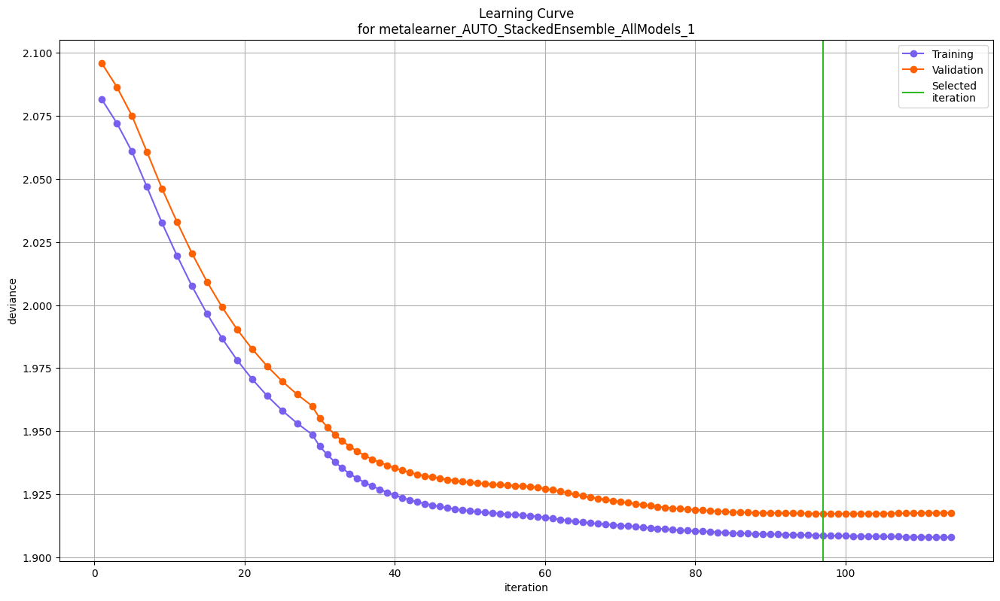

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

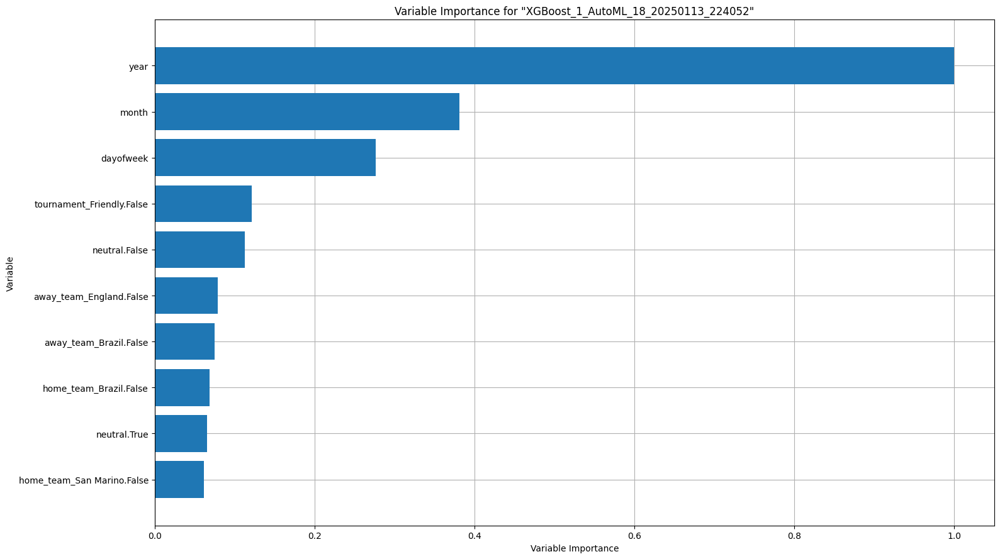

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

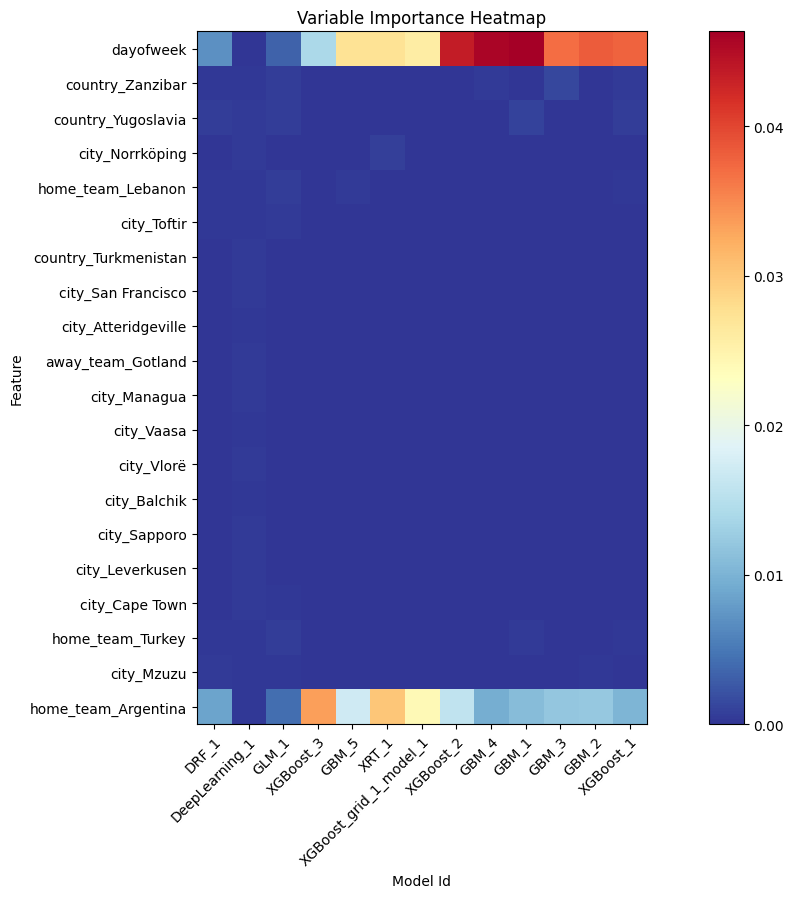

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

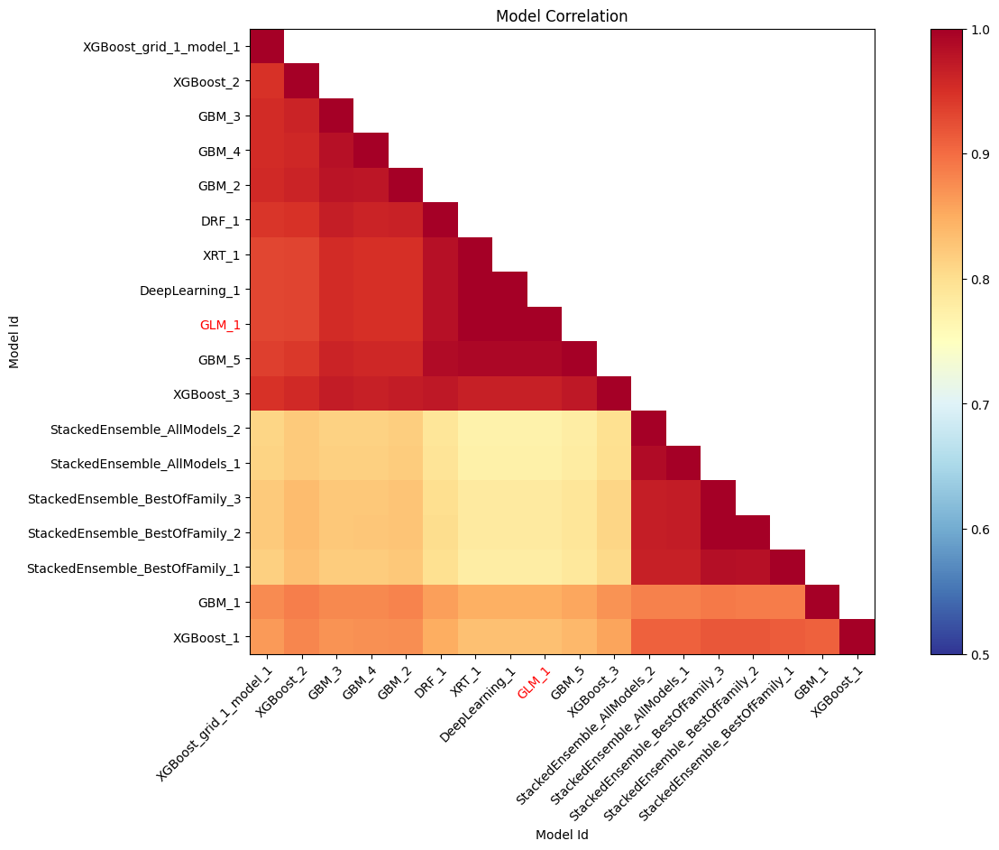

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

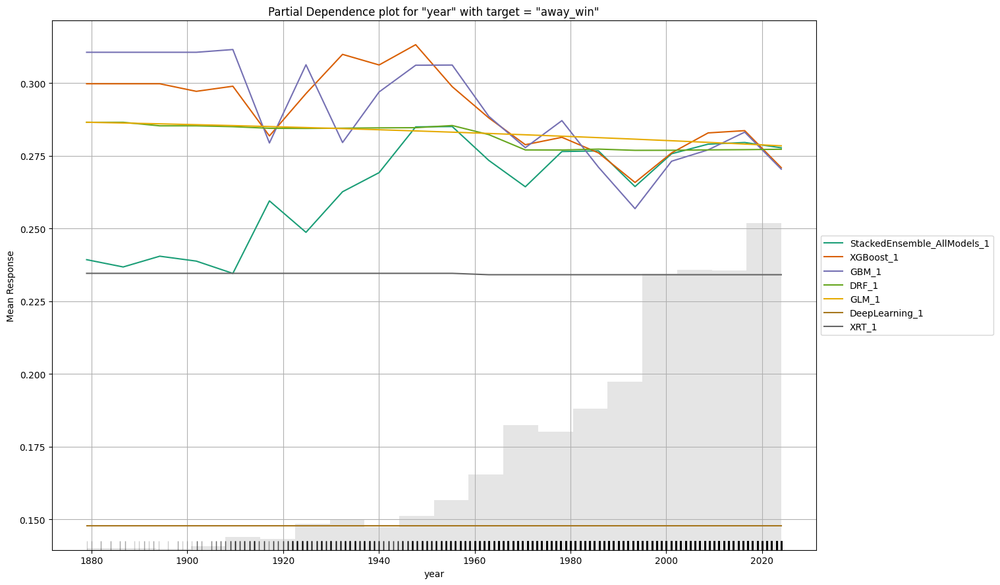

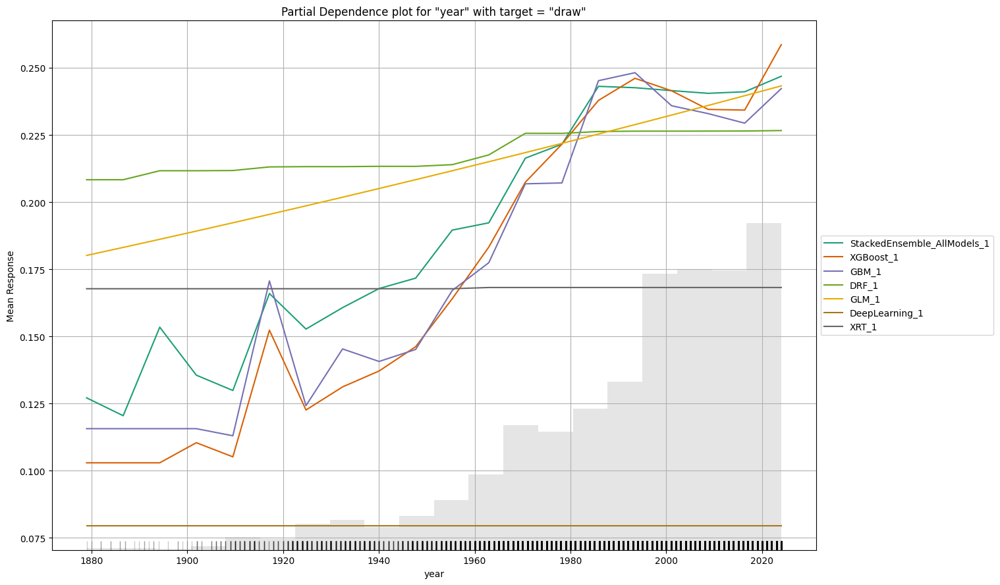

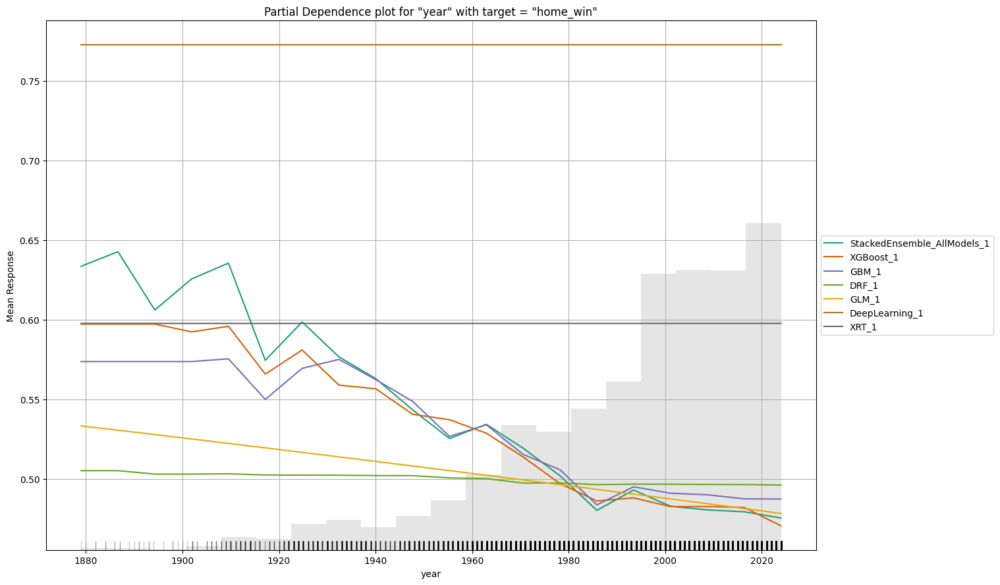

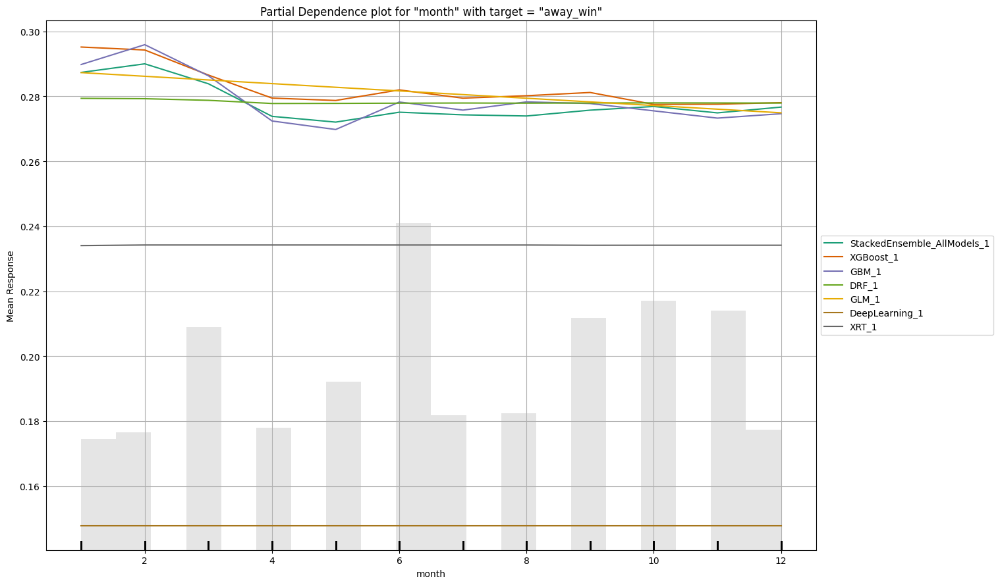

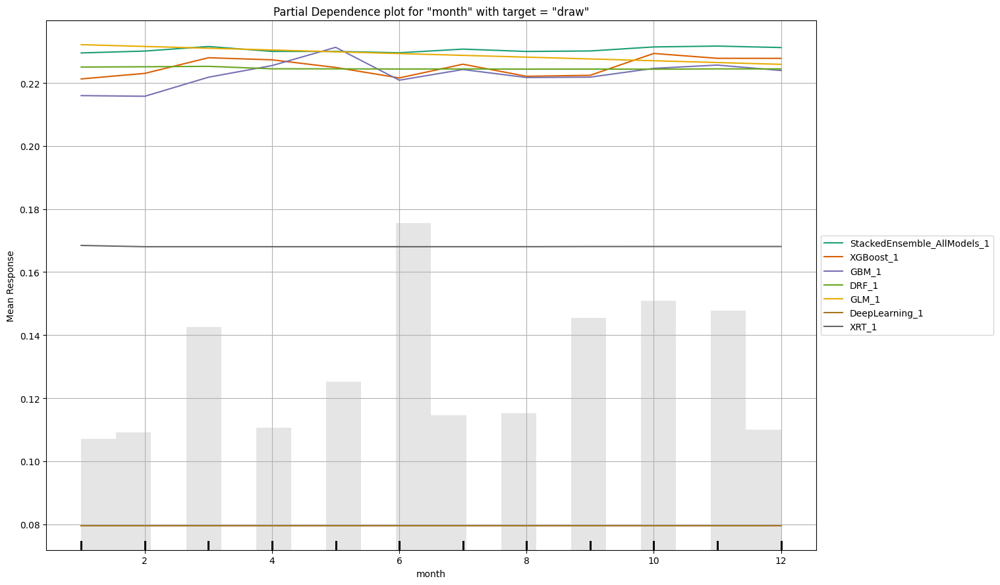

...

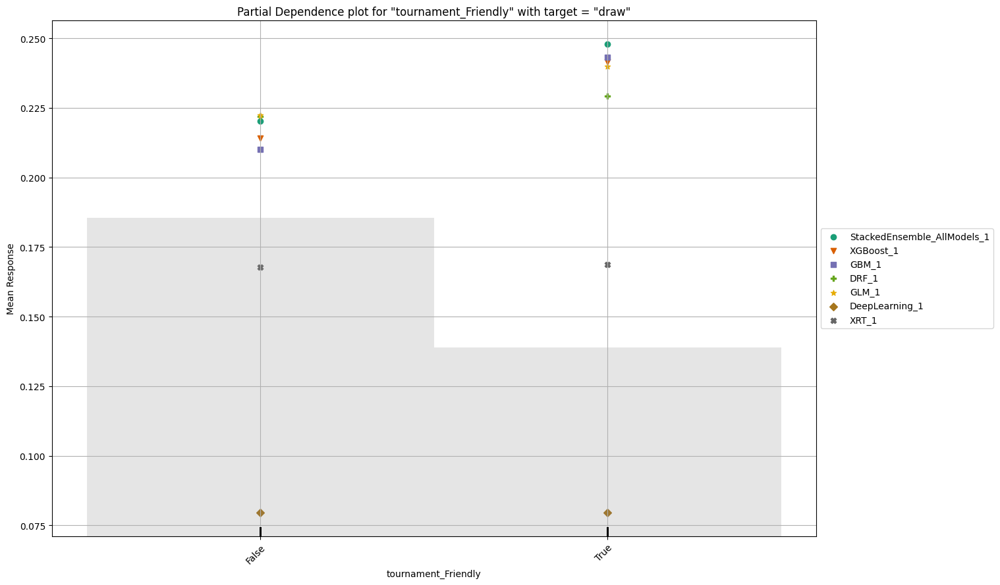

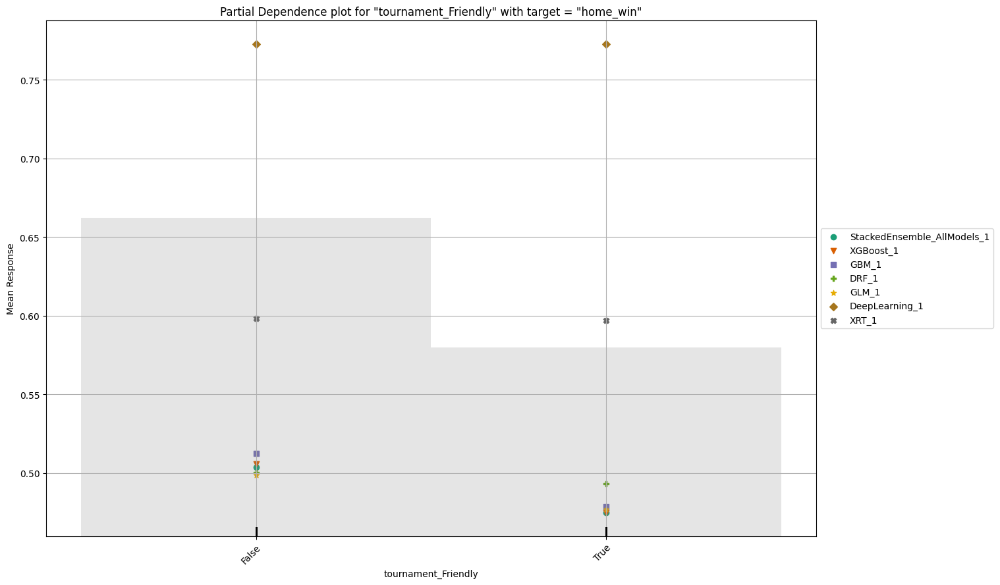

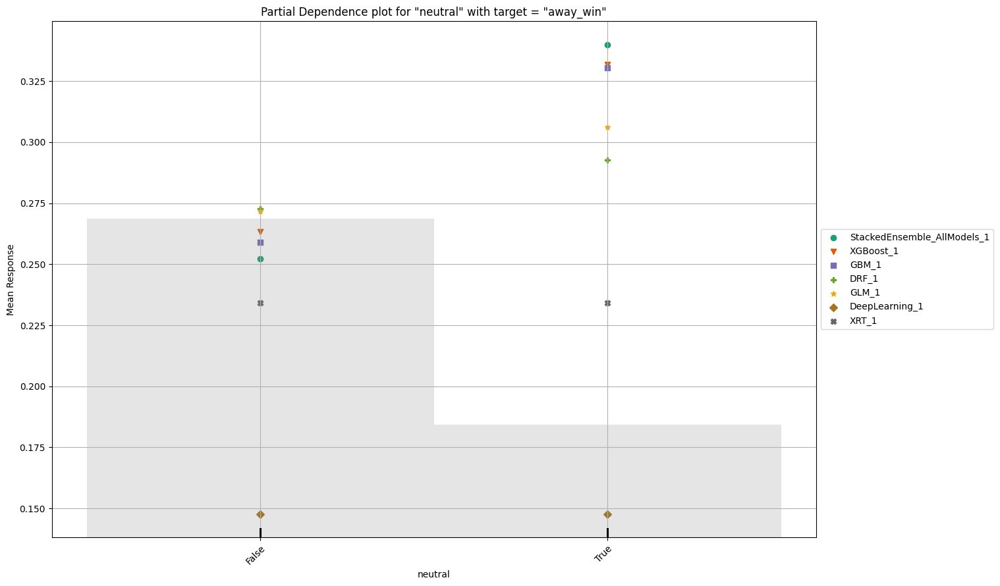

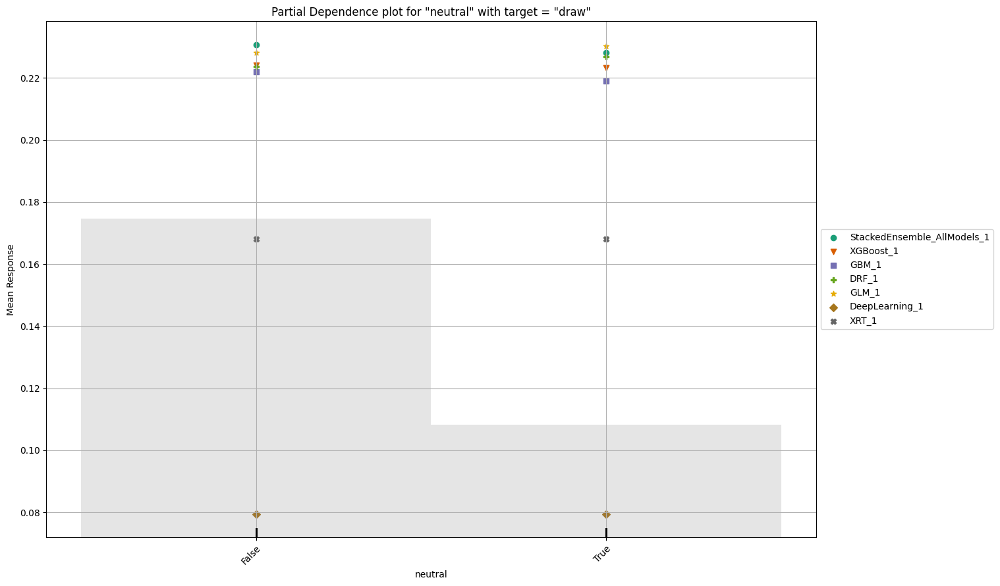

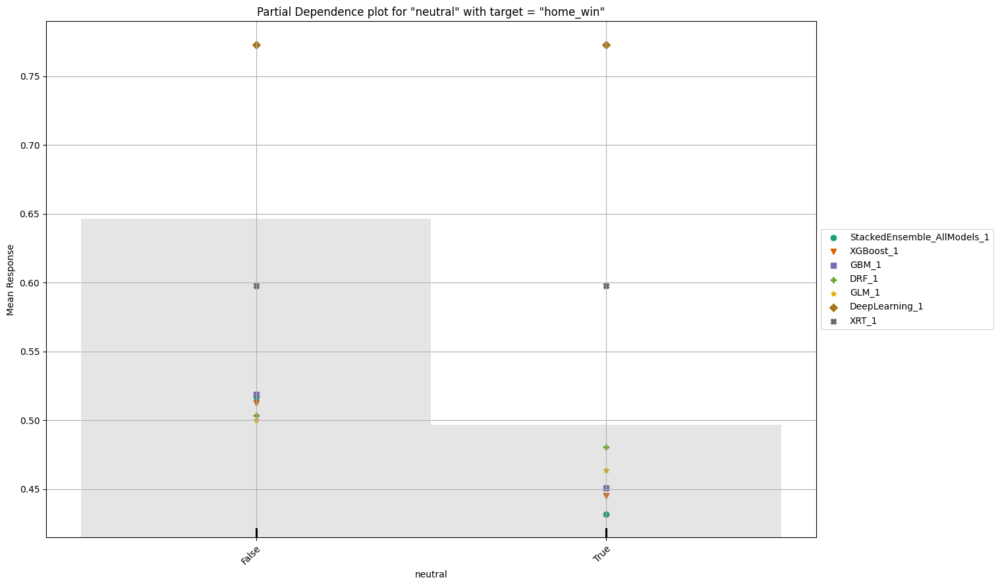

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,mean_per_class_error,logloss,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
StackedEnsemble_AllModels_2_AutoML_18_20250113_224052,0.570739,0.966302,0.605328,0.366422,29841,0.881234,StackedEnsemble
StackedEnsemble_AllModels_1_AutoML_18_20250113_224052,0.571421,0.967151,0.605693,0.366864,23038,0.958749,StackedEnsemble
StackedEnsemble_BestOfFamily_3_AutoML_18_20250113_224052,0.573582,0.967981,0.606194,0.367472,19086,0.390787,StackedEnsemble
StackedEnsemble_BestOfFamily_2_AutoML_18_20250113_224052,0.573659,0.967991,0.606204,0.367483,15747,0.345325,StackedEnsemble
StackedEnsemble_BestOfFamily_1_AutoML_18_20250113_224052,0.574166,0.969042,0.606536,0.367885,17509,0.477642,StackedEnsemble
XGBoost_1_AutoML_18_20250113_224052,0.589983,0.982511,0.612542,0.375208,1.06488e+06,0.025207,XGBoost
GBM_1_AutoML_18_20250113_224052,0.601487,0.992767,0.616185,0.379684,950466,0.130057,GBM
XGBoost_2_AutoML_18_20250113_224052,0.631616,1.01831,0.630337,0.397325,220041,0.047089,XGBoost
GBM_4_AutoML_18_20250113_224052,0.633858,1.0124,0.626017,0.391897,252388,0.07772,GBM
XGBoost_grid_1_AutoML_18_20250113_224052_model_1,0.634192,1.06719,0.655181,0.429262,45046,0.012722,XGBoost


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## StackedEnsemble_AllModels_1_AutoML_18_20250113_224052

away_win,draw,home_win,Error,Rate
1091.0,24.0,1636.0,0.6034169,"1,660 / 2,751"
502.0,16.0,1708.0,0.9928122,"2,210 / 2,226"
504.0,34.0,4020.0,0.1180342,"538 / 4,558"
2097.0,74.0,7364.0,0.4622968,"4,408 / 9,535"


# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

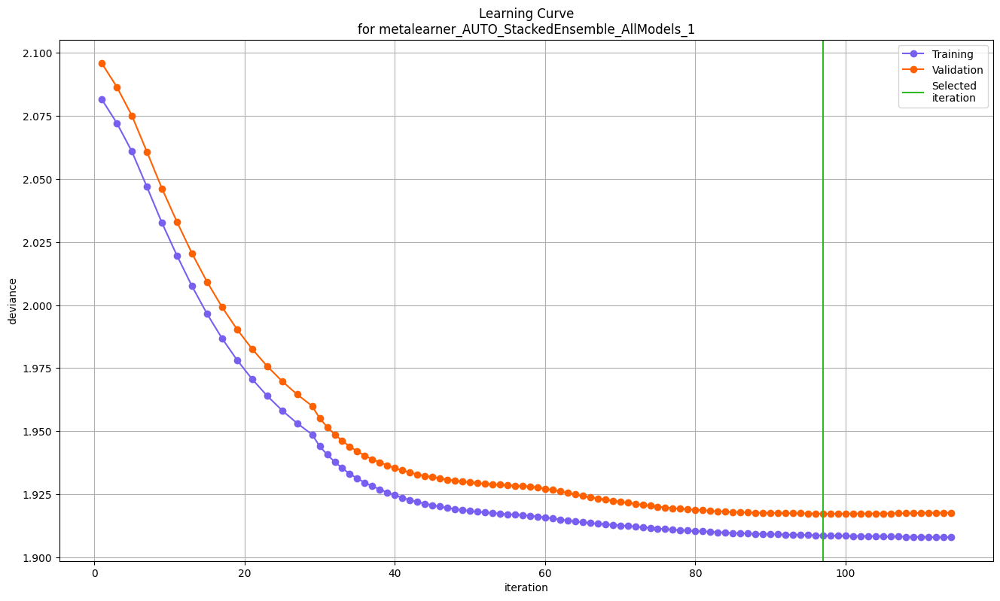

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

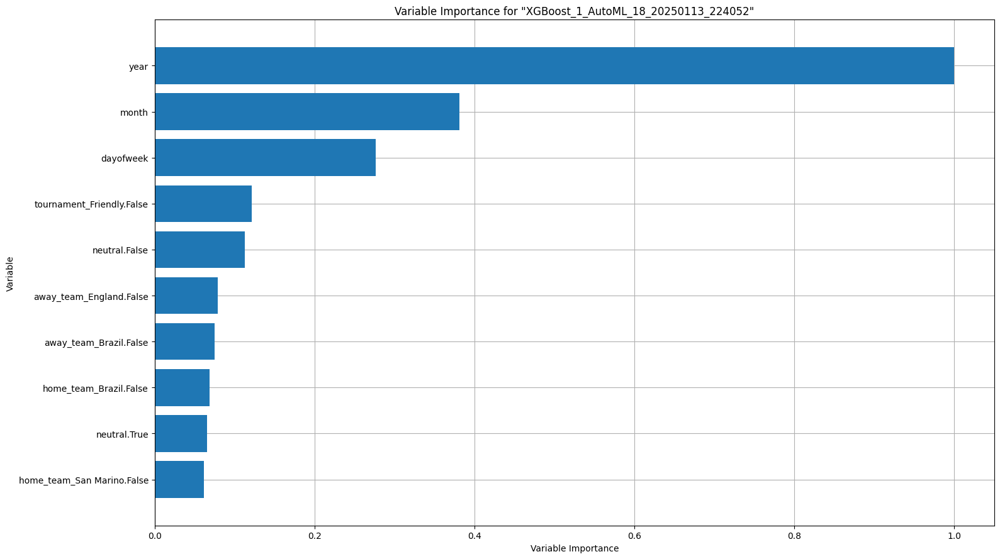

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

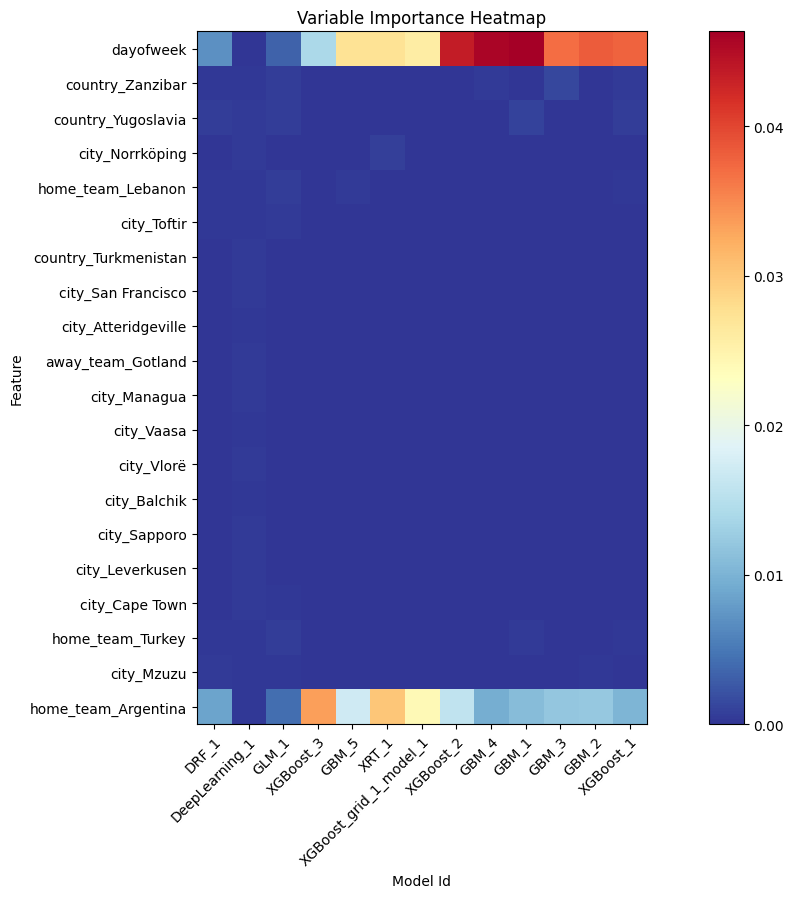

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

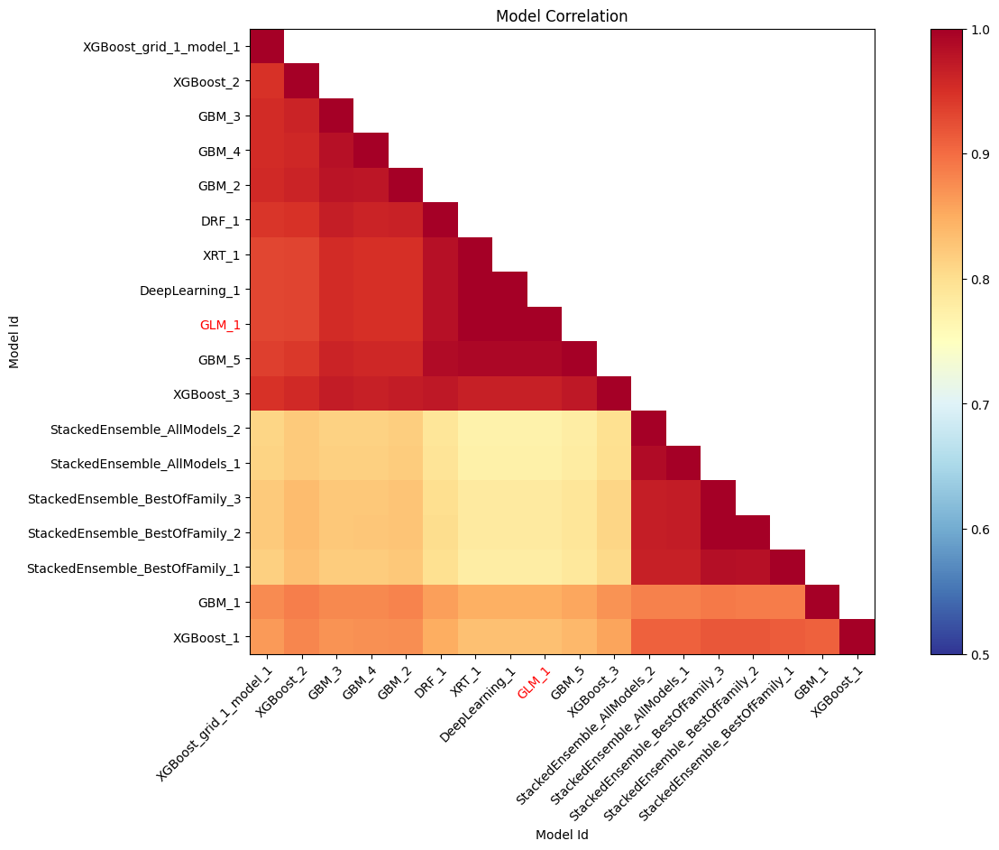

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

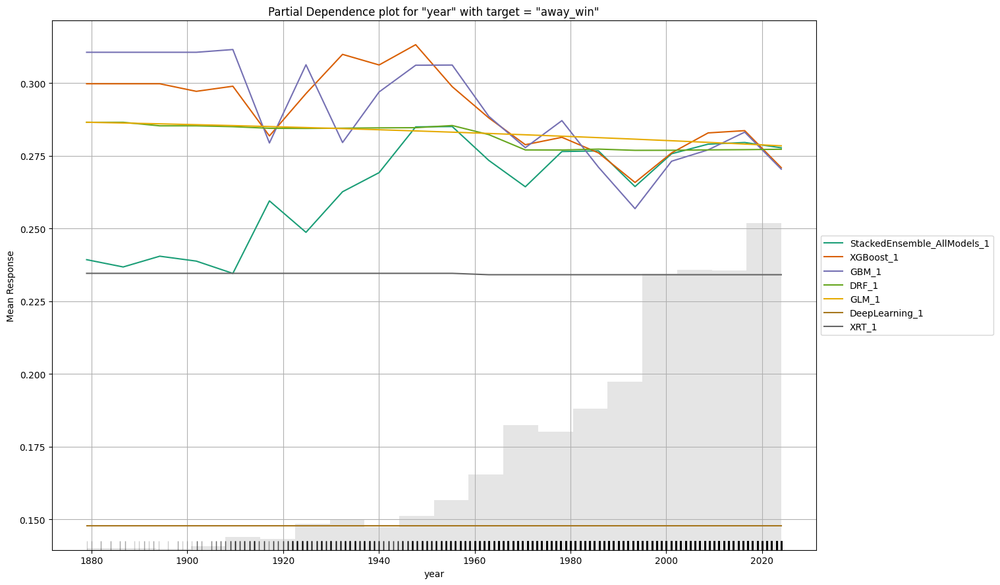

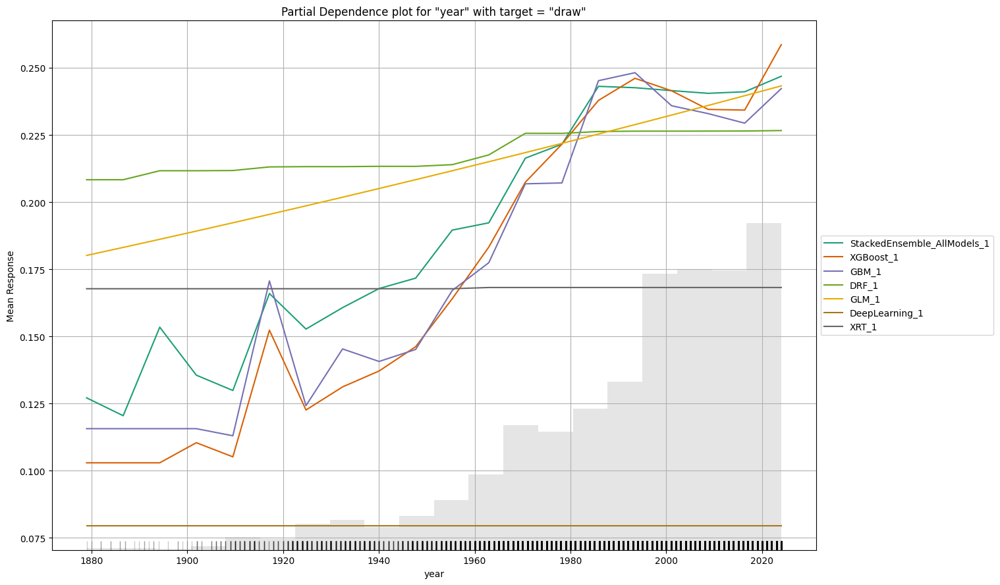

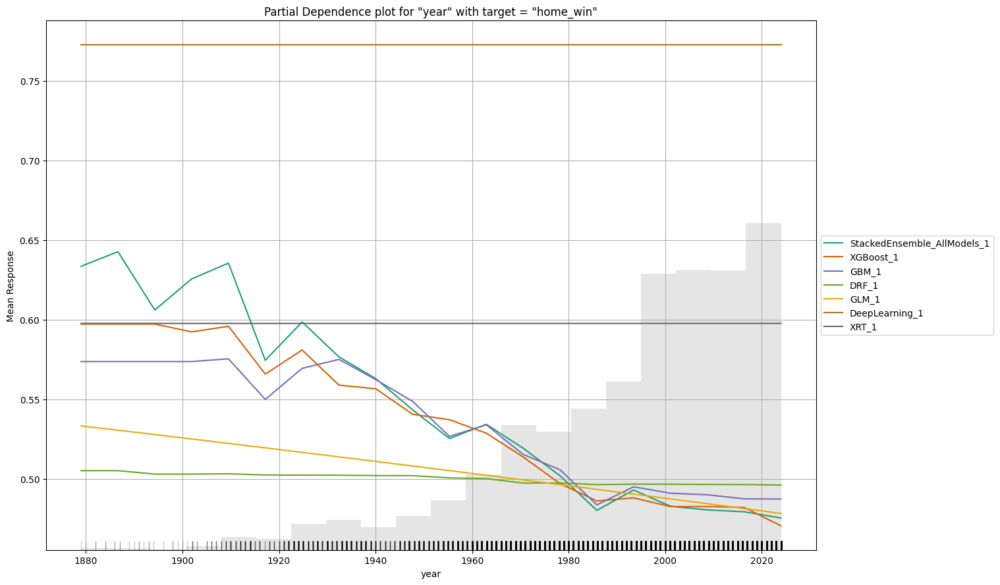

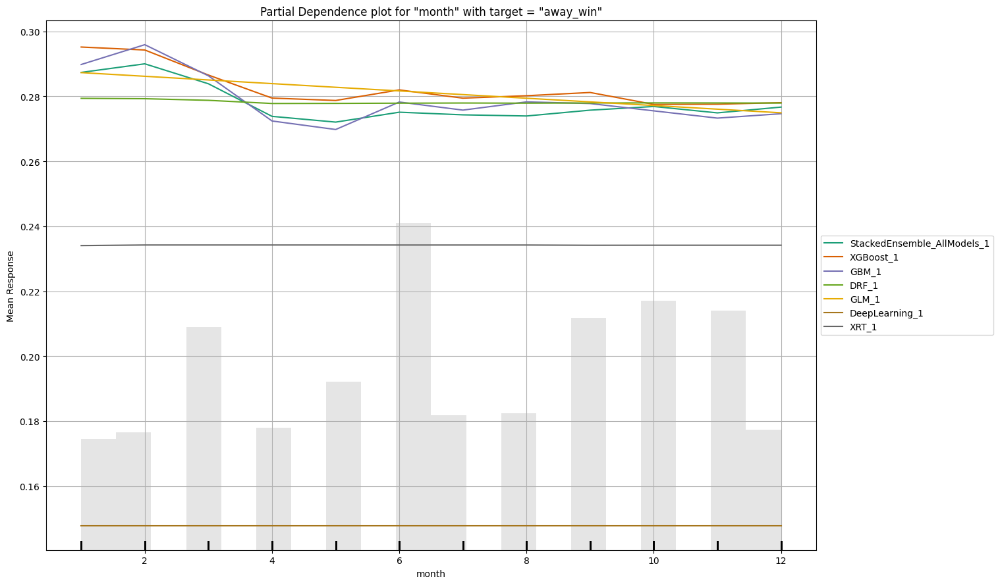

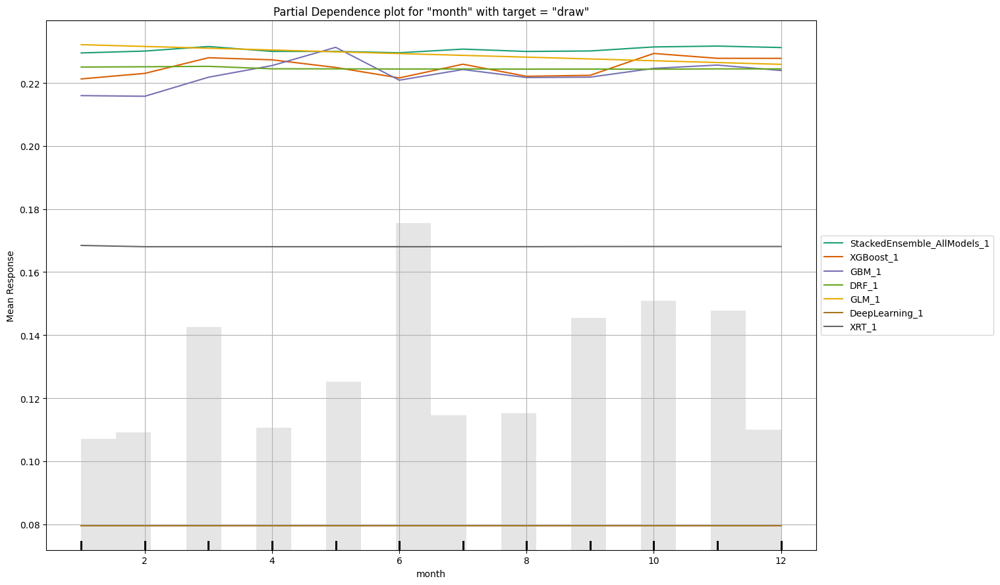

...

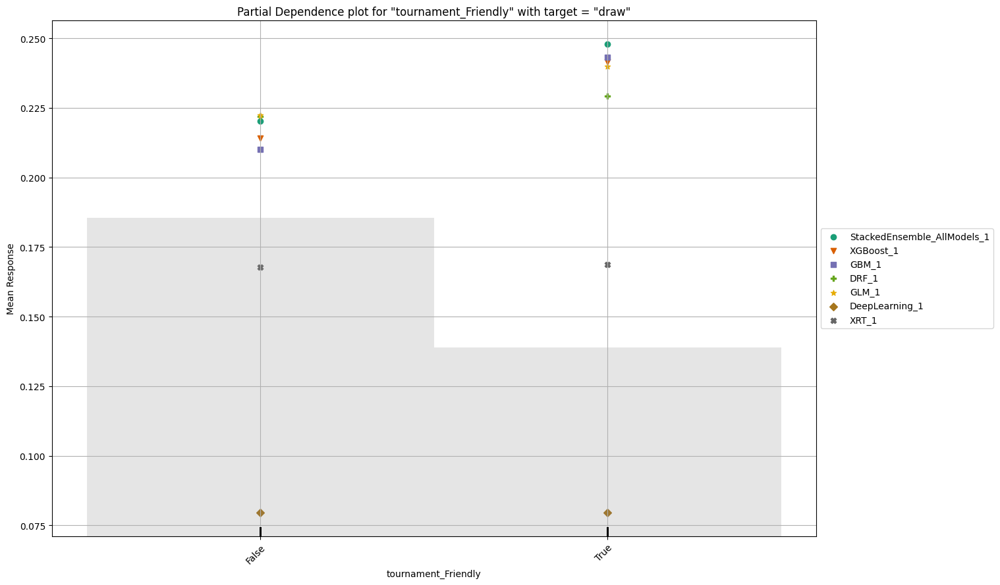

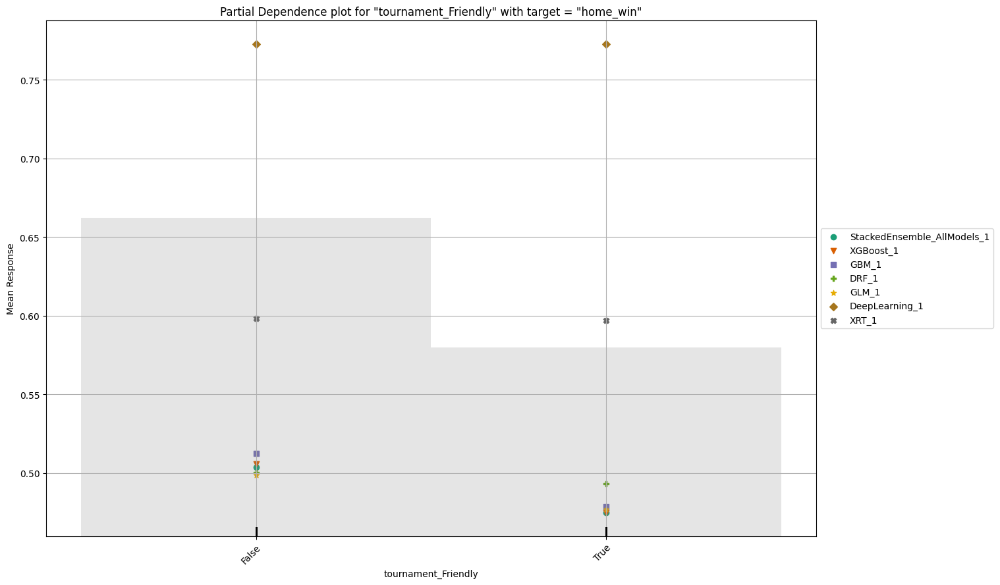

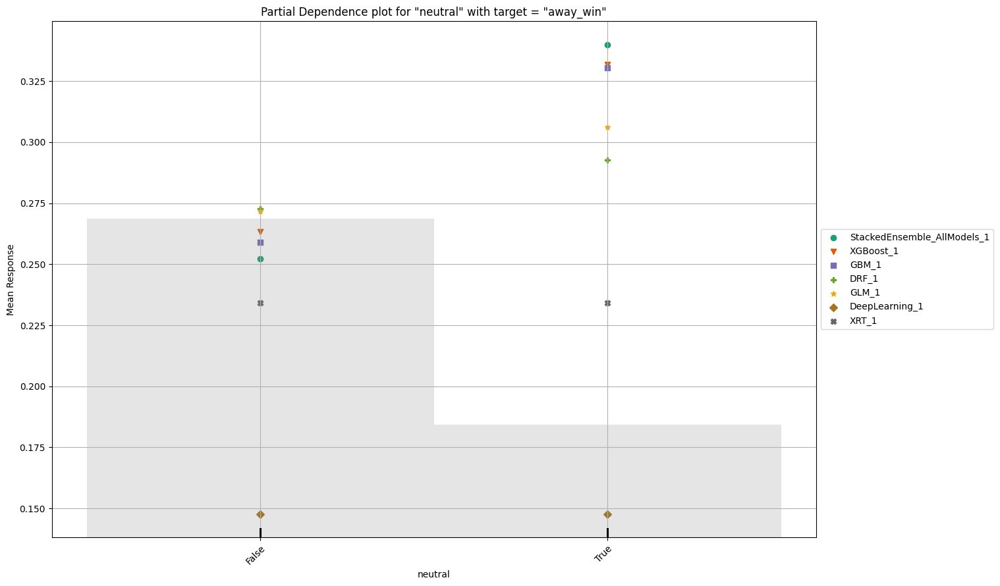

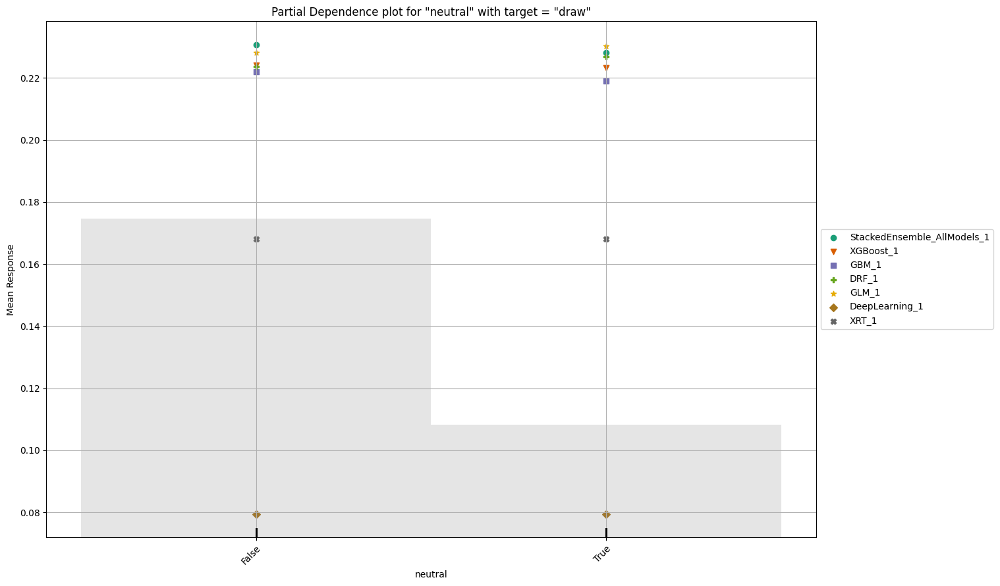

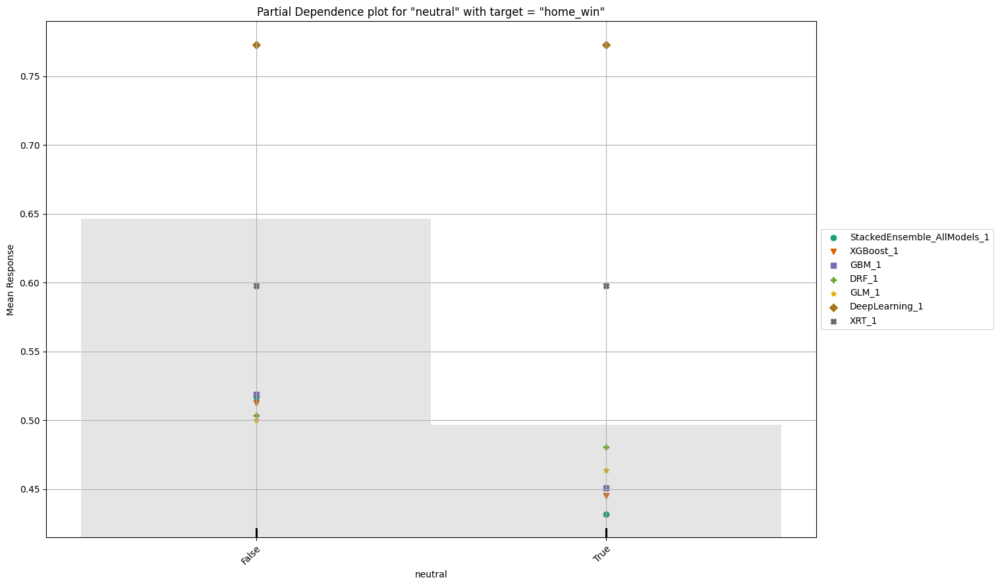

In [ ]:
aml.explain(frame=test)

In [ ]:
print_metric()

stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install polars and pyarrow and use it as pandas_df = h2o_df.as_data_frame(use_multi_thread=True)

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"
/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install polars and pyarrow and use it as pandas_df = h2o_df.as_data_frame(use_multi_thread=True)

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"
/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install polars and pyarrow a

Accuracy: 0.5377031987414788
F1-score: 0.4554784871231177
Precision: 0.4615374349997598
Recall: 0.5377031987414788
ROC-AUC: 0.676254196384379
Confusion Matrix:
 [[1091   24 1636]
 [ 502   16 1708]
 [ 504   34 4020]]
              precision    recall  f1-score   support

    away_win       0.52      0.40      0.45      2751
        draw       0.22      0.01      0.01      2226
    home_win       0.55      0.88      0.67      4558

    accuracy                           0.54      9535
   macro avg       0.43      0.43      0.38      9535
weighted avg       0.46      0.54      0.46      9535



## TPOT

In [ ]:
target = 'result'
X = data.drop(columns=[target])
y = data[target]

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
del data

In [ ]:
import gc

In [ ]:
from sklearn.model_selection import StratifiedKFold

In [ ]:
tpot = TPOTClassifier(
        generations=5,
        population_size=20,
        verbosity=3,
        random_state=42,
        n_jobs=-1,
        max_time_mins=60,
        scoring='balanced_accuracy',
        cv=StratifiedKFold(n_splits=5),
    )

In [ ]:
# Запуск обучения
tpot.fit(X_train, y_train)

32 operators have been imported by TPOT.


Optimization Progress:   0%|          | 0/20 [00:00<?, ?pipeline/s]

Skipped pipeline #3 due to time out. Continuing to the next pipeline.
Skipped pipeline #5 due to time out. Continuing to the next pipeline.
Skipped pipeline #8 due to time out. Continuing to the next pipeline.
Skipped pipeline #10 due to time out. Continuing to the next pipeline.
Skipped pipeline #14 due to time out. Continuing to the next pipeline.
Skipped pipeline #16 due to time out. Continuing to the next pipeline.
Skipped pipeline #18 due to time out. Continuing to the next pipeline.
Skipped pipeline #20 due to time out. Continuing to the next pipeline.
Skipped pipeline #25 due to time out. Continuing to the next pipeline.
Skipped pipeline #27 due to time out. Continuing to the next pipeline.
Skipped pipeline #29 due to time out. Continuing to the next pipeline.
_pre_test decorator: _random_mutation_operator: num_test=0 dtype='numeric' is not compatible with arrays of bytes/strings.Convert your data to numeric values explicitly instead..
_pre_test decorator: _random_mutation_opera

TPOTClassifier(cv=StratifiedKFold(n_splits=5, random_state=None, shuffle=False),
               generations=5, max_time_mins=60, n_jobs=-1, population_size=20,
               random_state=42, scoring='balanced_accuracy', verbosity=3)

In [ ]:
if hasattr(tpot.fitted_pipeline_, 'transform'):
    transformed_X_train = tpot.fitted_pipeline_.transform(X_train)
    print("Features после трансформации(TPOT):", transformed_X_train.shape)
if hasattr(tpot.fitted_pipeline_.steps[-1][1], 'feature_importances_'):
    importances = tpot.fitted_pipeline_.steps[-1][1].feature_importances_
    feature_names = X_train.columns
    feature_importance_df = pd.DataFrame({'feature': feature_names, 'importance': importances})
    feature_importance_df = feature_importance_df.sort_values(by=['importance'], ascending=False)

    # Визуализация
    plt.figure(figsize=(10, 6))
    sns.barplot(x='importance', y='feature', data=feature_importance_df)
    plt.title('TPOT Feature Importance')
    plt.show()

In [ ]:
y_pred = tpot.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
cm = confusion_matrix(y_test, y_pred)

print(f"Accuracy: {accuracy}")
print(f"F1-score: {f1}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print("Confusion Matrix:\n", cm)
print(classification_report(y_test, y_pred))

Accuracy: 0.5684474123539232
F1-score: 0.5212001506414923
Precision: 0.5200555691311007
Recall: 0.5684474123539232
Confusion Matrix:
 [[1445  166 1079]
 [ 657  180 1347]
 [ 673  214 3823]]
              precision    recall  f1-score   support

    away_win       0.52      0.54      0.53      2690
        draw       0.32      0.08      0.13      2184
    home_win       0.61      0.81      0.70      4710

    accuracy                           0.57      9584
   macro avg       0.48      0.48      0.45      9584
weighted avg       0.52      0.57      0.52      9584



## AutoGluon

In [ ]:
target = 'result'
features = data.drop(columns=['result'])
data.dropna(subset=[target], inplace=True)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(
    features, data[target], test_size=0.2, random_state=42)

In [ ]:
# Объединяем X и y для AutoGluon (он требует один датафрейм)
train_data = pd.concat([X_train, y_train.reset_index(drop=True)], axis=1)
test_data = pd.concat([X_test, y_test.reset_index(drop=True)], axis=1)

In [ ]:
# Инициализируем AutoGluon
predictor = TabularPredictor(label=target, problem_type='multiclass', eval_metric='f1_weighted')

No path specified. Models will be saved in: "AutogluonModels/ag-20250114_014058"


In [ ]:
train_data.dropna(subset=[target], inplace=True)
test_data.dropna(subset=[target], inplace=True)

In [ ]:
train_data.head()

,neutral,home_team_Abkhazia,home_team_Afghanistan,home_team_Albania,home_team_Alderney,home_team_Algeria,home_team_American Samoa,home_team_Andalusia,home_team_Andorra,home_team_Angola,...,country_Yugoslavia,country_Zambia,country_Zanzibar,country_Zaïre,country_Zimbabwe,country_Éire,year,month,dayofweek,result
13920,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,1983.0,11.0,2.0,away_win
96,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,1894.0,4.0,5.0,home_win
30214,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,2006.0,9.0,0.0,home_win
22584,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,1998.0,2.0,6.0,away_win
4913,True,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,1959.0,12.0,5.0,home_win


In [ ]:
predictor.fit(
    train_data=train_data,
    time_limit=3600,  # Время выполнения (1 час)
    presets='good_quality_faster_inference_only_refit'  # Акцент на качество
)

Preset alias specified: 'good_quality_faster_inference_only_refit' maps to 'good_quality'.
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.2
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       9.15 GB / 12.67 GB (72.2%)
Disk Space Avail:   72.59 GB / 107.72 GB (67.4%)
Presets specified: ['good_quality_faster_inference_only_refit']
Setting dynamic_stacking from 'auto' to True. Reason: Enable dynamic_stacking when use_bag_holdout is disabled. (use_bag_holdout=False)
Stack configuration (auto_stack=True): num_stack_levels=1, num_bag_folds=8, num_bag_sets=1
Note: `save_bag_folds=False`! This will greatly reduce peak disk usage during fit (by ~8x), but runs the risk of an out-of-memory error during model refit if memory is small relative to the data size.
	You can avoid this risk by setting `s

In [ ]:
# Оценка на тестовом наборе
performance = predictor.evaluate(test_data)
print(performance)

{'f1_weighted': 0.3298741154736082, 'accuracy': 0.4887312186978297, 'balanced_accuracy': 0.33360743846560625, 'mcc': 0.0027491859814350187}


In [ ]:
!pip install dask[dataframe]

In [ ]:
# Важность признаков
feature_importances = predictor.feature_importance(test_data)
print("Feature Importances:\n", feature_importances.head(20))

These features in provided data are not utilized by the predictor and will be ignored: ['home_team_Afghanistan', 'home_team_Andalusia', 'home_team_Anguilla', 'home_team_Arameans Suryoye', 'home_team_Artsakh', 'home_team_Barawa', 'home_team_Biafra', 'home_team_Bonaire', 'home_team_Brittany', 'home_team_Canary Islands', 'home_team_Cascadia', 'home_team_Central Spain', 'home_team_Chagos Islands', 'home_team_Chameria', 'home_team_Cook Islands', 'home_team_Corsica', 'home_team_Darfur', 'home_team_Donetsk PR', 'home_team_Délvidék', 'home_team_East Timor', 'home_team_Elba Island', 'home_team_Ellan Vannin', 'home_team_Falkland Islands', 'home_team_Felvidék', 'home_team_Franconia', 'home_team_Gotland', 'home_team_Gozo', 'home_team_Găgăuzia', 'home_team_Hitra', 'home_team_Hmong', 'home_team_Iraqi Kurdistan', 'home_team_Kabylia', 'home_team_Kernow', 'home_team_Kiribati', 'home_team_Kárpátalja', 'home_team_Luhansk PR', 'home_team_Madrid', 'home_team_Malaya', 'home_team_Manchukuo', 'home_team_Mapuc

KeyboardInterrupt: 

In [ ]:
predictor.leaderboard(test_data, extra_info=True)

,model,score_test,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,...,hyperparameters,hyperparameters_fit,ag_args_fit,features,compile_time,child_hyperparameters,child_hyperparameters_fit,child_ag_args_fit,ancestors,descendants
0,LightGBMXT_BAG_L1_FULL,0.329874,NaN,f1_weighted,3.022960,NaN,49.298675,3.022960,NaN,49.298675,...,"{'use_orig_features': True, 'valid_stacker': True, 'max_base_models': 0, 'max_base_models_per_type': 'auto', 'save_bag_folds': True}",{},"{'max_memory_usage_ratio': 1.15, 'max_time_limit_ratio': 1.0, 'max_time_limit': None, 'min_time_limit': 0, 'valid_raw_types': None, 'valid_special_types': None, 'ignored_type_group_special': None, 'ignored_type_group_raw': None, 'get_features_kwargs': None, 'get_features_kwargs_extra': None, 'predict_1_batch_size': None, 'temperature_scalar': None, 'drop_unique': False}","[city_St Helier, home_team_Guadeloupe, home_team_Mauritius, away_team_Bosnia and Herzegovina, city_Strumica, away_team_Western Australia, home_team_Malta, away_team_Martinique, away_team_Denmark, away_team_Israel, away_team_Saint Kitts and Nevis, city_Calcutta, away_team_Alderney, city_Naples, away_team_Mongolia, tournament_Copa Juan Pinto Durán, country_Malawi, away_team_Guernsey, city_Paynesville, tournament_Southeast Asian Games, home_team_Sierra Leone, away_team_England, city_Mazatenango, city_Titograd, city_Dubai, home_team_Colombia, tournament_Mundialito, country_Hong Kong, away_team...",None,"{'learning_rate': 0.05, 'extra_trees': True, 'num_boost_round': 335}",{'num_boost_round': 335},"{'max_memory_usage_ratio': 1.0, 'max_time_limit_ratio': 1.0, 'max_time_limit': None, 'min_time_limit': 0, 'valid_raw_types': ['bool', 'int', 'float', 'category'], 'valid_special_types': None, 'ignored_type_group_special': None, 'ignored_type_group_raw': None, 'get_features_kwargs': None, 'get_features_kwargs_extra': None, 'predict_1_batch_size': None, 'temperature_scalar': None}",[],"[NeuralNetFastAI_BAG_L2_FULL, LightGBMXT_BAG_L2_FULL, WeightedEnsemble_L3_FULL, WeightedEnsemble_L2_FULL]"
1,WeightedEnsemble_L2_FULL,0.329874,NaN,f1_weighted,3.025489,NaN,51.367880,0.002529,NaN,2.069205,...,"{'use_orig_features': False, 'valid_stacker': True, 'max_base_models': 0, 'max_base_models_per_type': 'auto', 'save_bag_folds': True}",{},"{'max_memory_usage_ratio': 1.0, 'max_time_limit_ratio': 1.0, 'max_time_limit': None, 'min_time_limit': 0, 'valid_raw_types': None, 'valid_special_types': None, 'ignored_type_group_special': None, 'ignored_type_group_raw': None, 'get_features_kwargs': None, 'get_features_kwargs_extra': None, 'predict_1_batch_size': None, 'temperature_scalar': None, 'drop_unique': False}","[LightGBMXT_BAG_L1_0, LightGBMXT_BAG_L1_1, LightGBMXT_BAG_L1_2]",None,"{'ensemble_size': 25, 'subsample_size': 1000000}",{'ensemble_size': 1},"{'max_memory_usage_ratio': 1.0, 'max_time_limit_ratio': 1.0, 'max_time_limit': None, 'min_time_limit': 0, 'valid_raw_types': None, 'valid_special_types': None, 'ignored_type_group_special': None, 'ignored_type_group_raw': None, 'get_features_kwargs': None, 'get_features_kwargs_extra': None, 'predict_1_batch_size': None, 'temperature_scalar': None, 'drop_unique': False}",[LightGBMXT_BAG_L1_FULL],[]
2,WeightedEnsemble_L3_FULL,0.329874,NaN,f1_weighted,3.025803,NaN,52.517190,0.002842,NaN,3.218515,...,"{'use_orig_features': False, 'valid_stacker': True, 'max_base_models': 0, 'max_base_models_per_type': 'auto', 'save_bag_folds': True}",{},"{'max_memory_usage_ratio': 1.0, 'max_time_limit_ratio': 1.0, 'max_time_limit': None, 'min_time_limit': 0, 'valid_raw_types': None, 'valid_special_types': None, 'ignored_type_group_special': None, 'ignored_type_group_raw': None, 'get_features_kwargs': None, 'get_features_kwargs_extra': None, 'predict_1_batch_size': None, 'temperature_scalar': None, 'drop_unique': False}","[LightGBMXT_BAG_L1_0, LightGBMXT_BAG_L1_1, LightGBMXT_BAG_L1_2]",None,"{'ensemble_size': 25, 'subsample_size':

In [ ]:
y_pred = predictor.predict(test_data)
y_pred_proba = predictor.predict_proba(test_data)

In [ ]:
best_model = predictor.model_best
print(best_model)
print(predictor.info())

LightGBMXT_BAG_L1_FULL
{'path': '/content/AutogluonModels/ag-20250114_014058', 'label': 'result', 'random_state': 0, 'version': '1.2', 'features': ['neutral', 'home_team_Abkhazia', 'home_team_Albania', 'home_team_Alderney', 'home_team_Algeria', 'home_team_American Samoa', 'home_team_Andorra', 'home_team_Angola', 'home_team_Antigua and Barbuda', 'home_team_Argentina', 'home_team_Armenia', 'home_team_Aruba', 'home_team_Australia', 'home_team_Austria', 'home_team_Aymara', 'home_team_Azerbaijan', 'home_team_Bahamas', 'home_team_Bahrain', 'home_team_Bangladesh', 'home_team_Barbados', 'home_team_Basque Country', 'home_team_Belarus', 'home_team_Belgium', 'home_team_Belize', 'home_team_Benin', 'home_team_Bermuda', 'home_team_Bhutan', 'home_team_Bolivia', 'home_team_Bosnia and Herzegovina', 'home_team_Botswana', 'home_team_Brazil', 'home_team_British Virgin Islands', 'home_team_Brunei', 'home_team_Bulgaria', 'home_team_Burkina Faso', 'home_team_Burma', 'home_team_Burundi', 'home_team_Cambodia',

In [ ]:
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')  # Или 'macro', 'micro'
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
roc_auc = roc_auc_score(y_test, y_pred_proba, multi_class='ovr', average='weighted')

print(f"Accuracy: {accuracy}")
print(f"F1-score: {f1}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"ROC-AUC: {roc_auc}")
print(classification_report(y_test, y_pred))

Accuracy: 0.4890442404006678
F1-score: 0.3303504261286373
Precision: 0.38870068121265333
Recall: 0.4890442404006678
ROC-AUC: 0.4967021877347033
              precision    recall  f1-score   support

    away_win       0.28      0.01      0.02      2690
        draw       0.30      0.00      0.01      2184
    home_win       0.49      0.99      0.66      4710

    accuracy                           0.49      9584
   macro avg       0.36      0.33      0.23      9584
weighted avg       0.39      0.49      0.33      9584



# Эксперимент 3

In [ ]:
data = pd.read_csv('/content/Experiment_3.csv')

## H2O

In [ ]:
metrics_data = []

def print_metric():
  y_pred = aml.leader.predict(test)
  y_pred_df = y_pred.as_data_frame()['predict']

  y_test_df = test['match_result'].as_data_frame()['match_result']

  y_test_df = y_test_df.astype(str)
  y_pred_df = y_pred_df.astype(str)

  accuracy = accuracy_score(y_test_df, y_pred_df)
  f1 = f1_score(y_test_df, y_pred_df, average='weighted')
  precision = precision_score(y_test_df, y_pred_df, average='weighted')
  recall = recall_score(y_test_df, y_pred_df, average='weighted')

  # Convert y_pred to numpy array for roc_auc_score
  y_pred_proba = y_pred.as_data_frame()[y_pred.as_data_frame().columns[1:]].to_numpy()
  roc_auc = roc_auc_score(y_test_df, y_pred_proba, multi_class='ovr', average='weighted')

  cm = confusion_matrix(y_test_df, y_pred_df)


  print(f"Accuracy: {accuracy}")
  print(f"F1-score: {f1}")
  print(f"Precision: {precision}")
  print(f"Recall: {recall}")
  print(f"ROC-AUC: {roc_auc}")
  print("Confusion Matrix:\n", cm)
  print(classification_report(y_test_df, y_pred_df))

  metrics_data.append({
           'accuracy': accuracy,
           'f1_score': f1,
           'precision': precision,
           'recall': recall,
           'roc_auc': roc_auc,
           'confusion matrix:': cm})

In [ ]:
h2o.init()
h2o_df = h2o.import_file('Experiment_3.csv')
target = 'match_result'
features = [col for col in h2o_df.columns if col != target]
train, test = h2o_df.split_frame(ratios=[0.8], seed=42)

Checking whether there is an H2O instance running at http://localhost:54321..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "11.0.25" 2024-10-15; OpenJDK Runtime Environment (build 11.0.25+9-post-Ubuntu-1ubuntu122.04); OpenJDK 64-Bit Server VM (build 11.0.25+9-post-Ubuntu-1ubuntu122.04, mixed mode, sharing)
  Starting server from /usr/local/lib/python3.10/dist-packages/h2o/backend/bin/h2o.jar
  Ice root: /tmp/tmpny8yl3k6
  JVM stdout: /tmp/tmpny8yl3k6/h2o_unknownUser_started_from_python.out
  JVM stderr: /tmp/tmpny8yl3k6/h2o_unknownUser_started_from_python.err
  Server is running at http://127.0.0.1:54321
Connecting to H2O server at http://127.0.0.1:54321 ... successful.


H2O_cluster_uptime:,07 secs
H2O_cluster_timezone:,Etc/UTC
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.46.0.6
H2O_cluster_version_age:,2 months and 12 days
H2O_cluster_name:,H2O_from_python_unknownUser_8swkdc
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,3.170 Gb
H2O_cluster_total_cores:,2
H2O_cluster_allowed_cores:,2
H2O_cluster_status:,"locked, healthy"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


In [ ]:
aml = H2OAutoML(max_runtime_secs=3600, seed=42, project_name=f"feature_inj_33", balance_classes=True)
aml.train(x=features, y=target, training_frame=train)


AutoML progress: |███████████████████████████████████████████████████████████████| (done) 100%


Model Details
=============
H2OXGBoostEstimator : XGBoost
Model Key: XGBoost_grid_1_AutoML_19_20250114_14341_model_6


Model Summary: 
    number_of_trees
--  -----------------
    42

ModelMetricsMultinomial: xgboost
** Reported on train data. **

MSE: 0.26611476655259925
RMSE: 0.5158631277311834
LogLoss: 0.7367897499164402
Mean Per-Class Error: 0.3921784109513895
AUC table was not computed: it is either disabled (model parameter 'auc_type' was set to AUTO or NONE) or the domain size exceeds the limit (maximum is 50 domains).
AUCPR table was not computed: it is either disabled (model parameter 'auc_type' was set to AUTO or NONE) or the domain size exceeds the limit (maximum is 50 domains).

Confusion Matrix: Row labels: Actual class; Column labels: Predicted class
draw    loss    win    Error     Rate
------  ------  -----  --------  ---------------
2233    2181    4262   0.742623  6,443 / 8,676
574     7384    2822   0.315028  3,396 / 10,780
582     1668    16676  0.118884  2,250 / 18,926
3389    11233   23760  0.314965  12,089 / 38,382

Top-3 Hit Ratios: 
k    hit_ratio
---  -----------
1    0.685035
2    0.910375
3    1

ModelMetricsMultinomial: xgboost
** Reported on cross-validation data. **

MSE: 0.30958301408946154
RMSE: 0.5564018458717238
LogLoss: 0.8511336319053985
Mean Per-Class Error: 0.47513303339567625
AUC table was not computed: it is either disabled (model parameter 'auc_type' was set to AUTO or NONE) or the domain size exceeds the limit (maximum is 50 domains).
AUCPR table was not computed: it is either disabled (model parameter 'auc_type' was set to AUTO or NONE) or the domain size exceeds the limit (maximum is 50 domains).

Confusion Matrix: Row labels: Actual class; Column labels: Predicted class
draw    loss    win    Error     Rate
------  ------  -----  --------  ---------------
1178    2627    4871   0.864223  7,498 / 8,676
947     6527    3306   0.394527  4,253 / 10,780
998     2156    15772  0.166649  3,154 / 18,926
3123    11310   23949  0.388333  14,905 / 38,382

Top-3 Hit Ratios: 
k    hit_ratio
---  -----------
1    0.611667
2    0.8455
3    1

Cross-Validation Metrics Summary: 
                         mean      sd          cv_1_valid    cv_2_valid    cv_3_valid    cv_4_valid    cv_5_valid
-----------------------  --------  ----------  ------------  ------------  ------------  ------------  ------------
accuracy                 0.611667  0.00748563  0.619773      0.616647      0.605263      0.614252      0.602397
aic                      nan       0           nan           nan           nan           nan           nan
auc                      nan       0           nan           nan           nan           nan           nan
err                      0.388333  0.00748563  0.380227      0.383353      0.394737      0.385748      0.397603
err_count                2981      57.2931     2919          2943          3030          2961          3052
loglikelihood            nan       0           nan           nan           nan           nan           nan
logloss                  0.851134  0.00757194  0.842221      0.850541      0.858862      0.845381      0.858665
max_per_class_error      0.864212  0.00901626  0.866828      0.857143      0.863763      0.855346      0.87798
mean_per_class_accuracy  0.524862  0.00542117  0.523916      0.529409      0.524874      0.529745      0.516368
mean_per_class_error     0.475138  0.00542117  0.476084      0.470591      0.475126      0.470255      0.483632
mse                      0.309583  0.0030134   0.305403      0.309624      0.312098      0.308029      0.312762
pr_auc                   nan       0           nan           nan           nan           nan           nan
r2                       0.52199   0.00288277  0.520126      0.518695      0.524536      0.525419      0.521174
rmse                     0.556397  0.00270972  0.552632      0.556439      0.558658      0.555004      0.559251

Scoring History: 
    timestamp            duration          number_of_trees    

In [ ]:
aml = H2OAutoML(max_runtime_secs=600, seed=42, project_name=f"feature_inj_33", balance_classes=True)
aml.train(x=features, y=target, training_frame=train)


AutoML progress: |███████████████████████████████████████████████████████████████| (done) 100%


key,value
Stacking strategy,cross_validation
Number of base models (used / total),3/3
# GBM base models (used / total),1/1
# XGBoost base models (used / total),1/1
# GLM base models (used / total),1/1
Metalearner algorithm,GLM
Metalearner fold assignment scheme,Random
Metalearner nfolds,5
Metalearner fold_column,None
Custom metalearner hyperparameters,None


TypeError: '<' not supported between instances of 'float' and 'str'

In [ ]:
aml.leaderboard

model_id,mean_per_class_error,logloss,rmse,mse
StackedEnsemble_BestOfFamily_1_AutoML_1_20250114_43821,0.481166,0.848089,0.557435,0.310734
XGBoost_1_AutoML_1_20250114_43821,0.481875,0.887875,0.562343,0.316229
GBM_1_AutoML_1_20250114_43821,0.482076,0.85687,0.558561,0.311991
StackedEnsemble_AllModels_1_AutoML_1_20250114_43821,0.482493,0.8473,0.557409,0.310705
XGBoost_2_AutoML_1_20250114_43821,0.483221,0.869138,0.560796,0.314492
StackedEnsemble_BestOfFamily_2_AutoML_1_20250114_43821,0.483973,0.848378,0.557835,0.31118
GLM_1_AutoML_1_20250114_43821,0.496692,0.872956,0.56543,0.319711
GBM_3_AutoML_1_20250114_43821,0.499172,0.865603,0.566325,0.320724
GBM_2_AutoML_1_20250114_43821,0.499311,0.865674,0.56649,0.320911
GBM_4_AutoML_1_20250114_43821,0.512945,0.881172,0.572459,0.327709


# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,mean_per_class_error,logloss,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
StackedEnsemble_AllModels_1_AutoML_1_20250114_43821,0.480562,0.855929,0.56031,0.313948,29104,0.131792,StackedEnsemble
StackedEnsemble_BestOfFamily_1_AutoML_1_20250114_43821,0.481102,0.856818,0.560267,0.313899,17820,0.062404,StackedEnsemble
XGBoost_1_AutoML_1_20250114_43821,0.481523,0.895971,0.565733,0.320054,23538,0.015122,XGBoost
XGBoost_2_AutoML_1_20250114_43821,0.481965,0.870917,0.562993,0.316961,5599,0.006584,XGBoost
GBM_1_AutoML_1_20250114_43821,0.483091,0.868225,0.562171,0.316037,14322,0.045704,GBM
StackedEnsemble_BestOfFamily_2_AutoML_1_20250114_43821,0.483902,0.857286,0.560778,0.314472,17995,0.078744,StackedEnsemble
GLM_1_AutoML_1_20250114_43821,0.49411,0.881599,0.567748,0.322337,13791,0.000651,GLM
GBM_2_AutoML_1_20250114_43821,0.494597,0.872031,0.568354,0.323026,3509,0.015326,GBM
GBM_3_AutoML_1_20250114_43821,0.494824,0.874443,0.569392,0.324208,3698,0.01678,GBM
XGBoost_3_AutoML_1_20250114_43821,0.498618,1.01685,0.63669,0.405374,626,0.000732,XGBoost


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## StackedEnsemble_BestOfFamily_1_AutoML_1_20250114_43821

draw,loss,win,Error,Rate
150.0,715.0,1361.0,0.9326146,"2,076 / 2,226"
101.0,1739.0,911.0,0.3678662,"1,012 / 2,751"
102.0,549.0,3907.0,0.1428258,"651 / 4,558"
353.0,3003.0,6179.0,0.3921342,"3,739 / 9,535"


# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

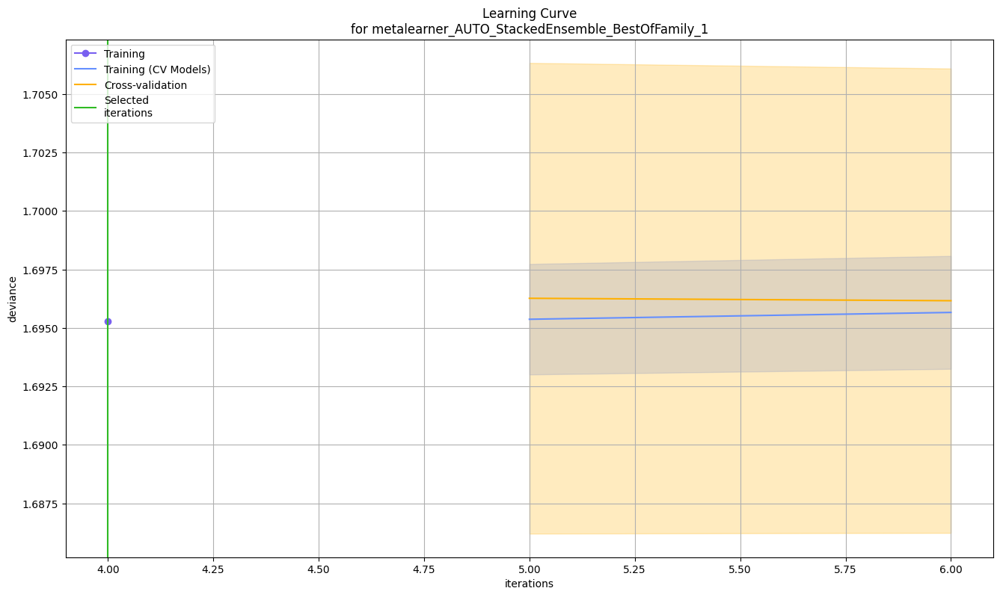

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

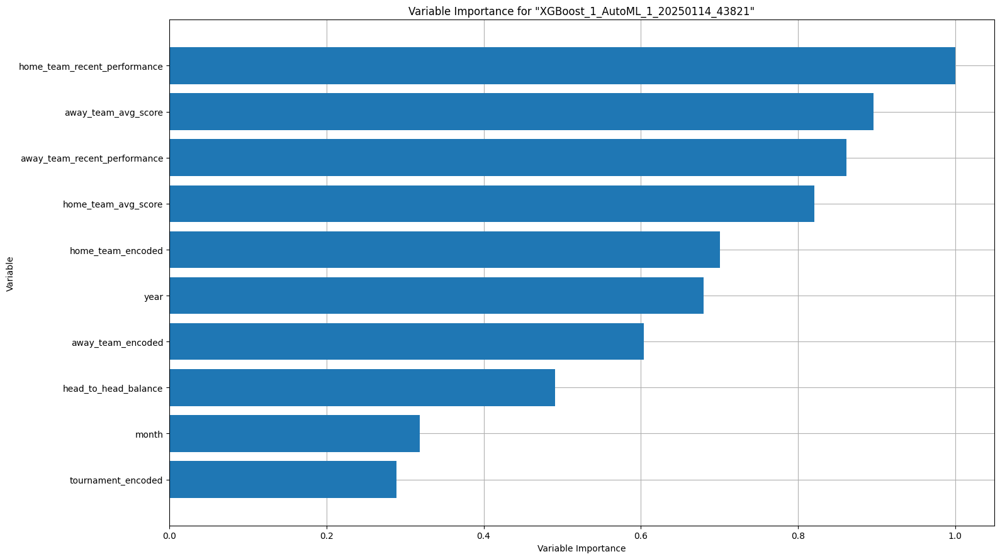

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

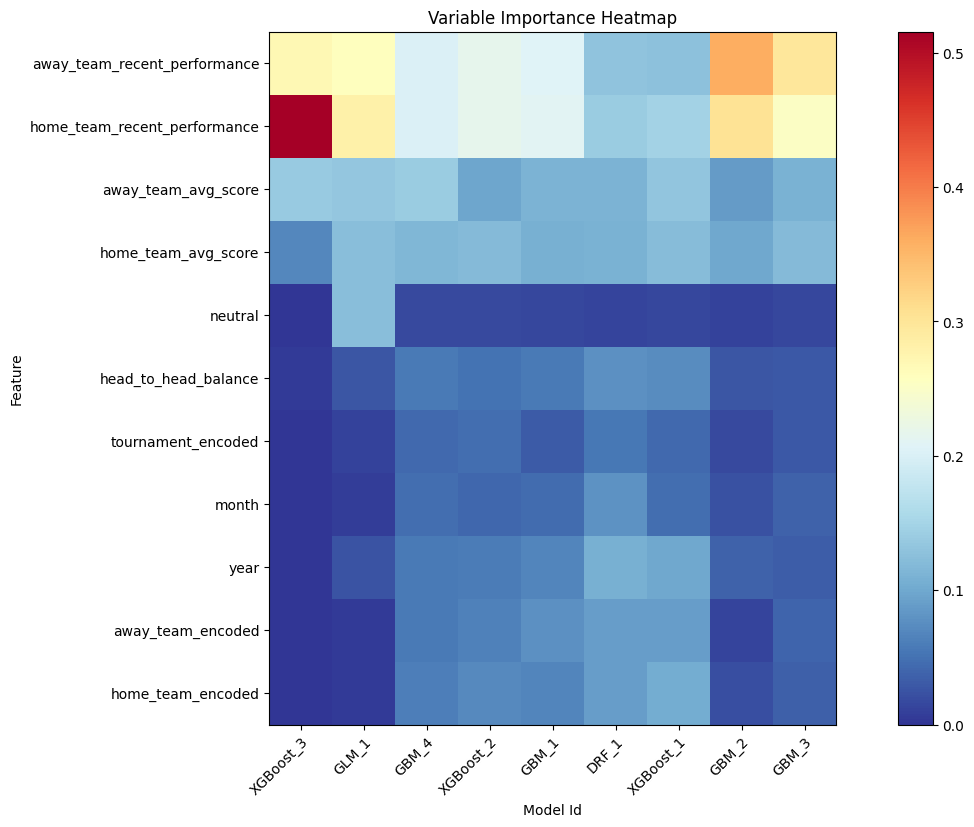

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

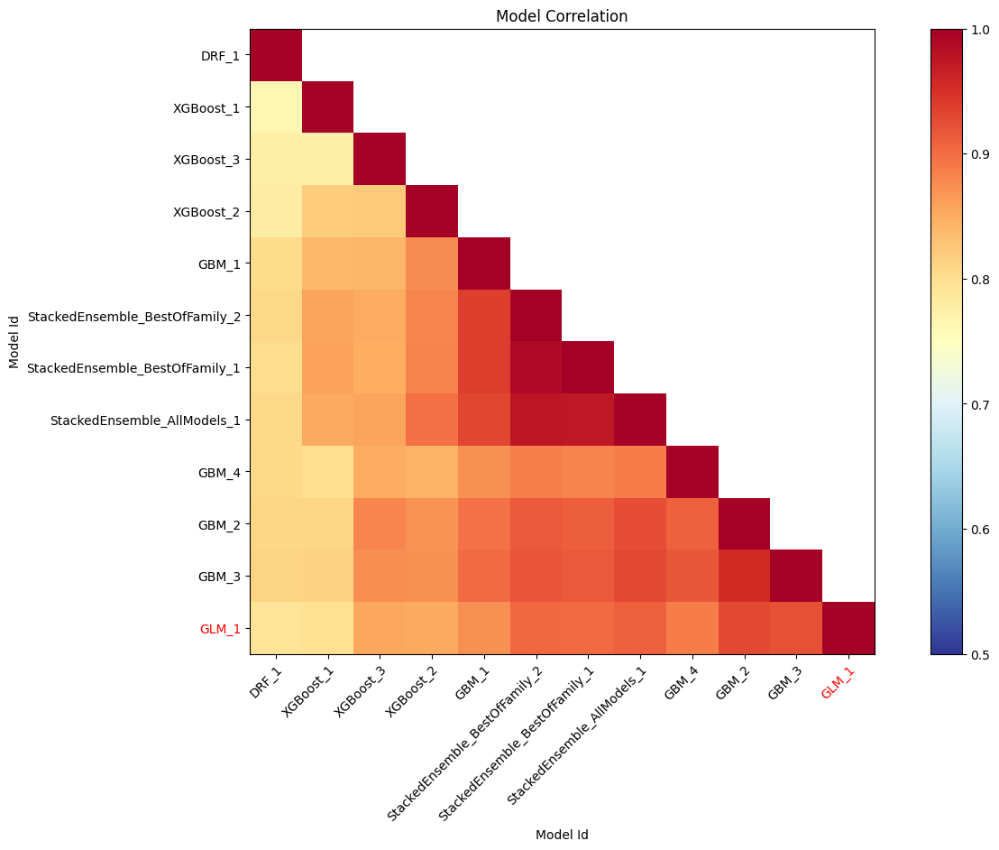

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

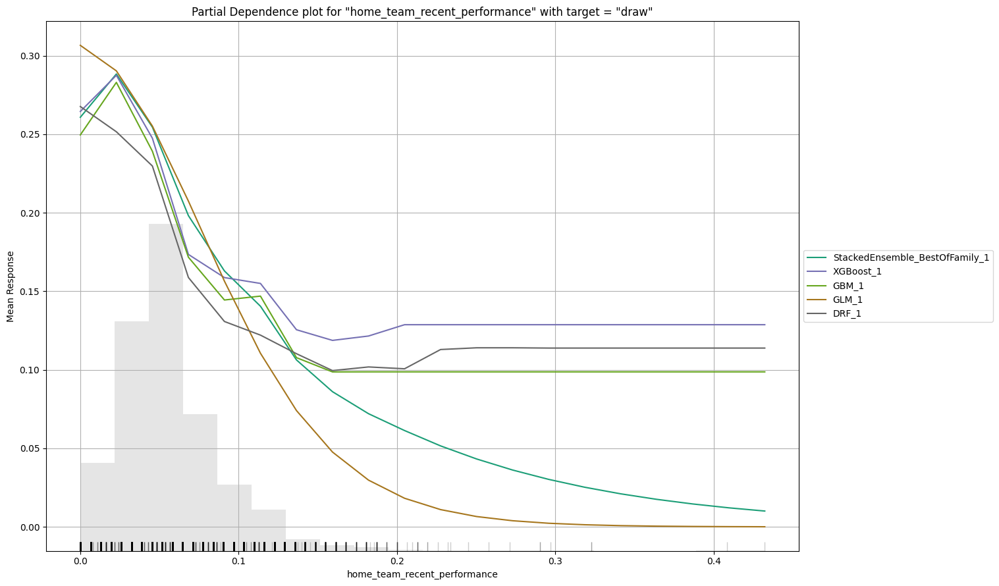

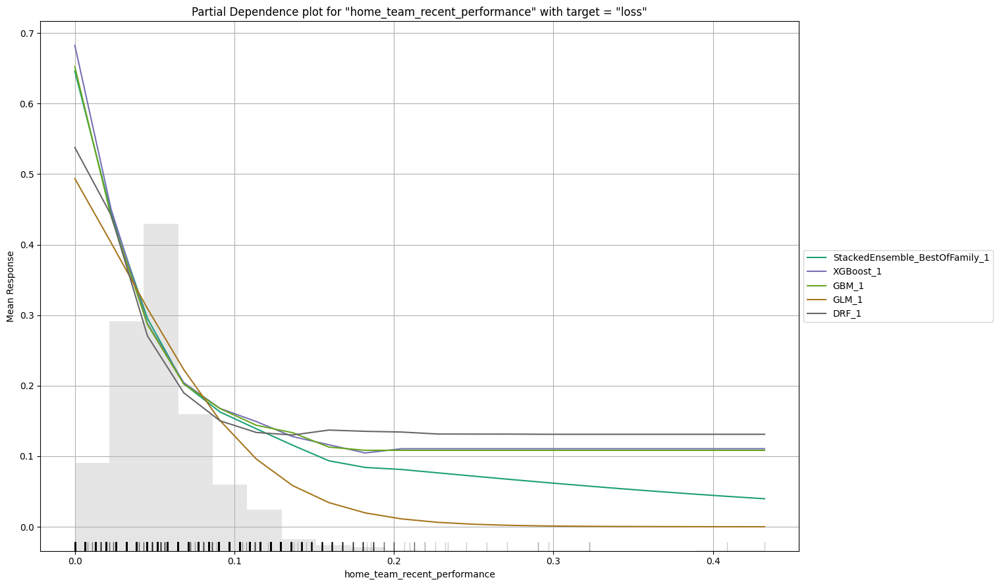

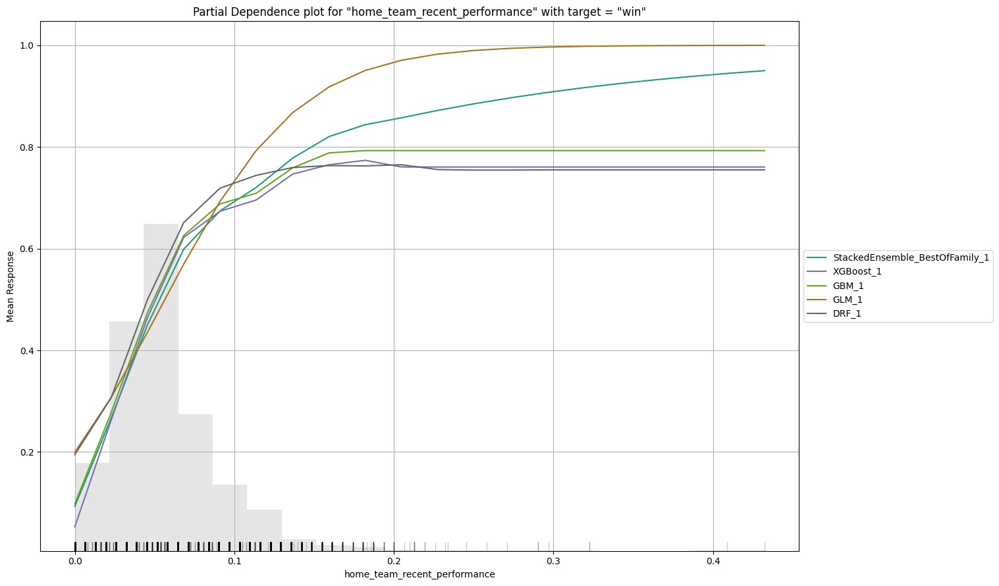

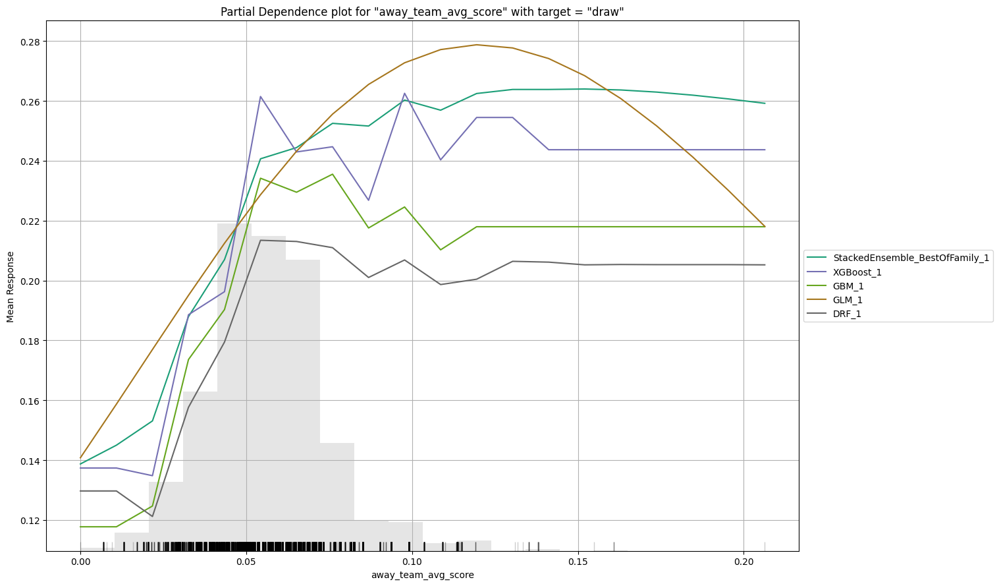

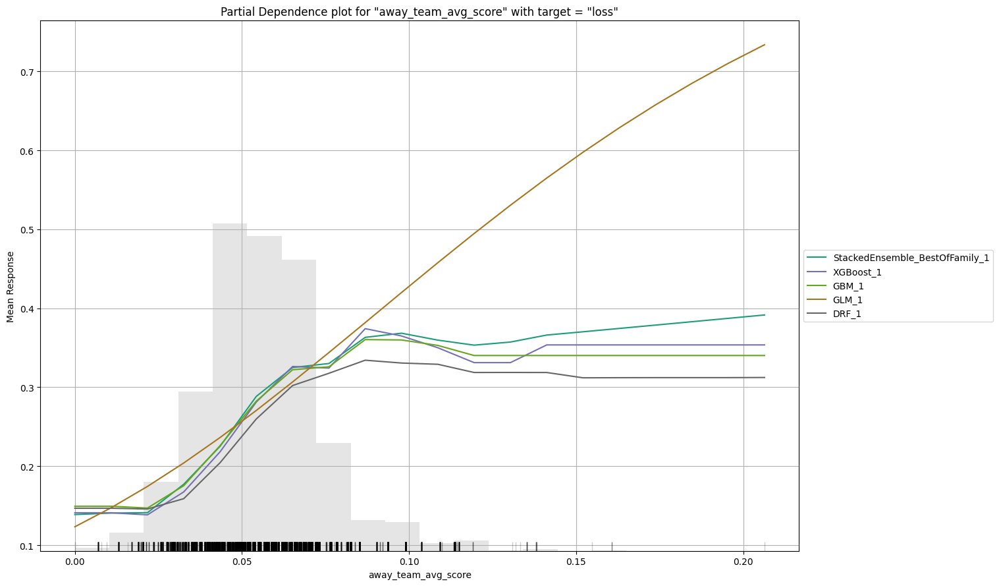

...

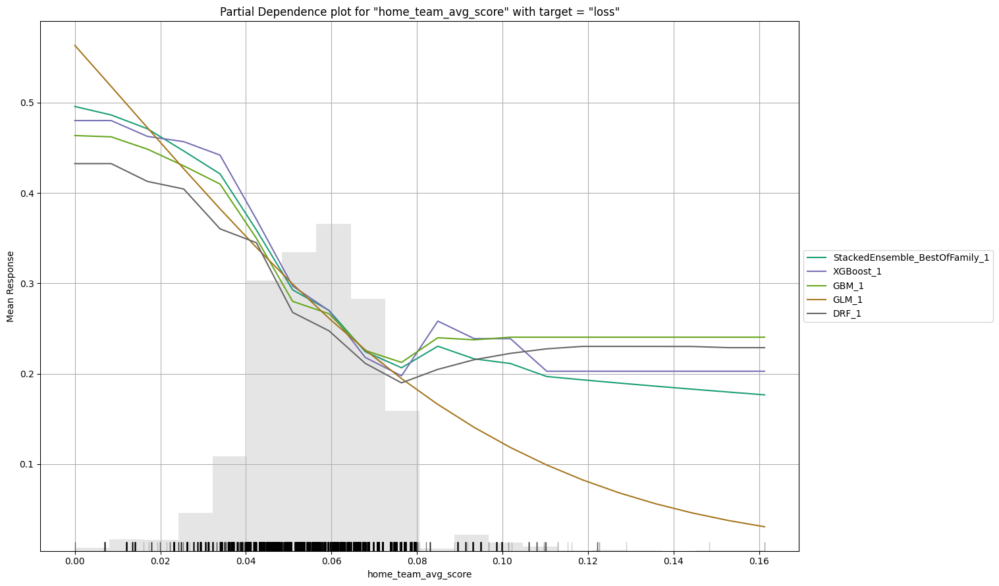

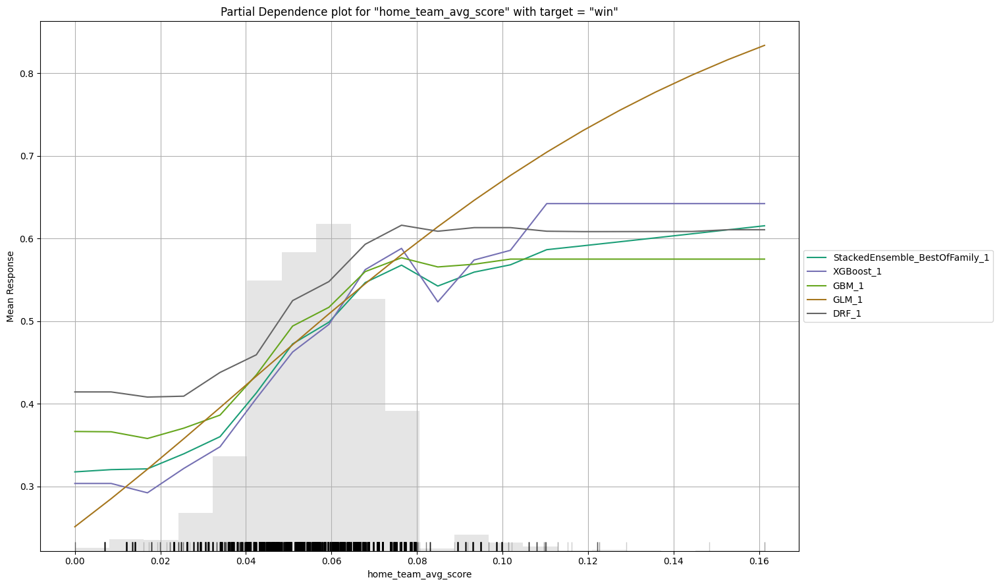

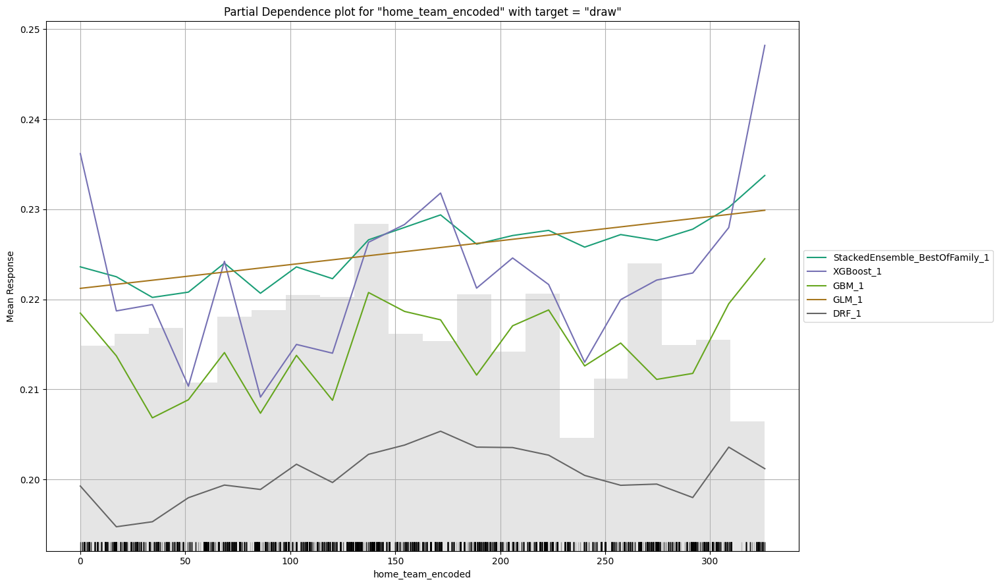

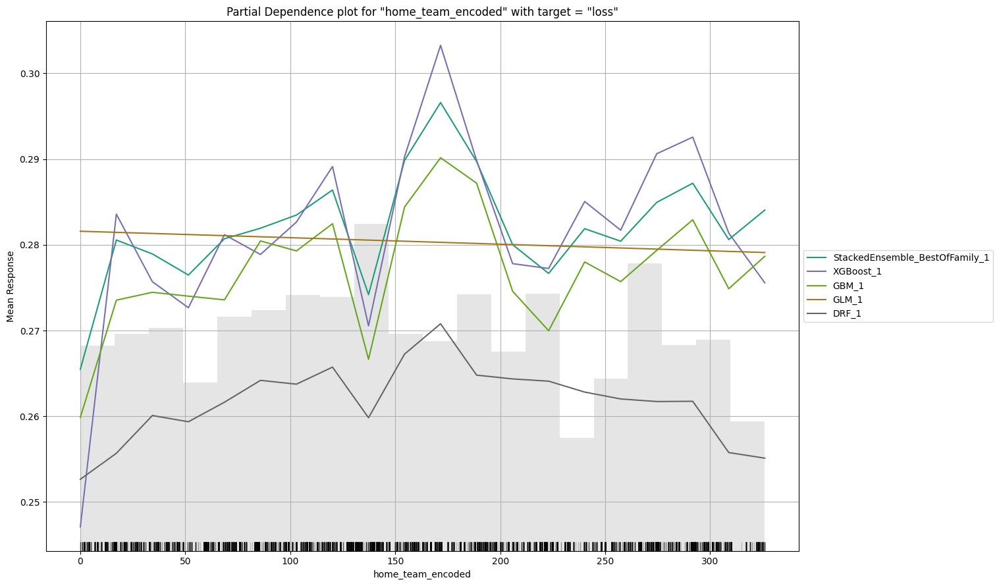

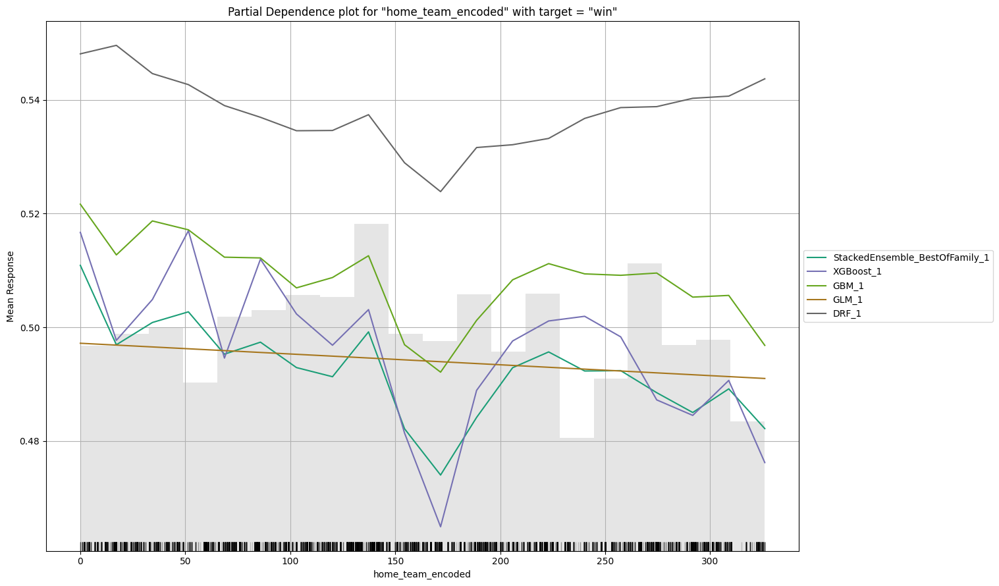

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,mean_per_class_error,logloss,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
StackedEnsemble_AllModels_1_AutoML_1_20250114_43821,0.480562,0.855929,0.56031,0.313948,29104,0.131792,StackedEnsemble
StackedEnsemble_BestOfFamily_1_AutoML_1_20250114_43821,0.481102,0.856818,0.560267,0.313899,17820,0.062404,StackedEnsemble
XGBoost_1_AutoML_1_20250114_43821,0.481523,0.895971,0.565733,0.320054,23538,0.015122,XGBoost
XGBoost_2_AutoML_1_20250114_43821,0.481965,0.870917,0.562993,0.316961,5599,0.006584,XGBoost
GBM_1_AutoML_1_20250114_43821,0.483091,0.868225,0.562171,0.316037,14322,0.045704,GBM
StackedEnsemble_BestOfFamily_2_AutoML_1_20250114_43821,0.483902,0.857286,0.560778,0.314472,17995,0.078744,StackedEnsemble
GLM_1_AutoML_1_20250114_43821,0.49411,0.881599,0.567748,0.322337,13791,0.000651,GLM
GBM_2_AutoML_1_20250114_43821,0.494597,0.872031,0.568354,0.323026,3509,0.015326,GBM
GBM_3_AutoML_1_20250114_43821,0.494824,0.874443,0.569392,0.324208,3698,0.01678,GBM
XGBoost_3_AutoML_1_20250114_43821,0.498618,1.01685,0.63669,0.405374,626,0.000732,XGBoost


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## StackedEnsemble_BestOfFamily_1_AutoML_1_20250114_43821

draw,loss,win,Error,Rate
150.0,715.0,1361.0,0.9326146,"2,076 / 2,226"
101.0,1739.0,911.0,0.3678662,"1,012 / 2,751"
102.0,549.0,3907.0,0.1428258,"651 / 4,558"
353.0,3003.0,6179.0,0.3921342,"3,739 / 9,535"


# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

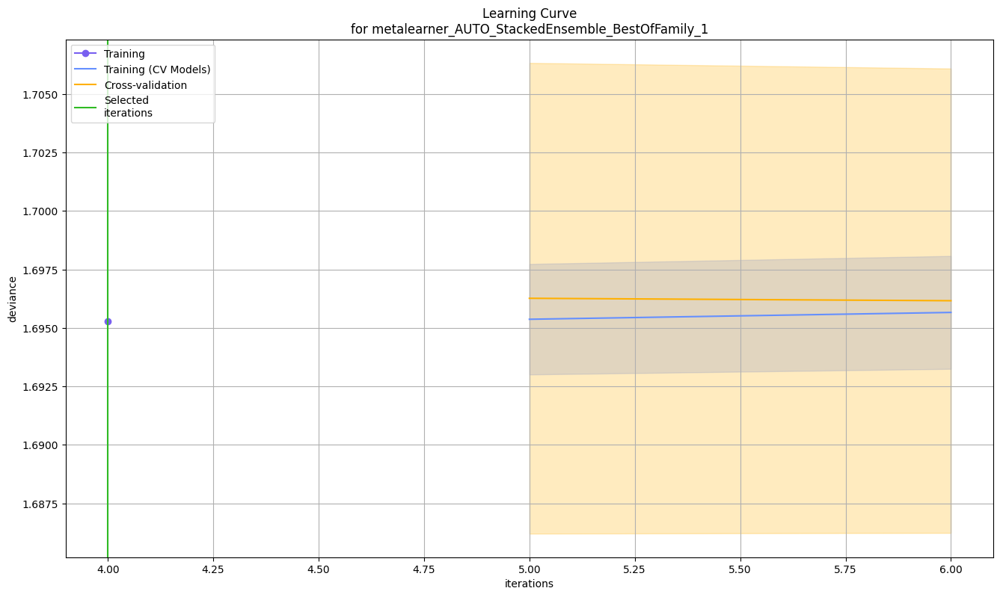

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

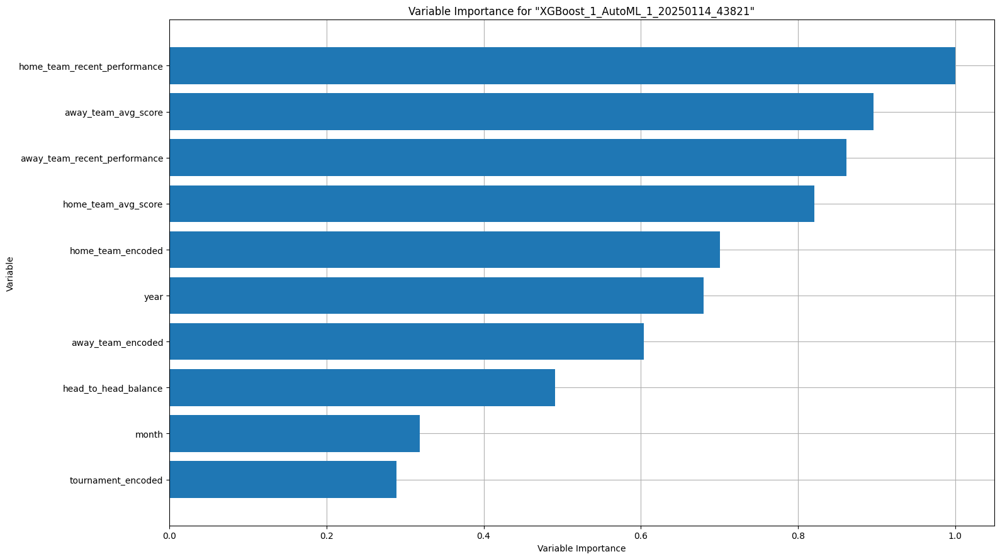

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

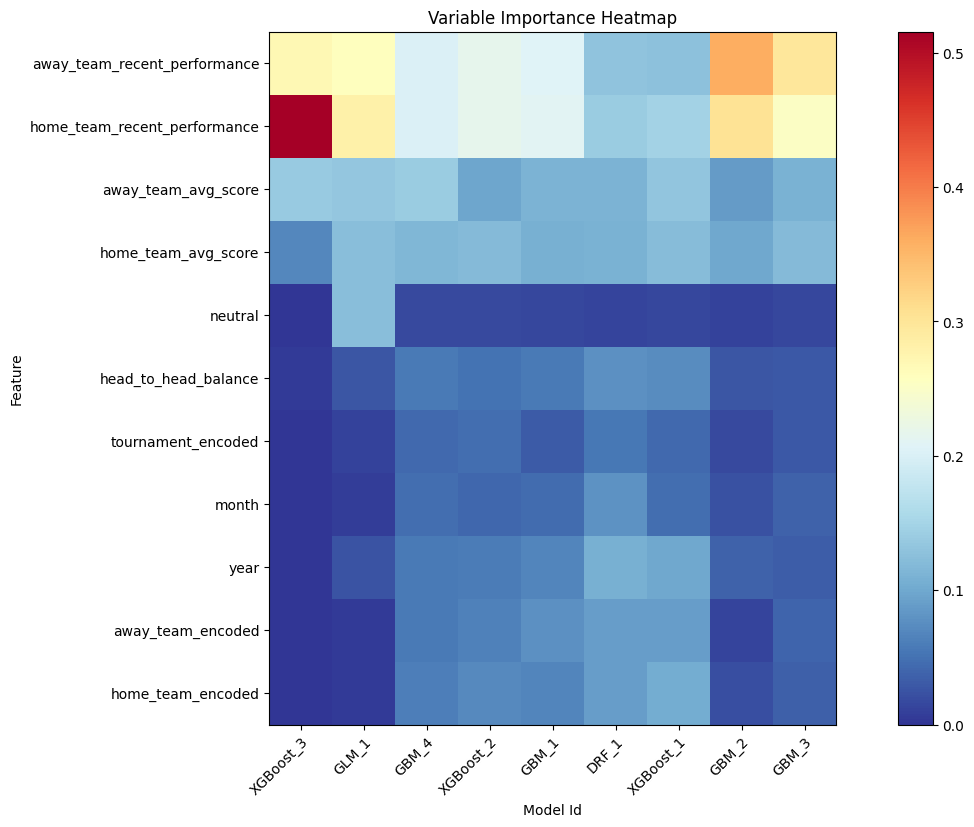

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

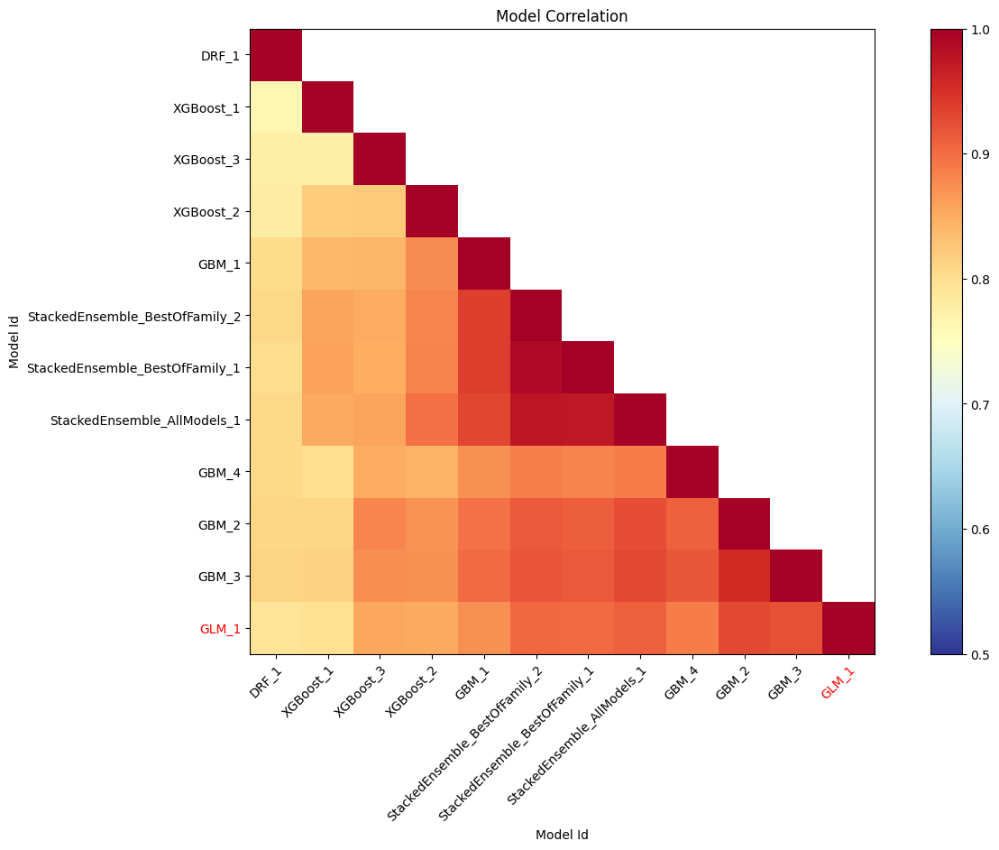

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

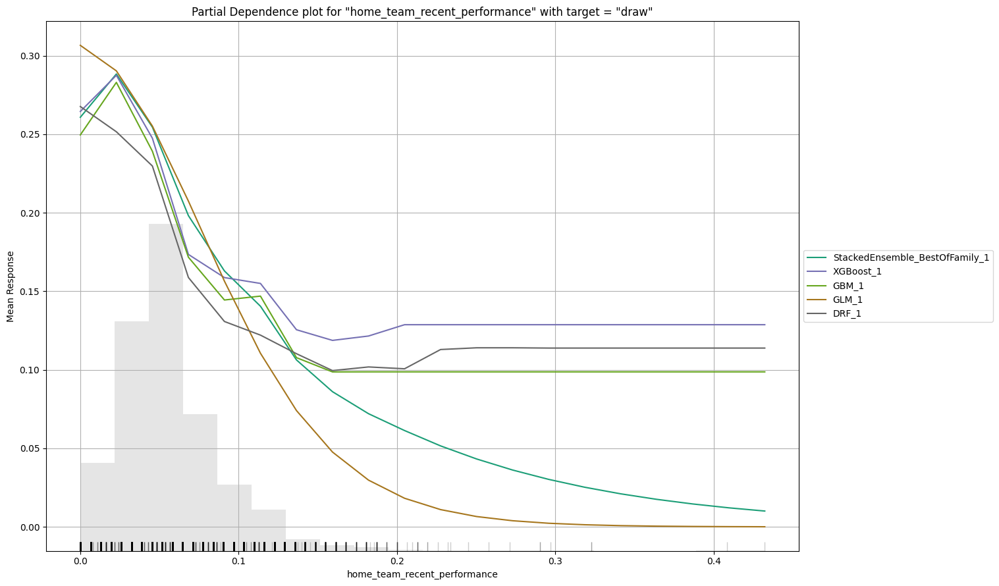

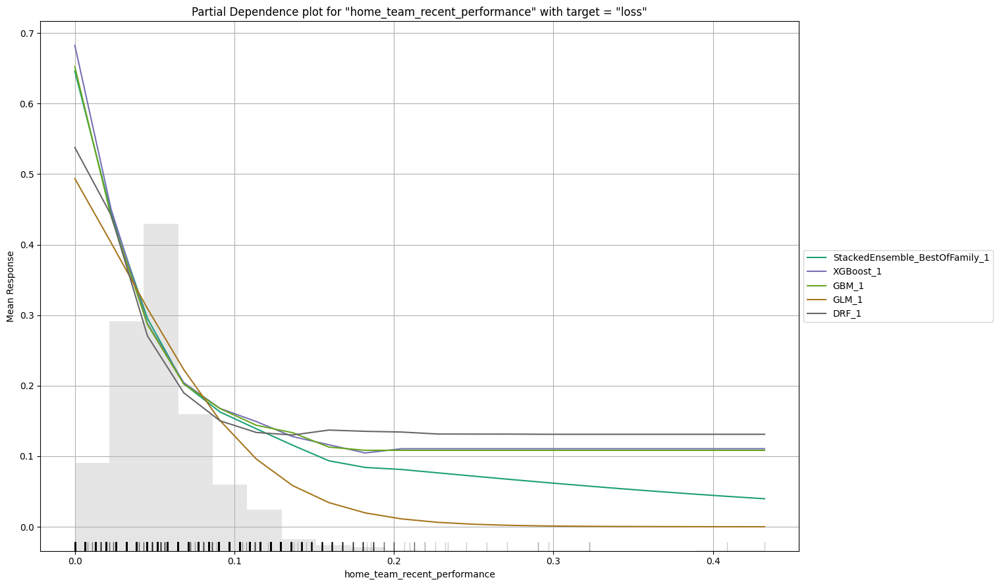

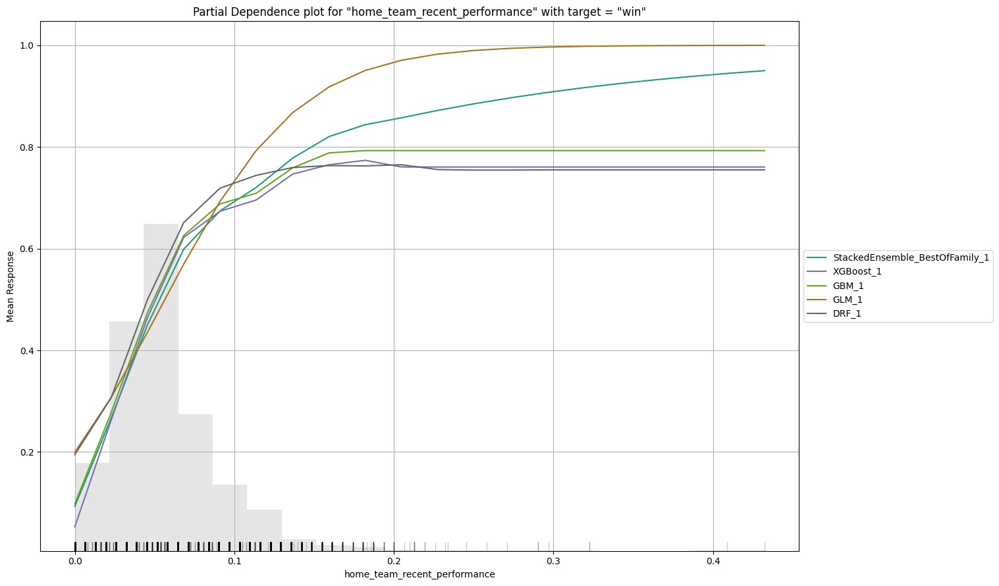

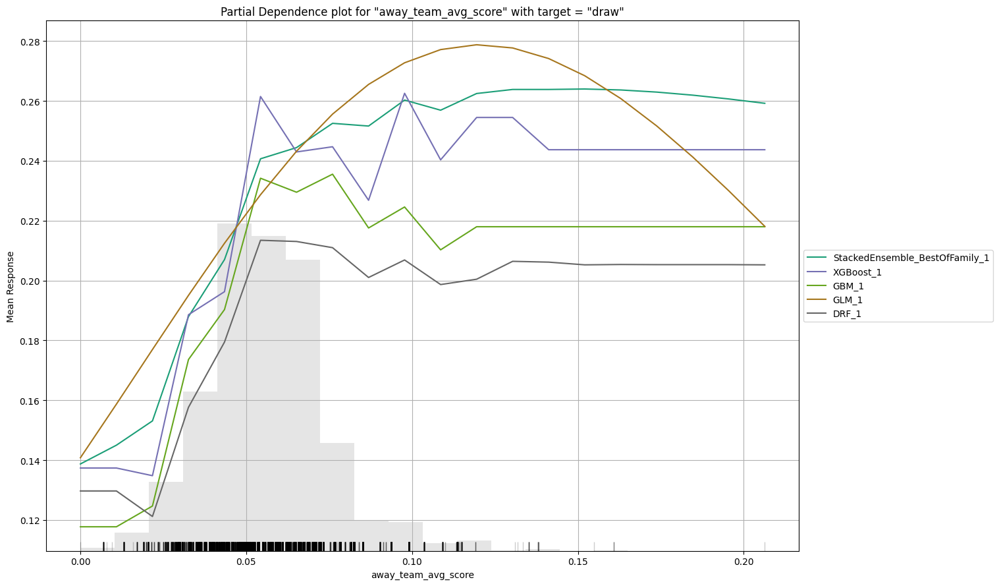

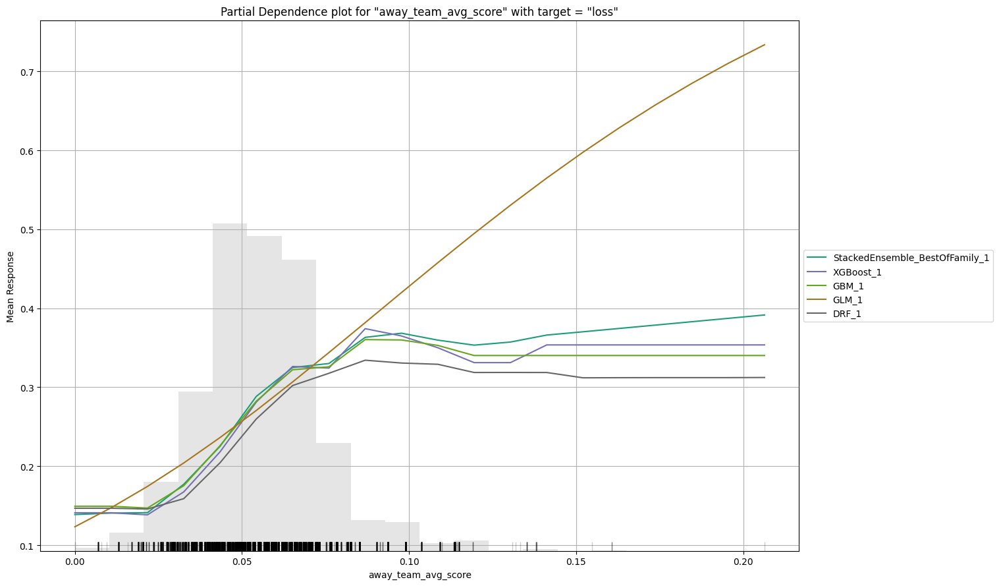

...

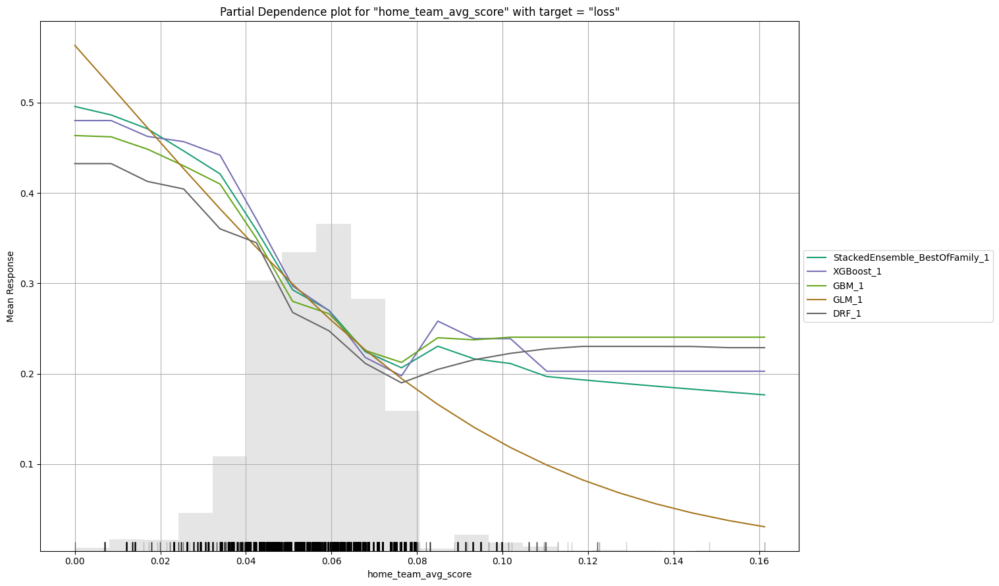

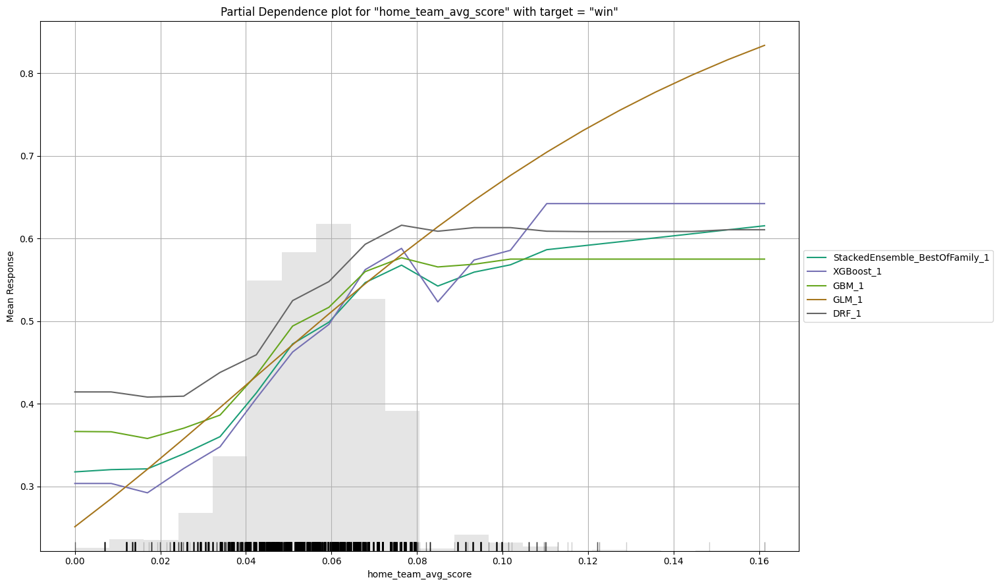

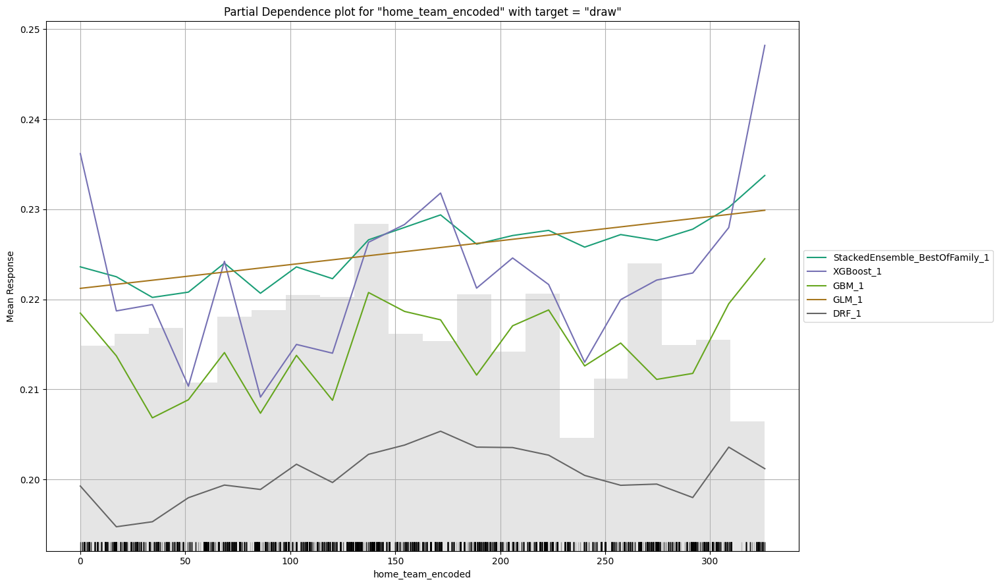

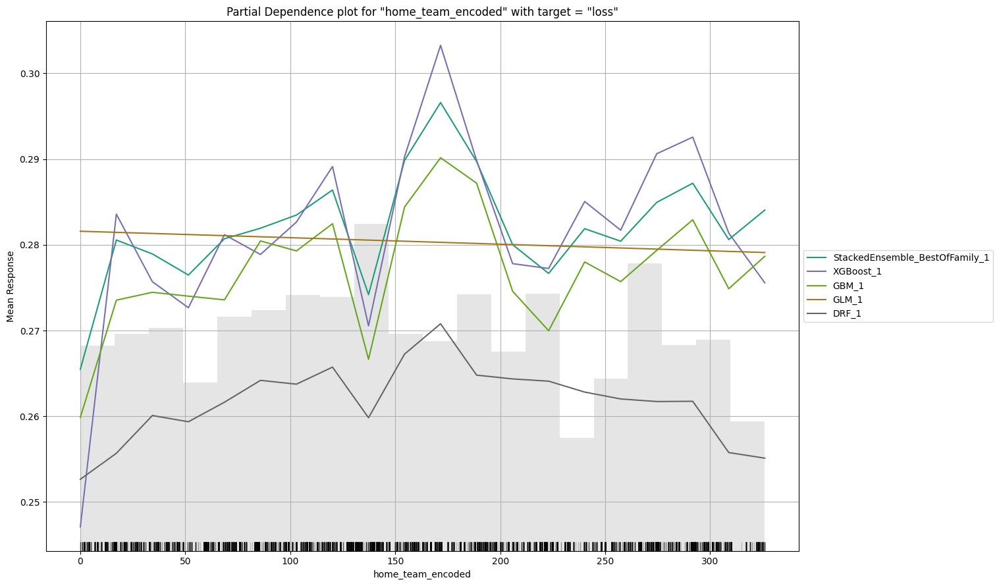

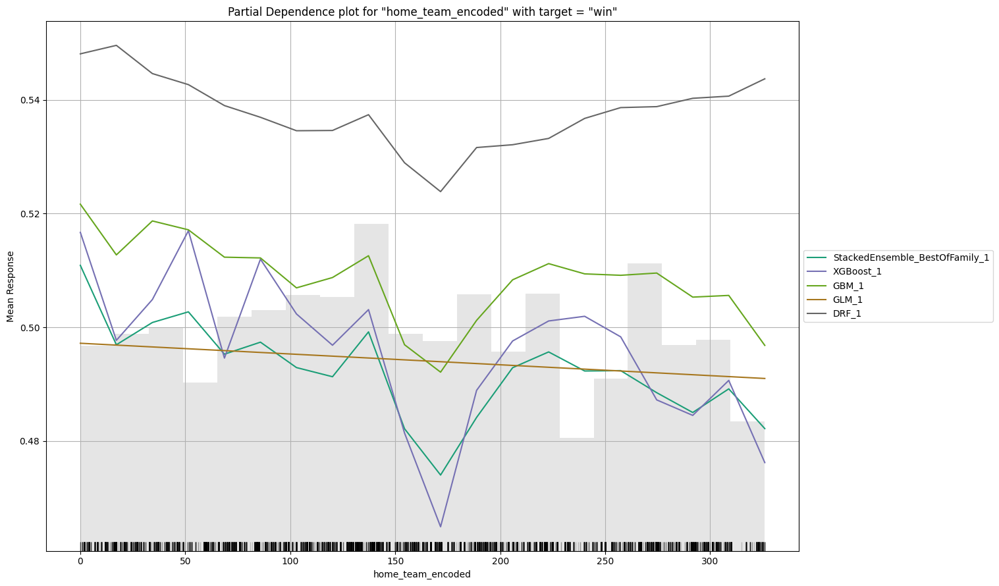

In [ ]:
aml.explain(frame=test)

In [ ]:
print_metric()

stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install polars and pyarrow and use it as pandas_df = h2o_df.as_data_frame(use_multi_thread=True)

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"
/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install polars and pyarrow and use it as pandas_df = h2o_df.as_data_frame(use_multi_thread=True)

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"
/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install polars and pyarrow a

Accuracy: 0.6078657577346618
F1-score: 0.5494414706730313
Precision: 0.5685368831168686
Recall: 0.6078657577346618
ROC-AUC: 0.7669083386301635
Confusion Matrix:
 [[ 150  715 1361]
 [ 101 1739  911]
 [ 102  549 3907]]
              precision    recall  f1-score   support

        draw       0.42      0.07      0.12      2226
        loss       0.58      0.63      0.60      2751
         win       0.63      0.86      0.73      4558

    accuracy                           0.61      9535
   macro avg       0.55      0.52      0.48      9535
weighted avg       0.57      0.61      0.55      9535



## TPOT

In [ ]:
target = 'match_result'
X = data.drop(columns=[target])
y = data[target]

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
from sklearn.model_selection import StratifiedKFold

In [ ]:
tpot = TPOTClassifier(
        generations=5,
        population_size=25,
        verbosity=3,
        random_state=42,
        n_jobs=-1,
        max_time_mins=60,
        scoring='balanced_accuracy',
        cv=StratifiedKFold(n_splits=5),
        warm_start=True
    )

In [ ]:
# Запуск обучения
tpot.fit(X_train, y_train)

32 operators have been imported by TPOT.


Optimization Progress:   0%|          | 0/25 [00:00<?, ?pipeline/s]

_pre_test decorator: _random_mutation_operator: num_test=0 The 'loss' parameter of SGDClassifier must be a str among {'squared_hinge', 'huber', 'epsilon_insensitive', 'hinge', 'squared_error', 'log_loss', 'squared_epsilon_insensitive', 'perceptron', 'modified_huber'}. Got 'log' instead..
_pre_test decorator: _random_mutation_operator: num_test=0 could not convert string to float: 'win'.
_pre_test decorator: _random_mutation_operator: num_test=0 could not convert string to float: 'win'.
_pre_test decorator: _random_mutation_operator: num_test=0 The 'loss' parameter of SGDClassifier must be a str among {'squared_hinge', 'huber', 'epsilon_insensitive', 'hinge', 'squared_error', 'log_loss', 'squared_epsilon_insensitive', 'perceptron', 'modified_huber'}. Got 'log' instead..
_pre_test decorator: _random_mutation_operator: num_test=0 could not convert string to float: 'win'.
_pre_test decorator: _random_mutation_operator: num_test=0 Negative values in data passed to MultinomialNB (input X).
_

TPOTClassifier(cv=StratifiedKFold(n_splits=5, random_state=None, shuffle=False),
               generations=5, max_time_mins=60, n_jobs=-1, population_size=25,
               random_state=42, scoring='balanced_accuracy', verbosity=3,
               warm_start=True)

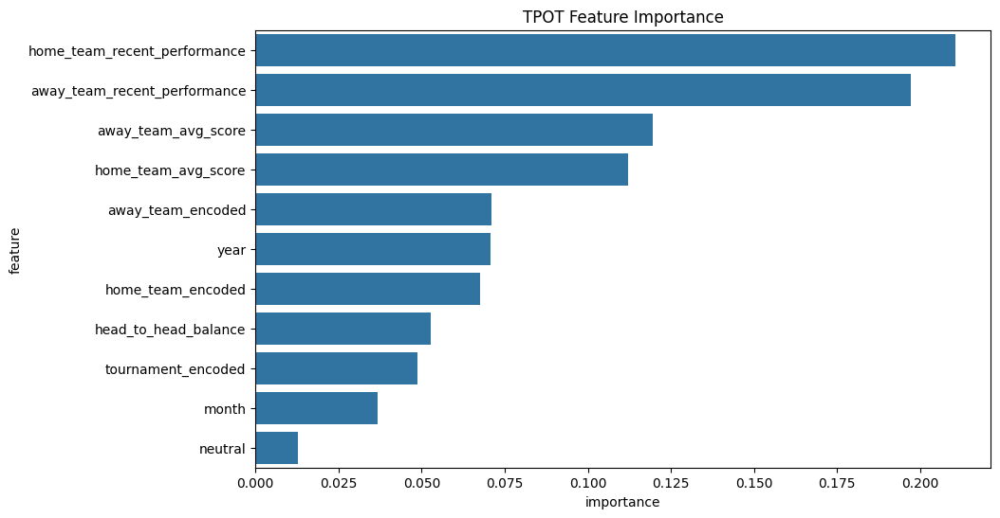

In [ ]:
if hasattr(tpot.fitted_pipeline_, 'transform'):
    transformed_X_train = tpot.fitted_pipeline_.transform(X_train)
    print("Features после трансформации(TPOT):", transformed_X_train.shape)
if hasattr(tpot.fitted_pipeline_.steps[-1][1], 'feature_importances_'):
    importances = tpot.fitted_pipeline_.steps[-1][1].feature_importances_
    feature_names = X_train.columns
    feature_importance_df = pd.DataFrame({'feature': feature_names, 'importance': importances})
    feature_importance_df = feature_importance_df.sort_values(by=['importance'], ascending=False)

    # Визуализация
    plt.figure(figsize=(10, 6))
    sns.barplot(x='importance', y='feature', data=feature_importance_df)
    plt.title('TPOT Feature Importance')
    plt.show()

In [ ]:
y_pred = tpot.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
cm = confusion_matrix(y_test, y_pred)

print(f"Accuracy: {accuracy}")
print(f"F1-score: {f1}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print("Confusion Matrix:\n", cm)
print(classification_report(y_test, y_pred))

Accuracy: 0.6064273789649416
F1-score: 0.5707056145463786
Precision: 0.568675874436628
Recall: 0.6064273789649416
Confusion Matrix:
 [[ 318  658 1208]
 [ 248 1598  844]
 [ 272  542 3896]]
              precision    recall  f1-score   support

        draw       0.38      0.15      0.21      2184
        loss       0.57      0.59      0.58      2690
         win       0.66      0.83      0.73      4710

    accuracy                           0.61      9584
   macro avg       0.54      0.52      0.51      9584
weighted avg       0.57      0.61      0.57      9584



## AutoGluon

In [ ]:
!pip install autogluon.tabular[all]
from autogluon.tabular import TabularPredictor

In [ ]:
target = 'match_result'
features = data.drop(columns=['match_result'])
data.dropna(subset=[target], inplace=True)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(
    features, data[target], test_size=0.2, random_state=42)

In [ ]:
# Объединяем X и y для AutoGluon (он требует один датафрейм)
train_data = pd.concat([X_train, y_train.reset_index(drop=True)], axis=1)
test_data = pd.concat([X_test, y_test.reset_index(drop=True)], axis=1)

In [ ]:
# Инициализируем AutoGluon
predictor = TabularPredictor(label=target, problem_type='multiclass', eval_metric='f1_weighted')

No path specified. Models will be saved in: "AutogluonModels/ag-20250114_062452"


In [ ]:
train_data.dropna(subset=[target], inplace=True)
test_data.dropna(subset=[target], inplace=True)

In [ ]:
train_data.head()

,neutral,home_team_encoded,away_team_encoded,year,month,home_team_avg_score,away_team_avg_score,home_team_recent_performance,away_team_recent_performance,head_to_head_balance,tournament_encoded,match_result
13920,False,147.0,166.0,1983.0,11.0,0.052890,0.044052,0.045161,0.019048,20.0,28.0,loss
96,False,250.0,89.0,1894.0,4.0,0.061195,0.098969,0.129032,0.142857,59.0,25.0,win
30214,False,47.0,141.0,2006.0,9.0,0.048871,0.050157,0.032258,0.028571,10.0,85.0,win
22584,False,16.0,142.0,1998.0,2.0,0.075235,0.078503,0.019355,0.066667,14.0,85.0,loss
4913,True,133.0,138.0,1959.0,12.0,0.067932,0.059691,0.051613,0.038095,3.0,2.0,win


In [ ]:
predictor.fit(
    train_data=train_data,
    time_limit=3600,  # Время выполнения (1 час)
    presets='good_quality_faster_inference_only_refit'  # Акцент на качество
)

Preset alias specified: 'good_quality_faster_inference_only_refit' maps to 'good_quality'.
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.2
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       9.60 GB / 12.67 GB (75.7%)
Disk Space Avail:   73.29 GB / 107.72 GB (68.0%)
Presets specified: ['good_quality_faster_inference_only_refit']
Setting dynamic_stacking from 'auto' to True. Reason: Enable dynamic_stacking when use_bag_holdout is disabled. (use_bag_holdout=False)
Stack configuration (auto_stack=True): num_stack_levels=1, num_bag_folds=8, num_bag_sets=1
Note: `save_bag_folds=False`! This will greatly reduce peak disk usage during fit (by ~8x), but runs the risk of an out-of-memory error during model refit if memory is small relative to the data size.
	You can avoid this risk by setting `s

(_ray_fit pid=31141) [1000]	valid_set's multi_logloss: 1.06768	valid_set's f1_weighted: 0.347865


(_ray_fit pid=31141) 	Ran out of time, early stopping on iteration 1883. Best iteration is:
(_ray_fit pid=31141) 	[1857]	valid_set's multi_logloss: 1.08514	valid_set's f1_weighted: 0.361147
(_ray_fit pid=31142) /usr/local/lib/python3.10/dist-packages/dask/dataframe/__init__.py:42: FutureWarning: 
(_ray_fit pid=31142) Dask dataframe query planning is disabled because dask-expr is not installed.
(_ray_fit pid=31142) You can install it with `pip install dask[dataframe]` or `conda install dask`.
(_ray_fit pid=31142) This will raise in a future version.
(_ray_fit pid=31142)   warnings.warn(msg, FutureWarning)
(_ray_fit pid=31543) /usr/local/lib/python3.10/dist-packages/dask/dataframe/__init__.py:42: FutureWarning: 
(_ray_fit pid=31543) Dask dataframe query planning is disabled because dask-expr is not installed.
(_ray_fit pid=31543) 
(_ray_fit pid=31543) You can install it with `pip install dask[dataframe]` or `conda install dask`.
(_ray_fit pid=31543) This will raise in a future version.
(

(_ray_fit pid=31543) [1000]	valid_set's multi_logloss: 1.06392	valid_set's f1_weighted: 0.347292 [repeated 2x across cluster]


(_ray_fit pid=31543) 	Ran out of time, early stopping on iteration 1844. Best iteration is:
(_ray_fit pid=31543) 	[1412]	valid_set's multi_logloss: 1.0719	valid_set's f1_weighted: 0.351951
(_ray_fit pid=31544) /usr/local/lib/python3.10/dist-packages/dask/dataframe/__init__.py:42: FutureWarning: 
(_ray_fit pid=31544) Dask dataframe query planning is disabled because dask-expr is not installed.
(_ray_fit pid=31544) You can install it with `pip install dask[dataframe]` or `conda install dask`.
(_ray_fit pid=31544) This will raise in a future version.
(_ray_fit pid=31544)   warnings.warn(msg, FutureWarning)
(_ray_fit pid=31895) /usr/local/lib/python3.10/dist-packages/dask/dataframe/__init__.py:42: FutureWarning: 
(_ray_fit pid=31895) Dask dataframe query planning is disabled because dask-expr is not installed.
(_ray_fit pid=31895) 
(_ray_fit pid=31895) You can install it with `pip install dask[dataframe]` or `conda install dask`.
(_ray_fit pid=31895) This will raise in a future version.
(_

(_ray_fit pid=31895) [1000]	valid_set's multi_logloss: 1.07065	valid_set's f1_weighted: 0.351004 [repeated 2x across cluster]


(_ray_fit pid=31895) 	Ran out of time, early stopping on iteration 1839. Best iteration is:
(_ray_fit pid=31895) 	[1776]	valid_set's multi_logloss: 1.08825	valid_set's f1_weighted: 0.359553
(_ray_fit pid=31950) /usr/local/lib/python3.10/dist-packages/dask/dataframe/__init__.py:42: FutureWarning: 
(_ray_fit pid=31950) Dask dataframe query planning is disabled because dask-expr is not installed.
(_ray_fit pid=31950) You can install it with `pip install dask[dataframe]` or `conda install dask`.
(_ray_fit pid=31950) This will raise in a future version.
(_ray_fit pid=31950)   warnings.warn(msg, FutureWarning)
(_ray_fit pid=32280) /usr/local/lib/python3.10/dist-packages/dask/dataframe/__init__.py:42: FutureWarning: 
(_ray_fit pid=32280) Dask dataframe query planning is disabled because dask-expr is not installed.
(_ray_fit pid=32280) 
(_ray_fit pid=32280) You can install it with `pip install dask[dataframe]` or `conda install dask`.
(_ray_fit pid=32280) This will raise in a future version.
(

(_ray_fit pid=32280) [1000]	valid_set's multi_logloss: 1.06324	valid_set's f1_weighted: 0.34968 [repeated 2x across cluster]


(_ray_fit pid=32280) 	Ran out of time, early stopping on iteration 1841. Best iteration is:
(_ray_fit pid=32280) 	[1813]	valid_set's multi_logloss: 1.07862	valid_set's f1_weighted: 0.366567
(_ray_fit pid=32322) /usr/local/lib/python3.10/dist-packages/dask/dataframe/__init__.py:42: FutureWarning: 
(_ray_fit pid=32322) Dask dataframe query planning is disabled because dask-expr is not installed.
(_ray_fit pid=32322) You can install it with `pip install dask[dataframe]` or `conda install dask`.
(_ray_fit pid=32322) This will raise in a future version.
(_ray_fit pid=32322)   warnings.warn(msg, FutureWarning)
(_dystack pid=29383) 	0.3609	 = Validation score   (f1_weighted)
(_dystack pid=29383) 	291.65s	 = Training   runtime
(_dystack pid=29383) 	71.19s	 = Validation runtime
(_dystack pid=29383) Fitting model: WeightedEnsemble_L2 ... Training model for up to 360.00s of the 286.48s of remaining time.
(_ray_fit pid=32322) 	Ran out of time, early stopping on iteration 1885. Best iteration is:
(

In [ ]:
# Оценка на тестовом наборе
performance = predictor.evaluate(test_data)
print(performance)

{'f1_weighted': 0.34156783254863005, 'accuracy': 0.4761060100166945, 'balanced_accuracy': 0.3310316710075193, 'mcc': -0.008461680015891702}


In [ ]:
!pip install dask[dataframe]

INFO: pip is looking at multiple versions of dask-expr to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 243.2/243.2 kB 6.4 MB/s eta 0:00:00


In [ ]:
# Важность признаков
feature_importances = predictor.feature_importance(test_data)
print("Feature Importances:\n", feature_importances)

Computing feature importance via permutation shuffling for 11 features using 5000 rows with 5 shuffle sets...
	217.07s	= Expected runtime (43.41s per shuffle set)
	230.11s	= Actual runtime (Completed 5 of 5 shuffle sets)


Feature Importances:
                               importance    stddev   p_value  n  p99_high  \
away_team_avg_score             0.004575  0.001668  0.001793  5  0.008011   
neutral                         0.002059  0.000693  0.001331  5  0.003485   
year                           -0.000855  0.002704  0.740647  5  0.004712   
month                          -0.001270  0.002901  0.808526  5  0.004703   
away_team_encoded              -0.003386  0.002770  0.973863  5  0.002318   
away_team_recent_performance   -0.003658  0.001692  0.995782  5 -0.000174   
home_team_encoded              -0.007784  0.003289  0.996941  5 -0.001013   
head_to_head_balance           -0.007875  0.003686  0.995602  5 -0.000285   
tournament_encoded             -0.009216  0.003675  0.997515  5 -0.001648   
home_team_recent_performance   -0.011187  0.000942  0.999994  5 -0.009247   
home_team_avg_score            -0.014204  0.002377  0.999909  5 -0.009310   

                               p99_low  
away_team_av

In [ ]:
predictor.leaderboard(test_data, extra_info=True)

,model,score_test,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,...,hyperparameters,hyperparameters_fit,ag_args_fit,features,compile_time,child_hyperparameters,child_hyperparameters_fit,child_ag_args_fit,ancestors,descendants
0,LightGBMXT_BAG_L1_FULL,0.342331,NaN,f1_weighted,31.856062,NaN,55.117429,31.856062,NaN,55.117429,...,"{'use_orig_features': True, 'valid_stacker': True, 'max_base_models': 0, 'max_base_models_per_type': 'auto', 'save_bag_folds': True}",{},"{'max_memory_usage_ratio': 1.15, 'max_time_limit_ratio': 1.0, 'max_time_limit': None, 'min_time_limit': 0, 'valid_raw_types': None, 'valid_special_types': None, 'ignored_type_group_special': None, 'ignored_type_group_raw': None, 'get_features_kwargs': None, 'get_features_kwargs_extra': None, 'predict_1_batch_size': None, 'temperature_scalar': None, 'drop_unique': False}","[month, home_team_recent_performance, head_to_head_balance, away_team_avg_score, home_team_avg_score, tournament_encoded, home_team_encoded, away_team_encoded, neutral, away_team_recent_performance, year]",None,"{'learning_rate': 0.05, 'extra_trees': True, 'num_boost_round': 4293}",{'num_boost_round': 4293},"{'max_memory_usage_ratio': 1.0, 'max_time_limit_ratio': 1.0, 'max_time_limit': None, 'min_time_limit': 0, 'valid_raw_types': ['bool', 'int', 'float', 'category'], 'valid_special_types': None, 'ignored_type_group_special': None, 'ignored_type_group_raw': None, 'get_features_kwargs': None, 'get_features_kwargs_extra': None, 'predict_1_batch_size': None, 'temperature_scalar': None}",[],"[LightGBM_BAG_L2_FULL, NeuralNetFastAI_BAG_L2_FULL, LightGBMXT_BAG_L2_FULL]"
1,LightGBM_BAG_L1_FULL,0.341568,NaN,f1_weighted,9.243648,NaN,29.669572,9.243648,NaN,29.669572,...,"{'use_orig_features': True, 'valid_stacker': True, 'max_base_models': 0, 'max_base_models_per_type': 'auto', 'save_bag_folds': True}",{},"{'max_memory_usage_ratio': 1.15, 'max_time_limit_ratio': 1.0, 'max_time_limit': None, 'min_time_limit': 0, 'valid_raw_types': None, 'valid_special_types': None, 'ignored_type_group_special': None, 'ignored_type_group_raw': None, 'get_features_kwargs': None, 'get_features_kwargs_extra': None, 'predict_1_batch_size': None, 'temperature_scalar': None, 'drop_unique': False}","[month, home_team_recent_performance, head_to_head_balance, away_team_avg_score, home_team_avg_score, tournament_encoded, home_team_encoded, away_team_encoded, neutral, away_team_recent_performance, year]",None,"{'learning_rate': 0.05, 'num_boost_round': 2396}",{'num_boost_round': 2396},"{'max_memory_usage_ratio': 1.0, 'max_time_limit_ratio': 1.0, 'max_time_limit': None, 'min_time_limit': 0, 'valid_raw_types': ['bool', 'int', 'float', 'category'], 'valid_special_types': None, 'ignored_type_group_special': None, 'ignored_type_group_raw': None, 'get_features_kwargs': None, 'get_features_kwargs_extra': None, 'predict_1_batch_size': None, 'temperature_scalar': None}",[],"[LightGBM_BAG_L2_FULL, NeuralNetFastAI_BAG_L2_FULL, WeightedEnsemble_L2_FULL, LightGBMXT_BAG_L2_FULL, WeightedEnsemble_L3_FULL]"
2,WeightedEnsemble_L3_FULL,0.341568,NaN,f1_weighted,9.246283,NaN,36.647710,0.002635,NaN,6.978138,...,"{'use_orig_features': False, 'valid_stacker': True, 'max_base_models': 0, 'max_base_models_per_type': 'auto', 'save_bag_folds': True}",{},"{'max_memory_usage_ratio': 1.0, 'max_time_limit_ratio': 1.0, 'max_time_limit': None, 'min_time_limit': 0, 'valid_raw_types': None, 'valid_special_types': None, 'ignored_type_group_special': None, 'ignored_type_group_raw': None, 'get_features_kwargs': None, 'get_features_kwargs_extra': None, 'predict_1_batch_size': None, 'temperature_scalar': None, 'drop_unique': False}","[LightGBM_BAG_L1_0, LightGBM_BAG_L1_1, LightGBM_BAG_L1_2]",None,"{'ensemble_size': 25, 'subsample_size': 1000000}",{'ensemble_size': 1},"{'max_memory_usage_ratio': 1.0, 'max_time_limit_ratio': 1.0, 'max_time_limit': None, 'min_time_limit': 0, 'valid_raw_types': None, 'vali

In [ ]:
y_pred = predictor.predict(test_data)
y_pred_proba = predictor.predict_proba(test_data)

In [ ]:
best_model = predictor.model_best
print(best_model)
print(predictor.info())

LightGBM_BAG_L1_FULL
{'path': '/content/AutogluonModels/ag-20250114_062452', 'label': 'match_result', 'random_state': 0, 'version': '1.2', 'features': ['neutral', 'home_team_encoded', 'away_team_encoded', 'year', 'month', 'home_team_avg_score', 'away_team_avg_score', 'home_team_recent_performance', 'away_team_recent_performance', 'head_to_head_balance', 'tournament_encoded'], 'feature_metadata_in': <autogluon.common.features.feature_metadata.FeatureMetadata object at 0x7d17642743a0>, 'time_fit_preprocessing': 0.46921610832214355, 'time_fit_training': 2658.466925382614, 'time_fit_total': 2658.9361414909363, 'time_limit': 2633.6408083438873, 'time_train_start': 1736836872.849238, 'num_rows_train': 38333, 'num_cols_train': 11, 'num_rows_val': None, 'num_rows_test': None, 'num_classes': 3, 'problem_type': 'multiclass', 'eval_metric': 'f1_weighted', 'best_model': 'LightGBM_BAG_L1_FULL', 'best_model_score_val': None, 'best_model_stack_level': 1, 'num_models_trained': 24, 'num_bag_folds': 8, 

In [ ]:
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')  # Или 'macro', 'micro'
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
roc_auc = roc_auc_score(y_test, y_pred_proba, multi_class='ovr', average='weighted')

print(f"Accuracy: {accuracy}")
print(f"F1-score: {f1}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"ROC-AUC: {roc_auc}")
print(classification_report(y_test, y_pred))

Accuracy: 0.4813230383973289
F1-score: 0.34815505912634853
Precision: 0.38668758631529115
Recall: 0.4813230383973289
ROC-AUC: 0.5006677316634114
              precision    recall  f1-score   support

        draw       0.27      0.02      0.04      2184
        loss       0.30      0.04      0.07      2690
         win       0.49      0.95      0.65      4710

    accuracy                           0.48      9584
   macro avg       0.35      0.34      0.25      9584
weighted avg       0.39      0.48      0.35      9584



# Эксперимент 4

In [ ]:
data = pd.read_csv('/content/Experiment_4.csv')

In [ ]:
data.head()

,neutral,home_team_freq,away_team_freq,tournament_freq,city_freq,country_freq,year,month,dayofweek,result
0,False,0.008515,0.011186,0.376484,0.007283,0.008744,1872,11,5,draw
1,False,0.011269,0.008953,0.376484,0.008974,0.015610,1873,3,5,home_win
2,False,0.008515,0.011186,0.376484,0.007283,0.008744,1874,3,5,home_win
3,False,0.011269,0.008953,0.376484,0.008974,0.015610,1875,3,5,draw
4,False,0.008515,0.011186,0.376484,0.007283,0.008744,1876,3,5,home_win


## H2O

In [ ]:
metrics_data = []

def print_metric():
  y_pred = aml.leader.predict(test)
  y_pred_df = y_pred.as_data_frame()['predict']

  y_test_df = test['result'].as_data_frame()['result']

  y_test_df = y_test_df.astype(str)
  y_pred_df = y_pred_df.astype(str)

  accuracy = accuracy_score(y_test_df, y_pred_df)
  f1 = f1_score(y_test_df, y_pred_df, average='weighted')
  precision = precision_score(y_test_df, y_pred_df, average='weighted')
  recall = recall_score(y_test_df, y_pred_df, average='weighted')

  # Convert y_pred to numpy array for roc_auc_score
  y_pred_proba = y_pred.as_data_frame()[y_pred.as_data_frame().columns[1:]].to_numpy()
  roc_auc = roc_auc_score(y_test_df, y_pred_proba, multi_class='ovr', average='weighted')

  cm = confusion_matrix(y_test_df, y_pred_df)
  print(f"Accuracy: {accuracy}")
  print(f"F1-score: {f1}")
  print(f"Precision: {precision}")
  print(f"Recall: {recall}")
  print(f"ROC-AUC: {roc_auc}")
  print("Confusion Matrix:\n", cm)
  print(classification_report(y_test_df, y_pred_df))


In [ ]:
h2o.init()
h2o_df = h2o.import_file('Experiment_4.csv')
target = 'result'
features = [col for col in h2o_df.columns if col != target]
train, test = h2o_df.split_frame(ratios=[0.8], seed=42)

Checking whether there is an H2O instance running at http://localhost:54321..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "11.0.25" 2024-10-15; OpenJDK Runtime Environment (build 11.0.25+9-post-Ubuntu-1ubuntu122.04); OpenJDK 64-Bit Server VM (build 11.0.25+9-post-Ubuntu-1ubuntu122.04, mixed mode, sharing)
  Starting server from /usr/local/lib/python3.10/dist-packages/h2o/backend/bin/h2o.jar
  Ice root: /tmp/tmpldrie0un
  JVM stdout: /tmp/tmpldrie0un/h2o_unknownUser_started_from_python.out
  JVM stderr: /tmp/tmpldrie0un/h2o_unknownUser_started_from_python.err
  Server is running at http://127.0.0.1:54321
Connecting to H2O server at http://127.0.0.1:54321 ... successful.


H2O_cluster_uptime:,04 secs
H2O_cluster_timezone:,Etc/UTC
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.46.0.6
H2O_cluster_version_age:,2 months and 12 days
H2O_cluster_name:,H2O_from_python_unknownUser_8g76z9
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,3.170 Gb
H2O_cluster_total_cores:,2
H2O_cluster_allowed_cores:,2
H2O_cluster_status:,"locked, healthy"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


In [ ]:
aml = H2OAutoML(max_runtime_secs=3600, seed=42, project_name=f"feature_inj_44", balance_classes=True)
aml.train(x=features, y=target, training_frame=train)


AutoML progress: |███████████████████████████████████████████████████████████████| (done) 100%


Model Details
=============
H2OXGBoostEstimator : XGBoost
Model Key: XGBoost_grid_1_AutoML_1_20250114_82845_model_9


Model Summary: 
    number_of_trees
--  -----------------
    32

ModelMetricsMultinomial: xgboost
** Reported on train data. **

MSE: 0.2428728126167256
RMSE: 0.49282127857543406
LogLoss: 0.6762280028652968
Mean Per-Class Error: 0.32696481307335573
AUC table was not computed: it is either disabled (model parameter 'auc_type' was set to AUTO or NONE) or the domain size exceeds the limit (maximum is 50 domains).
AUCPR table was not computed: it is either disabled (model parameter 'auc_type' was set to AUTO or NONE) or the domain size exceeds the limit (maximum is 50 domains).

Confusion Matrix: Row labels: Actual class; Column labels: Predicted class
away_win    draw    home_win    Error      Rate
----------  ------  ----------  ---------  --------------
7436        466     2878        0.310204   3,344 / 10,780
1379        3503    3794        0.596243   5,173 / 8,676
1043        366     17517       0.0744478  1,409 / 18,926
9858        4335    24189       0.258611   9,926 / 38,382

Top-3 Hit Ratios: 
k    hit_ratio
---  -----------
1    0.741389
2    0.943176
3    1

ModelMetricsMultinomial: xgboost
** Reported on cross-validation data. **

MSE: 0.3520994222994392
RMSE: 0.593379661177765
LogLoss: 0.9578604597479345
Mean Per-Class Error: 0.5363141606337222
AUC table was not computed: it is either disabled (model parameter 'auc_type' was set to AUTO or NONE) or the domain size exceeds the limit (maximum is 50 domains).
AUCPR table was not computed: it is either disabled (model parameter 'auc_type' was set to AUTO or NONE) or the domain size exceeds the limit (maximum is 50 domains).

Confusion Matrix: Row labels: Actual class; Column labels: Predicted class
away_win    draw    home_win    Error     Rate
----------  ------  ----------  --------  ---------------
5042        1132    4606        0.532282  5,738 / 10,780
2187        1059    5430        0.877939  7,617 / 8,676
2412        1349    15165       0.198721  3,761 / 18,926
9641        3540    25201       0.445938  17,116 / 38,382

Top-3 Hit Ratios: 
k    hit_ratio
---  -----------
1    0.554062
2    0.802407
3    1

Cross-Validation Metrics Summary: 
                         mean      sd          cv_1_valid    cv_2_valid    cv_3_valid    cv_4_valid    cv_5_valid
-----------------------  --------  ----------  ------------  ------------  ------------  ------------  ------------
accuracy                 0.554062  0.00643454  0.563501      0.54748       0.55198       0.549896      0.557452
aic                      nan       0           nan           nan           nan           nan           nan
auc                      nan       0           nan           nan           nan           nan           nan
err                      0.445938  0.00643454  0.436499      0.452521      0.44802       0.450104      0.442548
err_count                3423.2    49.3477     3351          3474          3439          3455          3397
loglikelihood            nan       0           nan           nan           nan           nan           nan
logloss                  0.95786   0.00667755  0.950154      0.965649      0.963273      0.957753      0.952474
max_per_class_error      0.877768  0.00802136  0.867433      0.875145      0.888331      0.88279       0.875142
mean_per_class_accuracy  0.463829  0.00596484  0.467978      0.456497      0.464571      0.459226      0.470872
mean_per_class_error     0.536171  0.00596484  0.532022      0.543503      0.535429      0.540774      0.529128
mse                      0.352099  0.00344311  0.347532      0.355497      0.354908      0.352981      0.34958
pr_auc                   nan       0           nan           nan           nan           nan           nan
r2                       0.516885  0.00613846  0.526277      0.516111      0.509088      0.515853      0.517095
rmse                     0.593374  0.00290346  0.589518      0.596236      0.59574

In [ ]:
aml.leaderboard

model_id,mean_per_class_error,logloss,rmse,mse
XGBoost_grid_1_AutoML_1_20250114_82845_model_9,0.536314,0.95786,0.59338,0.352099
XGBoost_grid_1_AutoML_1_20250114_82845_model_10,0.538232,0.967731,0.593169,0.35185
XGBoost_grid_1_AutoML_1_20250114_82845_model_7,0.538894,0.961868,0.592779,0.351387
XGBoost_1_AutoML_1_20250114_82845,0.539296,0.971672,0.595771,0.354944
XGBoost_grid_1_AutoML_1_20250114_82845_model_11,0.539318,0.961976,0.59343,0.352159
XGBoost_grid_1_AutoML_1_20250114_82845_model_5,0.540208,0.946979,0.592003,0.350467
StackedEnsemble_AllModels_3_AutoML_1_20250114_82845,0.540397,0.926564,0.589081,0.347017
StackedEnsemble_AllModels_2_AutoML_1_20250114_82845,0.543178,0.930873,0.591067,0.349361
XGBoost_grid_1_AutoML_1_20250114_82845_model_3,0.543194,0.968311,0.594036,0.352878
XGBoost_grid_1_AutoML_1_20250114_82845_model_1,0.543359,0.988121,0.596129,0.35537


# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,mean_per_class_error,logloss,rmse,mse,training_time_ms,predict_time_per_row_ms,algo
XGBoost_grid_1_AutoML_1_20250114_82845_model_7,0.534509,0.967693,0.595172,0.354229,12451,0.040369,XGBoost
StackedEnsemble_AllModels_3_AutoML_1_20250114_82845,0.5353,0.929969,0.590457,0.34864,128622,1.33415,StackedEnsemble
XGBoost_grid_1_AutoML_1_20250114_82845_model_10,0.535637,0.972821,0.595511,0.354633,14235,0.024117,XGBoost
XGBoost_grid_1_AutoML_1_20250114_82845_model_11,0.537757,0.966491,0.595657,0.354807,11780,0.02446,XGBoost
XGBoost_grid_1_AutoML_1_20250114_82845_model_5,0.538036,0.951144,0.594258,0.353143,10411,0.036906,XGBoost
XGBoost_1_AutoML_1_20250114_82845,0.538858,0.974781,0.597376,0.356859,17083,0.041584,XGBoost
XGBoost_grid_1_AutoML_1_20250114_82845_model_9,0.538938,0.965467,0.596289,0.35556,18224,0.017914,XGBoost
StackedEnsemble_AllModels_2_AutoML_1_20250114_82845,0.539215,0.934888,0.593191,0.351876,37316,0.513492,StackedEnsemble
XGBoost_grid_1_AutoML_1_20250114_82845_model_3,0.539699,0.976437,0.597166,0.356607,13793,0.01131,XGBoost
StackedEnsemble_BestOfFamily_2_AutoML_1_20250114_82845,0.540438,0.939153,0.594307,0.353201,19655,0.301617,StackedEnsemble


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## XGBoost_grid_1_AutoML_1_20250114_82845_model_9

away_win,draw,home_win,Error,Rate
1330.0,256.0,1165.0,0.5165394,"1,421 / 2,751"
563.0,230.0,1433.0,0.8966757,"1,996 / 2,226"
626.0,302.0,3630.0,0.2035981,"928 / 4,558"
2519.0,788.0,6228.0,0.4556896,"4,345 / 9,535"


# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

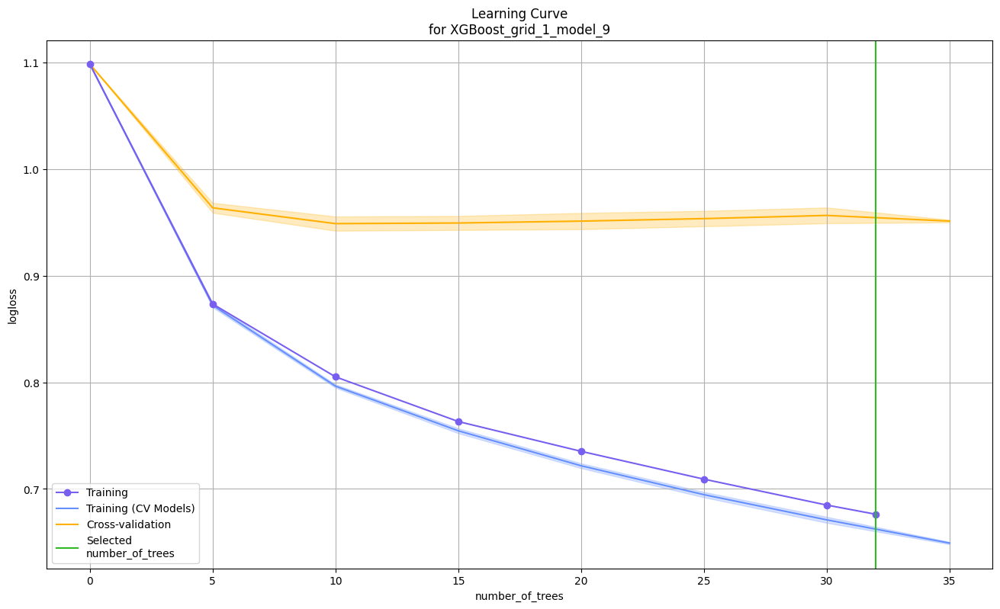

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

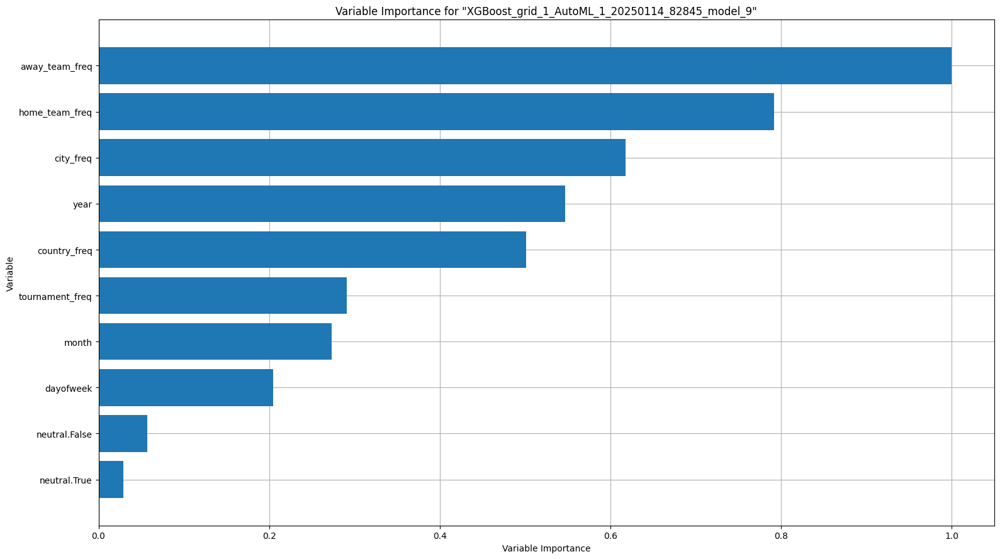

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

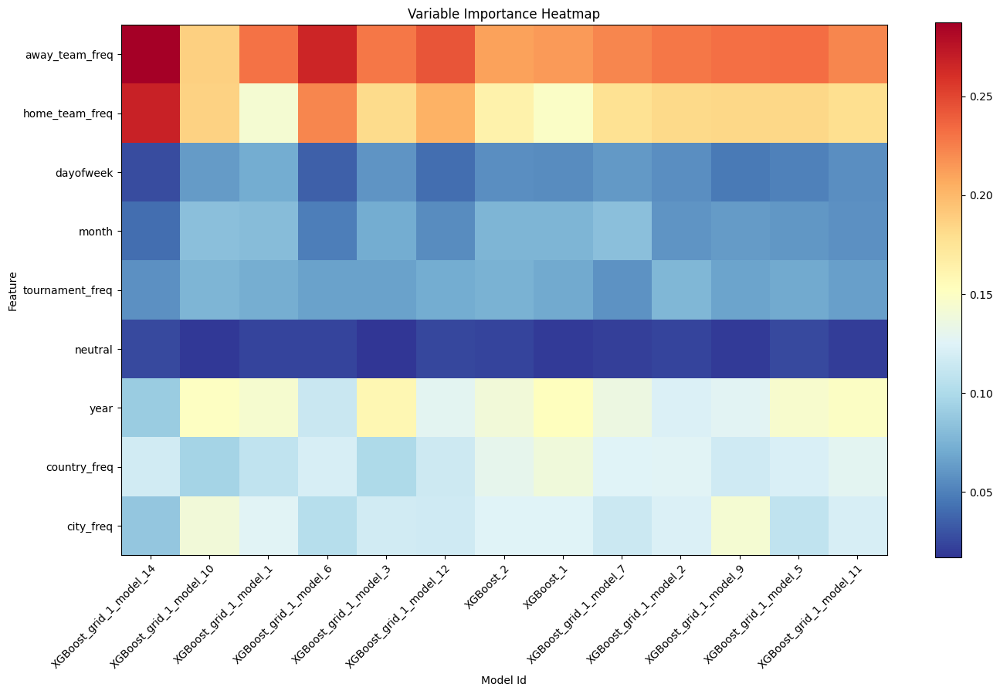

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

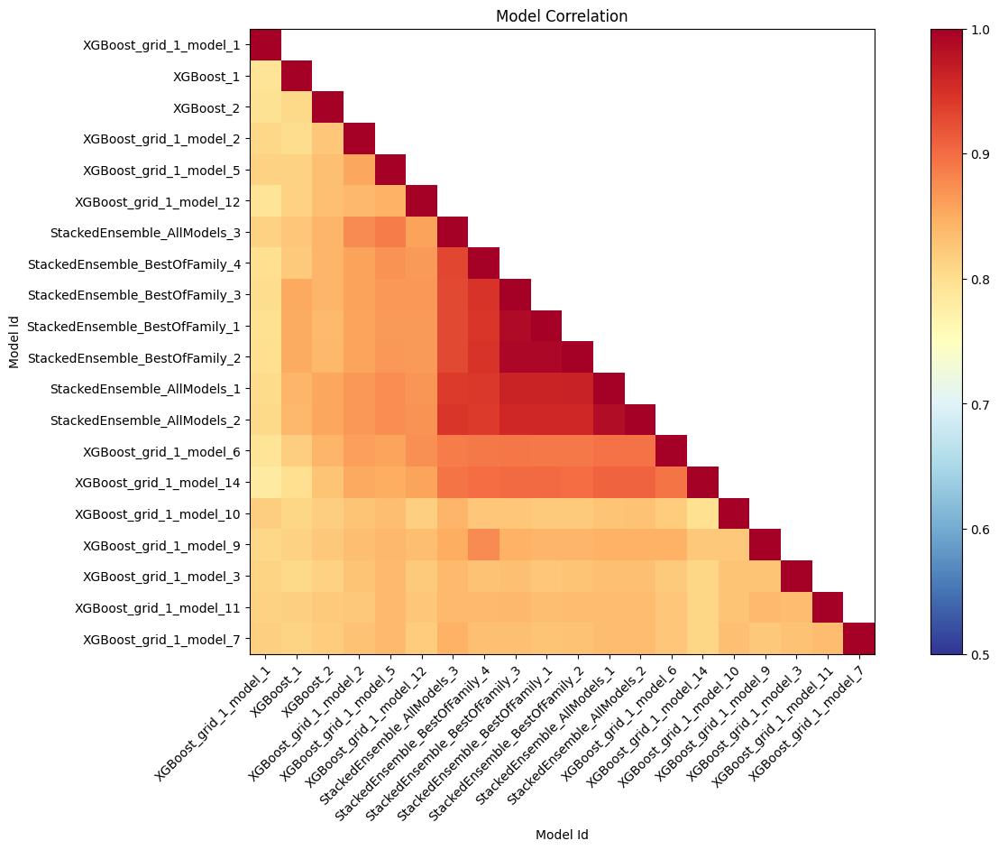

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

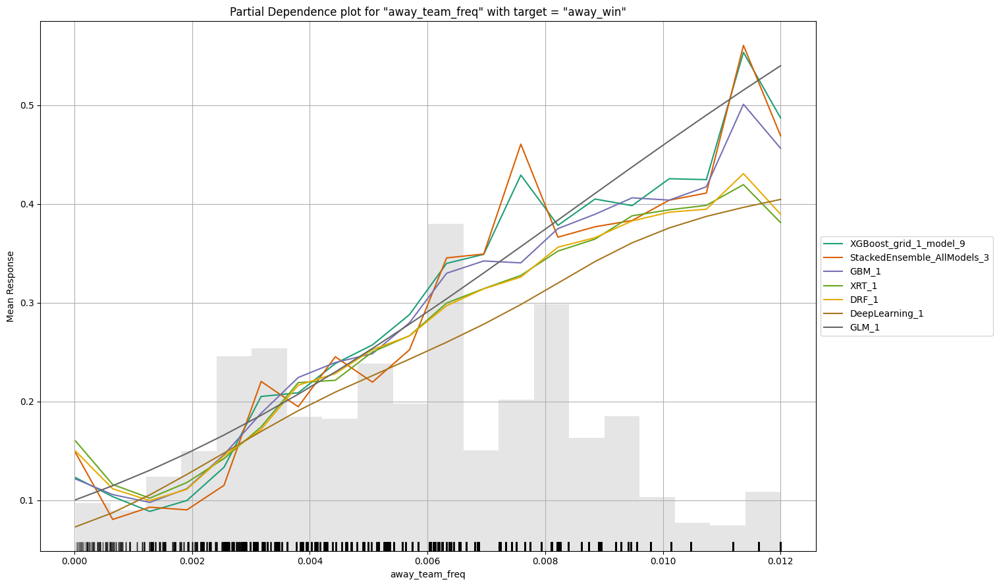

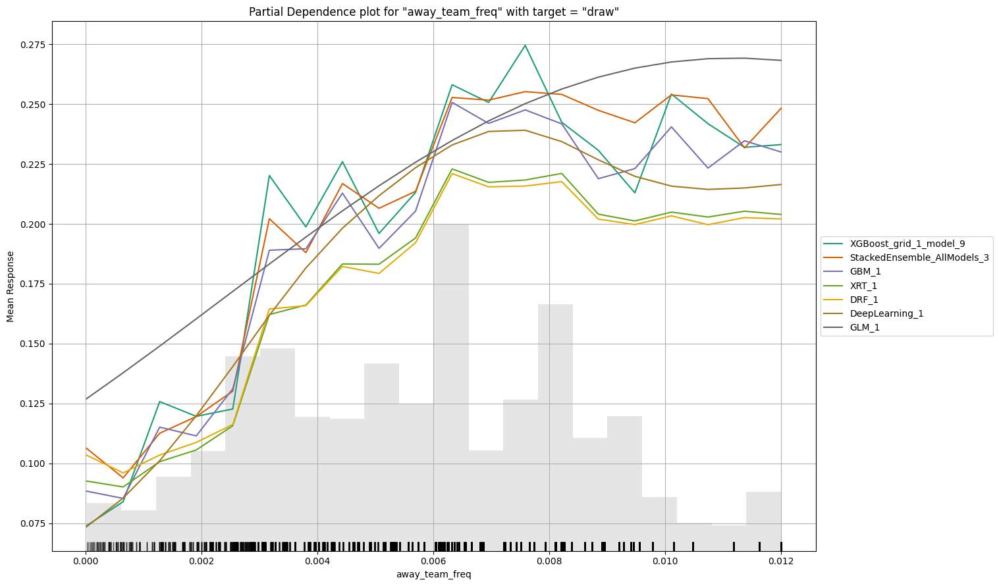

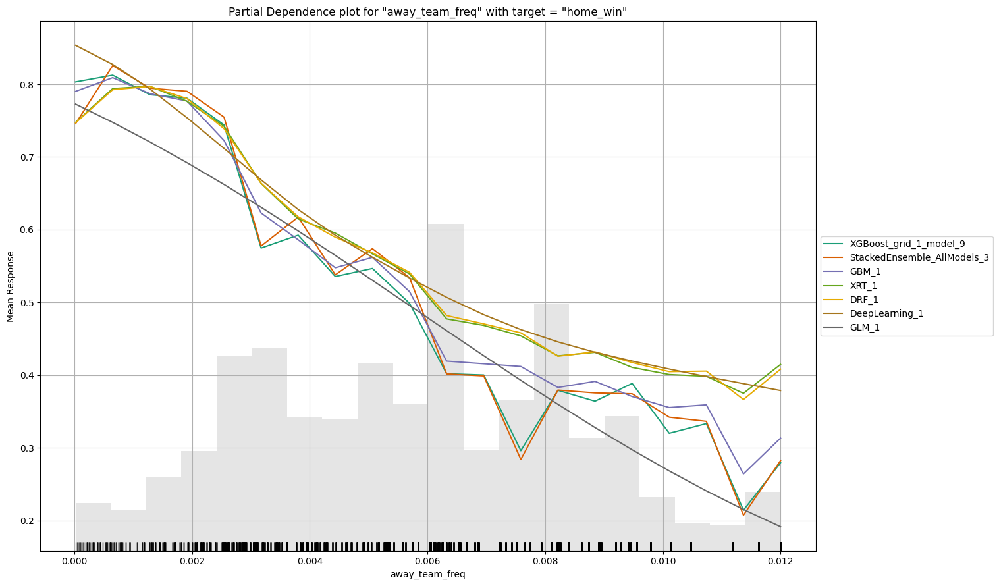

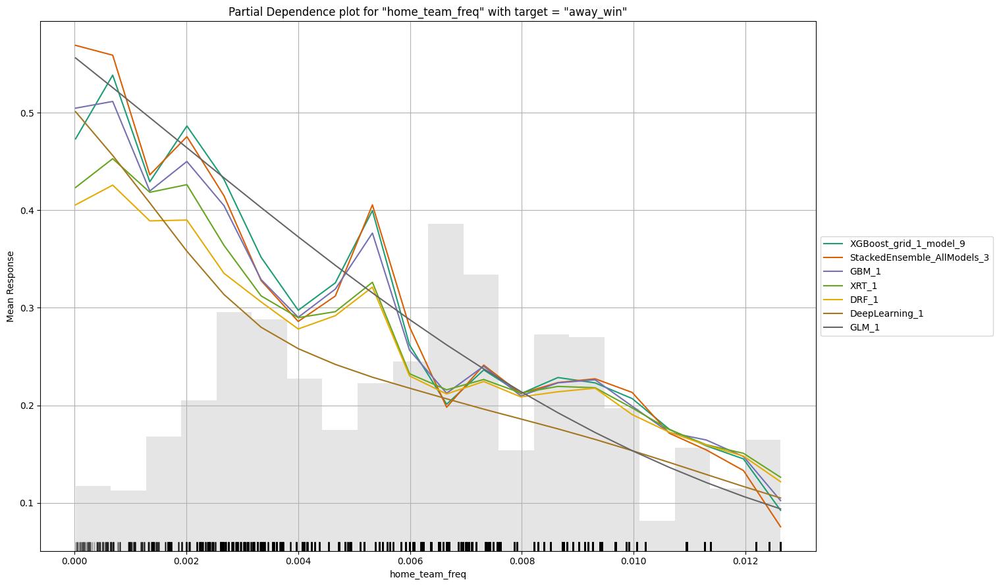

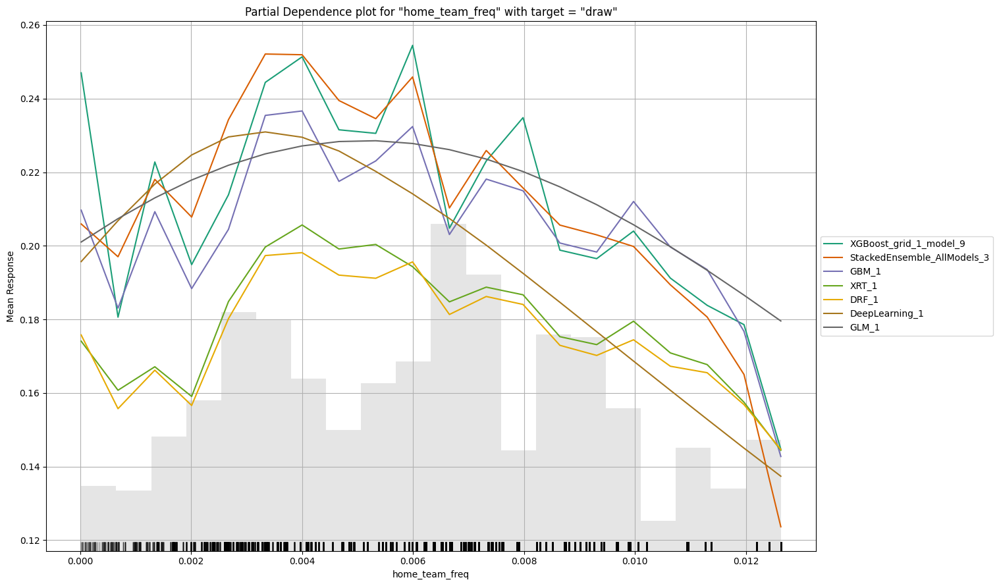

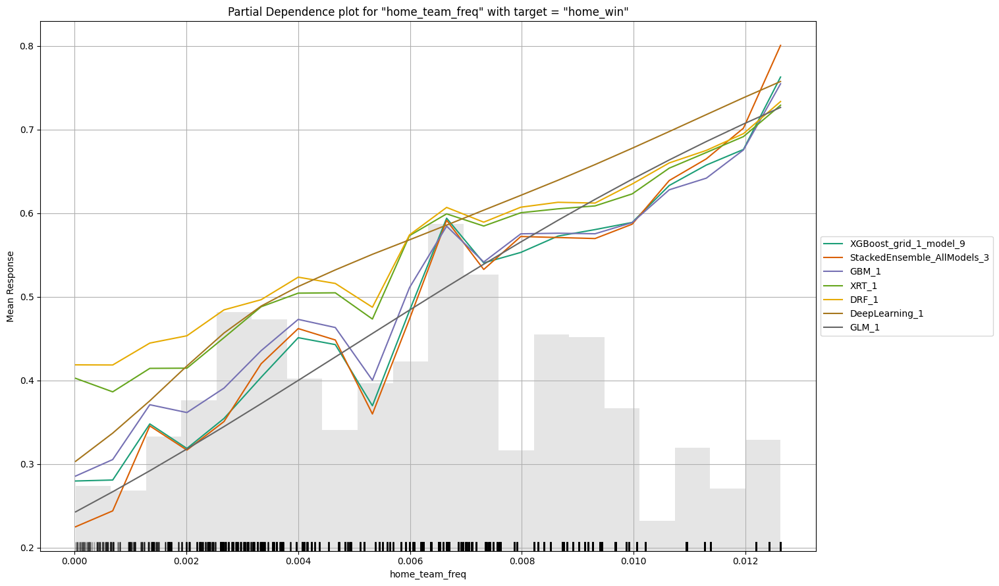

In [ ]:
aml.explain(frame=test)

In [ ]:
print_metric()

xgboost prediction progress: |███████████████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install polars and pyarrow and use it as pandas_df = h2o_df.as_data_frame(use_multi_thread=True)

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"
/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install polars and pyarrow and use it as pandas_df = h2o_df.as_data_frame(use_multi_thread=True)

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"
/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install polars and pyarrow a

Accuracy: 0.5443104352385947
F1-score: 0.5030152845648479
Precision: 0.4990929868813879
Recall: 0.5443104352385947
ROC-AUC: 0.6897959193518529
Confusion Matrix:
 [[1330  256 1165]
 [ 563  230 1433]
 [ 626  302 3630]]
              precision    recall  f1-score   support

    away_win       0.53      0.48      0.50      2751
        draw       0.29      0.10      0.15      2226
    home_win       0.58      0.80      0.67      4558

    accuracy                           0.54      9535
   macro avg       0.47      0.46      0.44      9535
weighted avg       0.50      0.54      0.50      9535



## TPOT

In [ ]:
target = 'result'
X = data.drop(columns=[target])
y = data[target]

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
from sklearn.model_selection import StratifiedKFold

In [ ]:
tpot = TPOTClassifier(
        generations=5,
        population_size=25,
        verbosity=3,
        random_state=42,
        n_jobs=-1,
        max_time_mins=90,
        scoring='balanced_accuracy',
        cv=StratifiedKFold(n_splits=5),
        warm_start=True
    )

In [ ]:
# Запуск обучения
tpot.fit(X_train, y_train)

32 operators have been imported by TPOT.


Optimization Progress:   0%|          | 0/25 [00:00<?, ?pipeline/s]

_pre_test decorator: _random_mutation_operator: num_test=0 The 'loss' parameter of SGDClassifier must be a str among {'squared_epsilon_insensitive', 'log_loss', 'modified_huber', 'perceptron', 'huber', 'epsilon_insensitive', 'squared_hinge', 'hinge', 'squared_error'}. Got 'log' instead..
_pre_test decorator: _random_mutation_operator: num_test=0 could not convert string to float: 'away_win'.
_pre_test decorator: _random_mutation_operator: num_test=0 could not convert string to float: 'home_win'.
_pre_test decorator: _random_mutation_operator: num_test=0 could not convert string to float: 'home_win'.
_pre_test decorator: _random_mutation_operator: num_test=0 could not convert string to float: 'home_win'.
_pre_test decorator: _random_mutation_operator: num_test=0 Solver lbfgs supports only 'l2' or None penalties, got l1 penalty..
_pre_test decorator: _random_mutation_operator: num_test=0 Unsupported set of arguments: The combination of penalty='l1' and loss='hinge' is not supported, Para

TPOTClassifier(cv=StratifiedKFold(n_splits=5, random_state=None, shuffle=False),
               generations=5, max_time_mins=90, n_jobs=-1, population_size=25,
               random_state=42, scoring='balanced_accuracy', verbosity=3,
               warm_start=True)

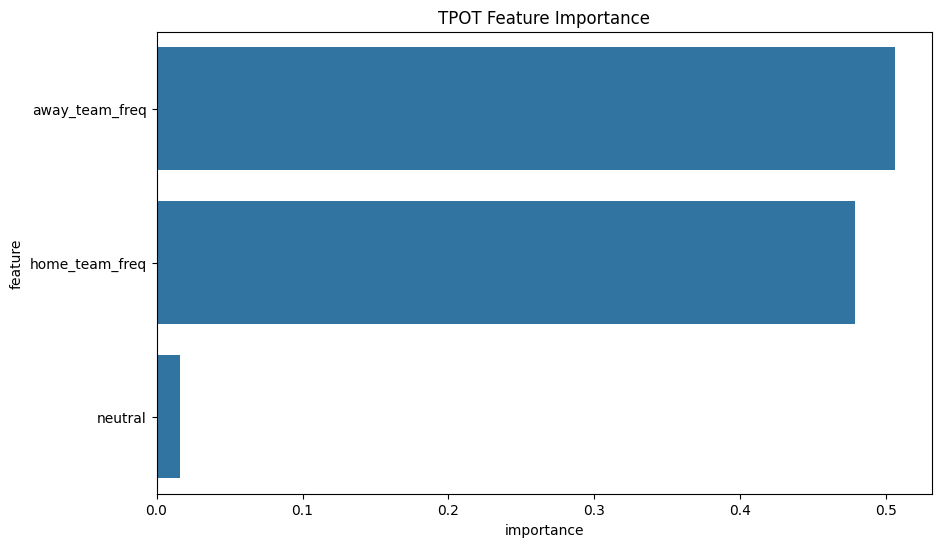

In [ ]:
if hasattr(tpot.fitted_pipeline_, 'transform'):
    transformed_X_train = tpot.fitted_pipeline_.transform(X_train)
    print("Features после трансформации(TPOT):", transformed_X_train.shape)
if hasattr(tpot.fitted_pipeline_.steps[-1][1], 'feature_importances_'):
    importances = tpot.fitted_pipeline_.steps[-1][1].feature_importances_

    # Check if feature selection is applied and get selected feature indices
    if 'selectpercentile' in tpot.fitted_pipeline_.named_steps:
        selector = tpot.fitted_pipeline_.named_steps['selectpercentile']
        selected_indices = selector.get_support(indices=True)
        feature_names = X_train.columns[selected_indices]
    else:
        feature_names = X_train.columns

    feature_importance_df = pd.DataFrame({'feature': feature_names, 'importance': importances})
    feature_importance_df = feature_importance_df.sort_values(by=['importance'], ascending=False)

    # Визуализация
    plt.figure(figsize=(10, 6))
    sns.barplot(x='importance', y='feature', data=feature_importance_df)
    plt.title('TPOT Feature Importance')
    plt.show()

In [ ]:
y_pred = tpot.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
cm = confusion_matrix(y_test, y_pred)

print(f"Accuracy: {accuracy}")
print(f"F1-score: {f1}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print("Confusion Matrix:\n", cm)
print(classification_report(y_test, y_pred))

Accuracy: 0.5389190317195326
F1-score: 0.5001028553359661
Precision: 0.490808584455143
Recall: 0.5389190317195326
Confusion Matrix:
 [[1266  270 1154]
 [ 586  218 1380]
 [ 683  346 3681]]
              precision    recall  f1-score   support

    away_win       0.50      0.47      0.48      2690
        draw       0.26      0.10      0.14      2184
    home_win       0.59      0.78      0.67      4710

    accuracy                           0.54      9584
   macro avg       0.45      0.45      0.43      9584
weighted avg       0.49      0.54      0.50      9584



## AutoGluon

In [ ]:
!pip install autogluon.tabular[all]
!pip install dask[dataframe]
from autogluon.tabular import TabularPredictor

In [ ]:
target = 'result'
features = data.drop(columns=['result'])
data.dropna(subset=[target], inplace=True)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(
    features, data[target], test_size=0.2, random_state=42)

In [ ]:
# Объединяем X и y для AutoGluon (он требует один датафрейм)
train_data = pd.concat([X_train, y_train.reset_index(drop=True)], axis=1)
test_data = pd.concat([X_test, y_test.reset_index(drop=True)], axis=1)

In [ ]:
# Инициализируем AutoGluon
predictor = TabularPredictor(label=target, problem_type='multiclass', eval_metric='f1_weighted')

No path specified. Models will be saved in: "AutogluonModels/ag-20250114_084102"


In [ ]:
train_data.dropna(subset=[target], inplace=True)
test_data.dropna(subset=[target], inplace=True)

In [ ]:
train_data.head()

,neutral,home_team_freq,away_team_freq,tournament_freq,city_freq,country_freq,year,month,dayofweek,result
13920,False,0.008223,0.005572,0.012939,0.006490,0.008097,1983.0,11.0,2.0,away_win
96,False,0.008515,0.011186,0.010789,0.007283,0.008744,1894.0,4.0,5.0,home_win
30214,False,0.004174,0.006657,0.376484,0.000355,0.003130,2006.0,9.0,0.0,home_win
22584,False,0.006657,0.006532,0.376484,0.000772,0.006449,1998.0,2.0,6.0,away_win
4913,True,0.007096,0.004445,0.016069,0.000292,0.007116,1959.0,12.0,5.0,home_win


In [ ]:
predictor.fit(
    train_data=train_data,
    time_limit=3600,  # Время выполнения (1 час)
    presets='good_quality_faster_inference_only_refit'  # Акцент на качество
)

Preset alias specified: 'good_quality_faster_inference_only_refit' maps to 'good_quality'.
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.2
Python Version:     3.10.12
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       7.74 GB / 12.67 GB (61.0%)
Disk Space Avail:   72.06 GB / 107.72 GB (66.9%)
Presets specified: ['good_quality_faster_inference_only_refit']
Setting dynamic_stacking from 'auto' to True. Reason: Enable dynamic_stacking when use_bag_holdout is disabled. (use_bag_holdout=False)
Stack configuration (auto_stack=True): num_stack_levels=1, num_bag_folds=8, num_bag_sets=1
Note: `save_bag_folds=False`! This will greatly reduce peak disk usage during fit (by ~8x), but runs the risk of an out-of-memory error during model refit if memory is small relative to the data size.
	You can avoid this risk by setting `s

In [ ]:
# Оценка на тестовом наборе
performance = predictor.evaluate(test_data)
print(performance)

{'f1_weighted': 0.34498993645686166, 'accuracy': 0.47401919866444076, 'balanced_accuracy': 0.3314286366230344, 'mcc': -0.006239394347211756}


In [ ]:
# Важность признаков
feature_importances = predictor.feature_importance(test_data)
print("Feature Importances:\n", feature_importances)

Computing feature importance via permutation shuffling for 9 features using 5000 rows with 5 shuffle sets...
	8.14s	= Expected runtime (1.63s per shuffle set)
	7.67s	= Actual runtime (Completed 5 of 5 shuffle sets)


Feature Importances:
                               importance    stddev   p_value  n  p99_high  \
rolling_avg_goals_scored_5      0.003291  0.001789  0.007349  5  0.006975   
lag_goals_scored_1              0.000671  0.000159  0.000349  5  0.000998   
is_home                        -0.000127  0.001149  0.591585  5  0.002239   
lag_goals_conceded_1           -0.001155  0.000760  0.986364  5  0.000409   
rolling_avg_goals_scored_3     -0.001211  0.000904  0.979947  5  0.000650   
rolling_avg_goals_conceded_5   -0.003889  0.002387  0.989050  5  0.001026   
lag_goals_conceded_2           -0.005099  0.002998  0.990476  5  0.001073   
lag_goals_scored_2             -0.008859  0.001977  0.999721  5 -0.004789   
rolling_avg_goals_conceded_3   -0.010570  0.002708  0.999525  5 -0.004994   

                               p99_low  
rolling_avg_goals_scored_5   -0.000393  
lag_goals_scored_1            0.000345  
is_home                      -0.002493  
lag_goals_conceded_1         -0.002720  
ro

In [ ]:
predictor.leaderboard(test_data, extra_info=True)

,model,score_test,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,...,hyperparameters,hyperparameters_fit,ag_args_fit,features,compile_time,child_hyperparameters,child_hyperparameters_fit,child_ag_args_fit,ancestors,descendants
0,LightGBMXT_BAG_L1_FULL,0.346645,NaN,f1_weighted,76.242148,NaN,105.476118,76.242148,NaN,105.476118,...,"{'use_orig_features': True, 'valid_stacker': True, 'max_base_models': 0, 'max_base_models_per_type': 'auto', 'save_bag_folds': True}",{},"{'max_memory_usage_ratio': 1.15, 'max_time_limit_ratio': 1.0, 'max_time_limit': None, 'min_time_limit': 0, 'valid_raw_types': None, 'valid_special_types': None, 'ignored_type_group_special': None, 'ignored_type_group_raw': None, 'get_features_kwargs': None, 'get_features_kwargs_extra': None, 'predict_1_batch_size': None, 'temperature_scalar': None, 'drop_unique': False}","[month, tournament_freq, city_freq, country_freq, home_team_freq, away_team_freq, neutral, year, dayofweek]",None,"{'learning_rate': 0.05, 'extra_trees': True, 'num_boost_round': 8857}",{'num_boost_round': 8857},"{'max_memory_usage_ratio': 1.0, 'max_time_limit_ratio': 1.0, 'max_time_limit': None, 'min_time_limit': 0, 'valid_raw_types': ['bool', 'int', 'float', 'category'], 'valid_special_types': None, 'ignored_type_group_special': None, 'ignored_type_group_raw': None, 'get_features_kwargs': None, 'get_features_kwargs_extra': None, 'predict_1_batch_size': None, 'temperature_scalar': None}",[],[]
1,LightGBM_BAG_L1_FULL,0.344990,NaN,f1_weighted,11.266642,NaN,33.162172,11.266642,NaN,33.162172,...,"{'use_orig_features': True, 'valid_stacker': True, 'max_base_models': 0, 'max_base_models_per_type': 'auto', 'save_bag_folds': True}",{},"{'max_memory_usage_ratio': 1.15, 'max_time_limit_ratio': 1.0, 'max_time_limit': None, 'min_time_limit': 0, 'valid_raw_types': None, 'valid_special_types': None, 'ignored_type_group_special': None, 'ignored_type_group_raw': None, 'get_features_kwargs': None, 'get_features_kwargs_extra': None, 'predict_1_batch_size': None, 'temperature_scalar': None, 'drop_unique': False}","[month, tournament_freq, city_freq, country_freq, home_team_freq, away_team_freq, neutral, year, dayofweek]",None,"{'learning_rate': 0.05, 'num_boost_round': 3135}",{'num_boost_round': 3135},"{'max_memory_usage_ratio': 1.0, 'max_time_limit_ratio': 1.0, 'max_time_limit': None, 'min_time_limit': 0, 'valid_raw_types': ['bool', 'int', 'float', 'category'], 'valid_special_types': None, 'ignored_type_group_special': None, 'ignored_type_group_raw': None, 'get_features_kwargs': None, 'get_features_kwargs_extra': None, 'predict_1_batch_size': None, 'temperature_scalar': None}",[],[WeightedEnsemble_L2_FULL]
2,WeightedEnsemble_L2_FULL,0.344990,NaN,f1_weighted,11.269122,NaN,38.090592,0.002481,NaN,4.928419,...,"{'use_orig_features': False, 'valid_stacker': True, 'max_base_models': 0, 'max_base_models_per_type': 'auto', 'save_bag_folds': True}",{},"{'max_memory_usage_ratio': 1.0, 'max_time_limit_ratio': 1.0, 'max_time_limit': None, 'min_time_limit': 0, 'valid_raw_types': None, 'valid_special_types': None, 'ignored_type_group_special': None, 'ignored_type_group_raw': None, 'get_features_kwargs': None, 'get_features_kwargs_extra': None, 'predict_1_batch_size': None, 'temperature_scalar': None, 'drop_unique': False}","[LightGBM_BAG_L1_0, LightGBM_BAG_L1_1, LightGBM_BAG_L1_2]",None,"{'ensemble_size': 25, 'subsample_size': 1000000}",{'ensemble_size': 1},"{'max_memory_usage_ratio': 1.0, 'max_time_limit_ratio': 1.0, 'max_time_limit': None, 'min_time_limit': 0, 'valid_raw_types': None, 'valid_special_types': None, 'ignored_type_group_special': None, 'ignored_type_group_raw': None, 'get_features_kwargs': None, 'get_features_kwargs_extra': None, 'predict_1_batch_size': None, 'temperature_scalar': None, 'drop_unique': False}",[LightGBM_BAG_L1_FULL],[]
3,NeuralNetFastAI_BAG_L1_FULL,0.335174,NaN,f1_weighted,0.188077,NaN,1.951143,0.188077,NaN,1.951143,...,"

In [ ]:
y_pred = predictor.predict(test_data)
y_pred_proba = predictor.predict_proba(test_data)

In [ ]:
best_model = predictor.model_best
print(best_model)
print(predictor.info())

LightGBM_BAG_L1_FULL
{'path': '/content/AutogluonModels/ag-20250114_084102', 'label': 'result', 'random_state': 0, 'version': '1.2', 'features': ['neutral', 'home_team_freq', 'away_team_freq', 'tournament_freq', 'city_freq', 'country_freq', 'year', 'month', 'dayofweek'], 'feature_metadata_in': <autogluon.common.features.feature_metadata.FeatureMetadata object at 0x7d164b16d060>, 'time_fit_preprocessing': 0.35495877265930176, 'time_fit_training': 2637.439260005951, 'time_fit_total': 2637.7942187786102, 'time_limit': 2636.1847064495087, 'time_train_start': 1736845052.5361388, 'num_rows_train': 38333, 'num_cols_train': 9, 'num_rows_val': None, 'num_rows_test': None, 'num_classes': 3, 'problem_type': 'multiclass', 'eval_metric': 'f1_weighted', 'best_model': 'LightGBM_BAG_L1_FULL', 'best_model_score_val': None, 'best_model_stack_level': 1, 'num_models_trained': 16, 'num_bag_folds': 8, 'max_stack_level': 2, 'max_core_stack_level': 1, 'model_info': {'NeuralNetFastAI_BAG_L1': {'name': 'NeuralN

In [ ]:
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')  # Или 'macro', 'micro'
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
roc_auc = roc_auc_score(y_test, y_pred_proba, multi_class='ovr', average='weighted')

print(f"Accuracy: {accuracy}")
print(f"F1-score: {f1}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"ROC-AUC: {roc_auc}")
print(classification_report(y_test, y_pred))

Accuracy: 0.47621035058430716
F1-score: 0.347859838987724
Precision: 0.37384893249396767
Recall: 0.47621035058430716
ROC-AUC: 0.49720746570547975
              precision    recall  f1-score   support

    away_win       0.27      0.04      0.07      2690
        draw       0.24      0.03      0.05      2184
    home_win       0.49      0.93      0.64      4710

    accuracy                           0.48      9584
   macro avg       0.34      0.33      0.25      9584
weighted avg       0.37      0.48      0.35      9584



# Эксперимент 5

In [ ]:
data = pd.read_csv('/content/Experiment_5.csv')

In [ ]:
data.head()

,date,team,is_home,rolling_avg_goals_scored_3,rolling_avg_goals_conceded_3,rolling_avg_goals_scored_5,rolling_avg_goals_conceded_5,lag_goals_scored_1,lag_goals_conceded_1,lag_goals_scored_2,lag_goals_conceded_2,rolling_goal_diff,match_result
0,2014-06-01,Abkhazia,1,0.666667,1.666667,0.666667,1.666667,0.0,3.0,1.0,1.0,-1.000000,1
1,2014-06-02,Abkhazia,0,1.000000,1.666667,1.000000,1.500000,1.0,1.0,0.0,3.0,-0.666667,2
2,2014-06-04,Abkhazia,1,1.000000,0.666667,0.800000,1.200000,2.0,1.0,1.0,1.0,0.333333,1
3,2014-06-05,Abkhazia,0,1.666667,1.333333,1.200000,1.600000,0.0,0.0,2.0,1.0,0.333333,1
4,2014-06-07,Abkhazia,1,1.000000,1.333333,1.200000,1.200000,3.0,3.0,0.0,0.0,-0.333333,0


## H2O

In [ ]:
amlw = H2OAutoML(max_runtime_secs=3600, seed=42, project_name="feature_generation55")

In [ ]:
# Запуск H2O AutoML
amlw.train(x=features, y=target, training_frame=h2o_df)

AutoML progress: |███████████████████████████████████████████████████████████████| (done) 100%


Model Details
=============
H2ODeepLearningEstimator : Deep Learning
Model Key: DeepLearning_1_AutoML_3_20250116_190016


Status of Neuron Layers: predicting match_result, regression, gaussian distribution, Quadratic loss, 331 weights/biases, 9.7 KB, 989,450 training samples, mini-batch size 1
    layer    units    type       dropout    l1    l2    mean_rate            rate_rms            momentum    mean_weight            weight_rms           mean_bias            bias_rms
--  -------  -------  ---------  ---------  ----  ----  -------------------  ------------------  ----------  ---------------------  -------------------  -------------------  -----------------------
    1        9        Input      0.0
    2        10       Rectifier  0.0        0.0   0.0   0.43493905666594707  0.3764604330062866  0.0         0.0020173562173214222  0.24747461080551147  0.26755036912810143  0.27930617332458496
    3        10       Rectifier  0.0        0.0   0.0   0.519938802709803    0.3965507745742798  0.0         -0.16883235677145422   0.3837689161300659   0.6647486946355535   0.2818758487701416
    4        10       Rectifier  0.0        0.0   0.0   0.5955817014398054   0.414828896522522   0.0         -0.10431319654860999   0.36240315437316895  0.8436785836506185   0.3141927719116211
    5        1        Linear                0.0   0.0   0.27664520479738713  0.2477230429649353  0.0         -0.08776491046883166   0.3456617593765259   0.27811294858582525  1.0971281125650402e-154

ModelMetricsRegression: deeplearning
** Reported on train data. **

MSE: 2.950135991177009e-05
RMSE: 0.0054315154341831795
MAE: 0.002510979712089571
RMSLE: 0.00283477800418658
Mean Residual Deviance: 2.950135991177009e-05

ModelMetricsRegression: deeplearning
** Reported on cross-validation data. **

MSE: 1.206987714558149e-05
RMSE: 0.0034741728721497857
MAE: 0.001691806504793329
RMSLE: 0.0019262621709909735
Mean Residual Deviance: 1.206987714558149e-05

Cross-Validation Metrics Summary: 
                        mean         sd           cv_1_valid    cv_2_valid    cv_3_valid    cv_4_valid    cv_5_valid
----------------------  -----------  -----------  ------------  ------------  ------------  ------------  ------------
aic                     nan          0            nan           nan           nan           nan           nan
loglikelihood           nan          0            nan           nan           nan           nan           nan
mae                     0.00169181   0.000811973  0.00139201    0.00128684    0.00076114    0.00220967    0.00280939
mean_residual_deviance  1.20699e-05  1.2567e-05   5.3256e-06    2.58376e-06   4.73689e-06   3.29306e-05   1.47729e-05
mse                     1.20699e-05  1.2567e-05   5.3256e-06    2.58376e-06   4.73689e-06   3.29306e-05   1.47729e-05
r2                      0.999984     1.62628e-05  0.999993      0.999997      0.999994      0.999957      0.999981
residual_deviance       1.20699e-05  1.2567e-05   5.3256e-06    2.58376e-06   4.73689e-06   3.29306e-05   1.47729e-05
rmse                    0.00313473   0.0016746    0.00230773    0.00160741    0.00217644    0.00573852    0.00384355
rmsle                   0.00178515   0.000809118  0.00153665    0.00102375    0.00107758    0.00267305    0.00261472

Scoring History: 
    timestamp            duration    training_speed    epochs    iterations    samples    training_rmse    training_deviance    training_mae    training_r2
--  -------------------  ----------  ----------------  --------  ------------  ---------  ---------------  -------------------  --------------  -------------
    2025-01-16 19:41:22  0.000 sec                     0         0             0          nan              nan                  nan             nan
    2025-01-16 19:41:23  31.069 sec  172166 obs/sec    1.04019   1             98996      0.00988427       9.76988e-05          0.00505708      0.999874
    2025-01-16 19:41:28  36.099 sec  142149 obs/sec    8.3165    8             791490     0.00416043    

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,rmse,mse,mae,rmsle,mean_residual_deviance,training_time_ms,predict_time_per_row_ms,algo
DeepLearning_1_AutoML_3_20250116_190016,0.00524926,2.75548e-05,0.00249665,0.002723,2.75548e-05,7471,0.004022,DeepLearning
StackedEnsemble_AllModels_2_AutoML_3_20250116_190016,0.00576169,3.31971e-05,0.00395999,0.00342879,3.31971e-05,1071,0.004255,StackedEnsemble
StackedEnsemble_AllModels_3_AutoML_3_20250116_190016,0.00576169,3.31971e-05,0.00395999,0.00342879,3.31971e-05,2818,0.004914,StackedEnsemble
StackedEnsemble_BestOfFamily_4_AutoML_3_20250116_190016,0.00576169,3.31971e-05,0.00395999,0.00342879,3.31971e-05,747,0.004694,StackedEnsemble
StackedEnsemble_BestOfFamily_3_AutoML_3_20250116_190016,0.00576169,3.31971e-05,0.00395999,0.00342879,3.31971e-05,890,0.003223,StackedEnsemble
DRF_1_AutoML_3_20250116_190016,0.112695,0.0127003,0.0637346,0.0726592,0.0127003,19665,0.0229,DRF
StackedEnsemble_AllModels_1_AutoML_3_20250116_190016,0.115386,0.0133138,0.0902772,0.0827359,0.0133138,3306,0.157608,StackedEnsemble
StackedEnsemble_BestOfFamily_2_AutoML_3_20250116_190016,0.122491,0.015004,0.0962692,0.0868541,0.015004,2460,0.137713,StackedEnsemble
XGBoost_1_AutoML_3_20250116_190016,0.123503,0.015253,0.0920879,0.0859845,0.015253,81036,0.037374,XGBoost
XGBoost_grid_1_AutoML_3_20250116_190016_model_1,0.124864,0.015591,0.0875015,0.0866069,0.015591,70716,0.021994,XGBoost


# Residual Analysis

> Residual Analysis plots the fitted values vs residuals on a test dataset. Ideally, residuals should be randomly distributed. Patterns in this plot can indicate potential problems with the model selection, e.g., using simpler model than necessary, not accounting for heteroscedasticity, autocorrelation, etc. Note that if you see "striped" lines of residuals, that is an artifact of having an integer valued (vs a real valued) response variable.

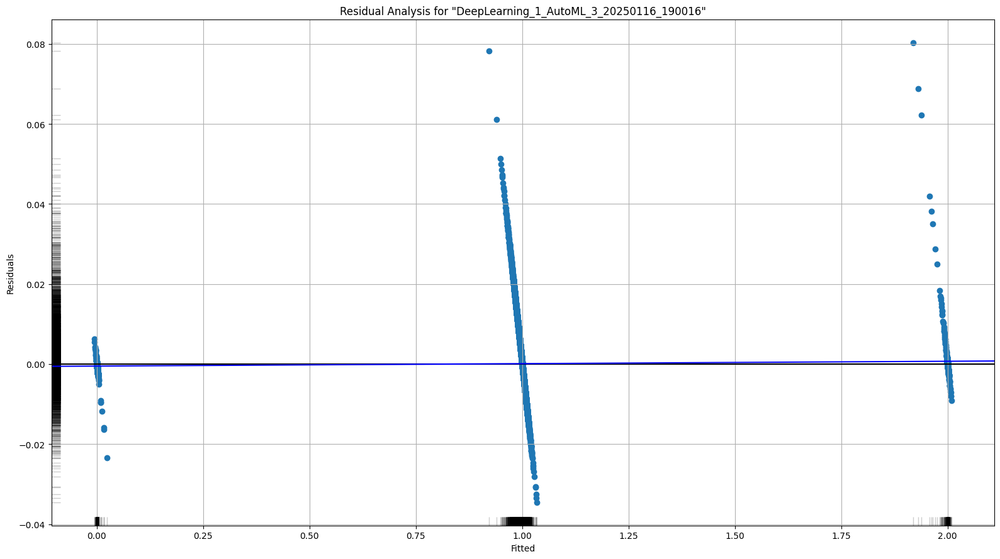

# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

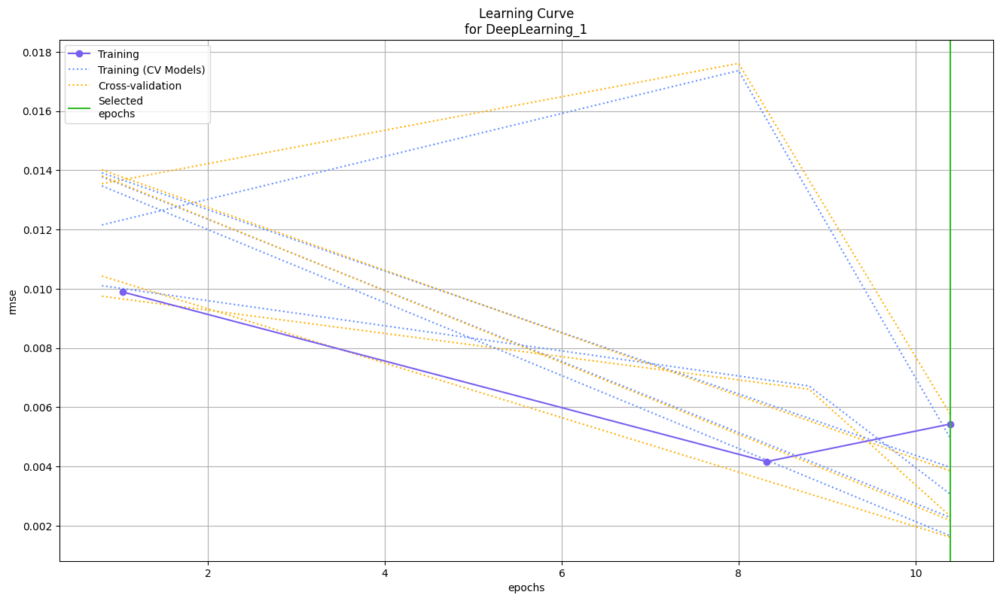

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

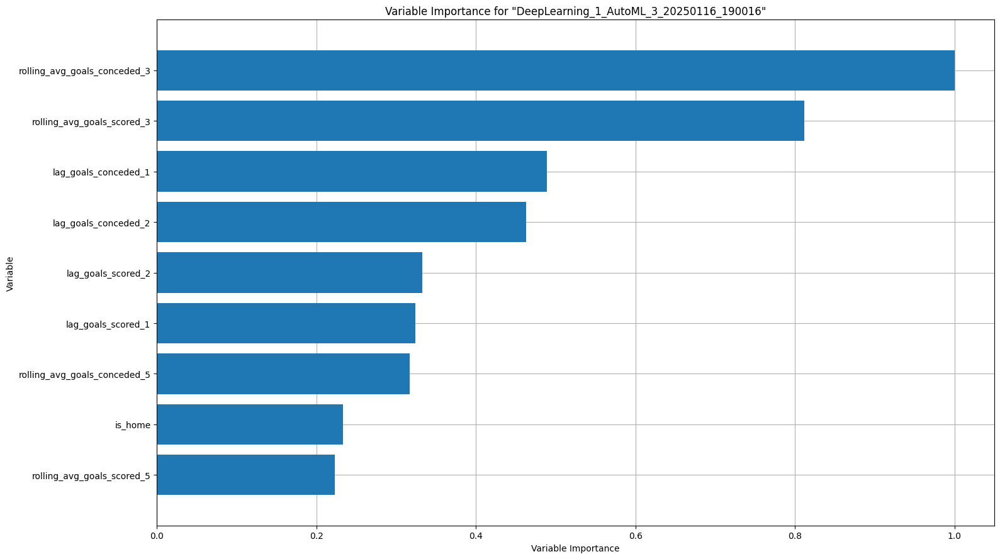

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

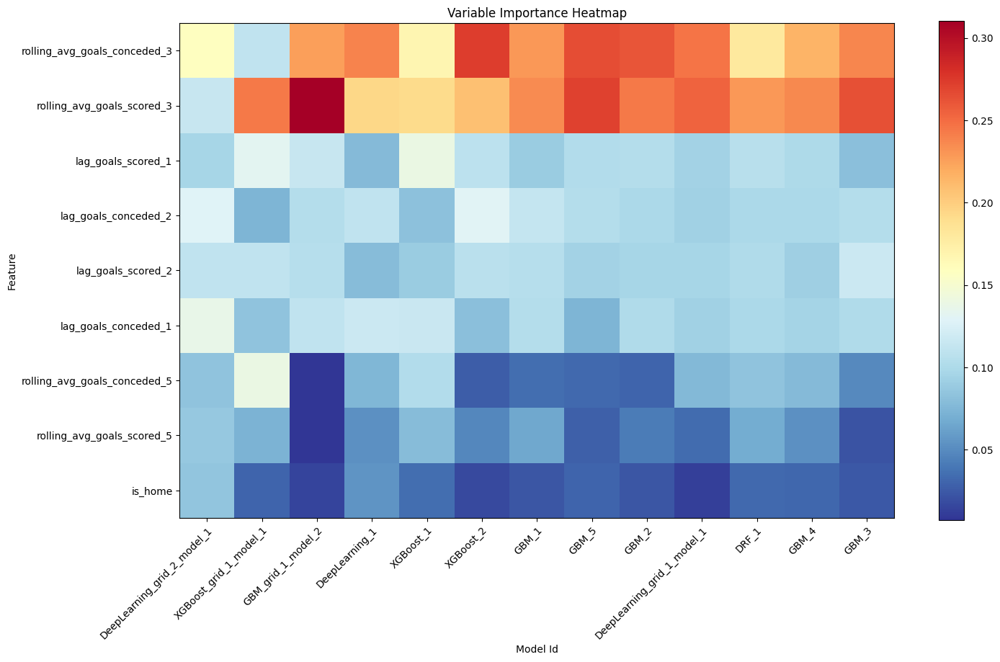

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

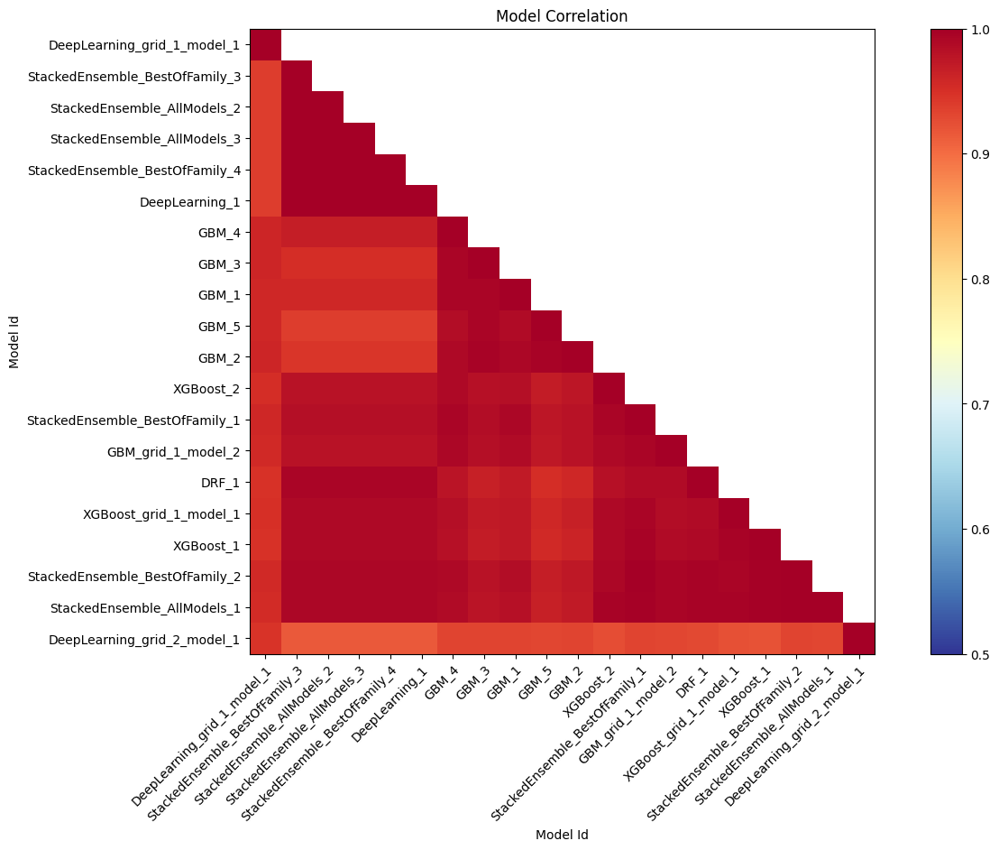

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

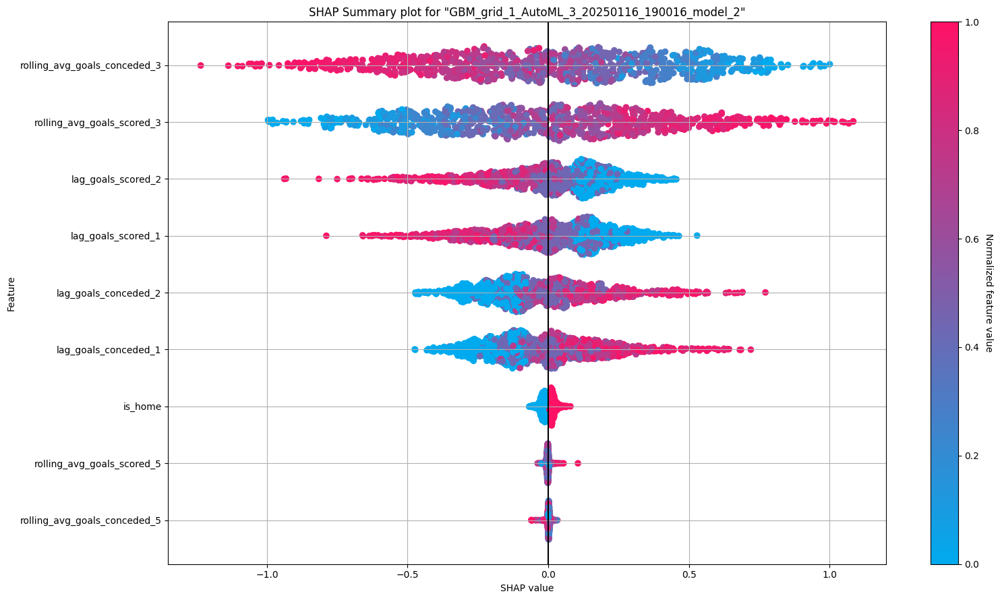

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

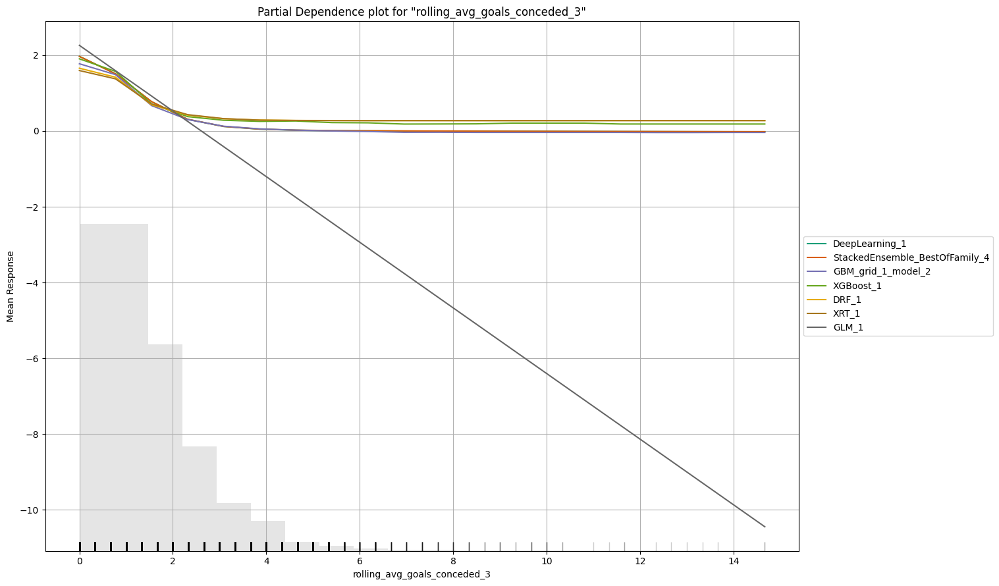

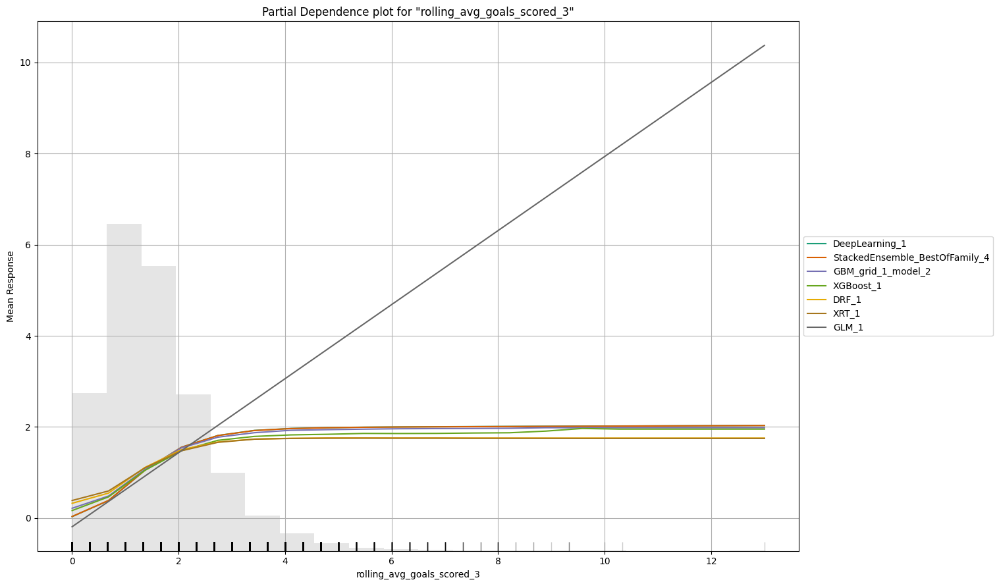

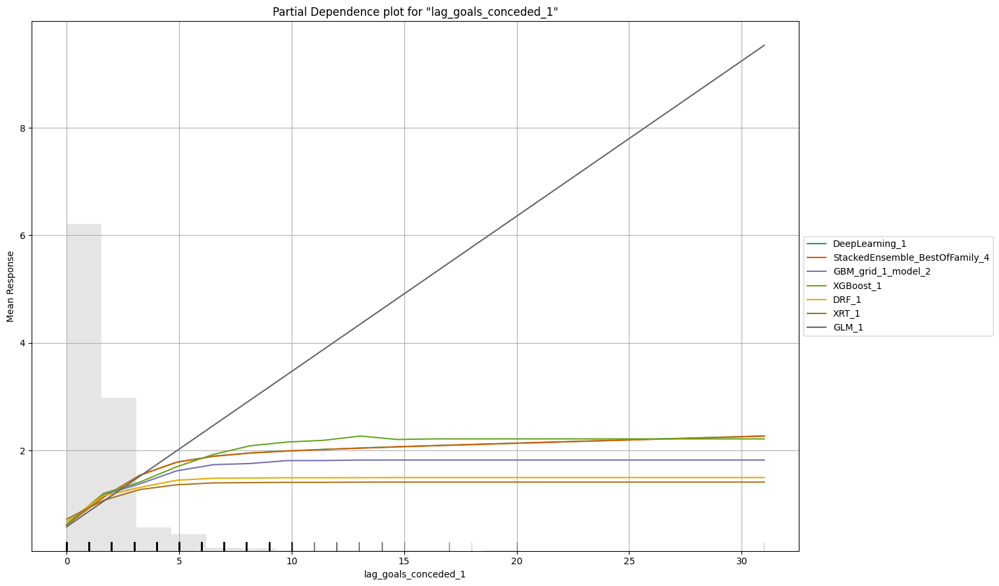

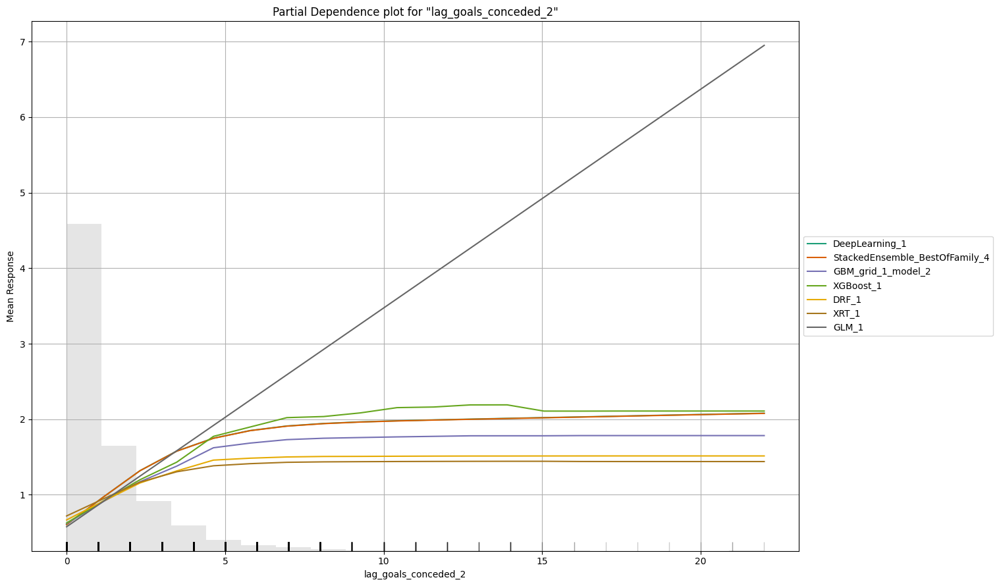

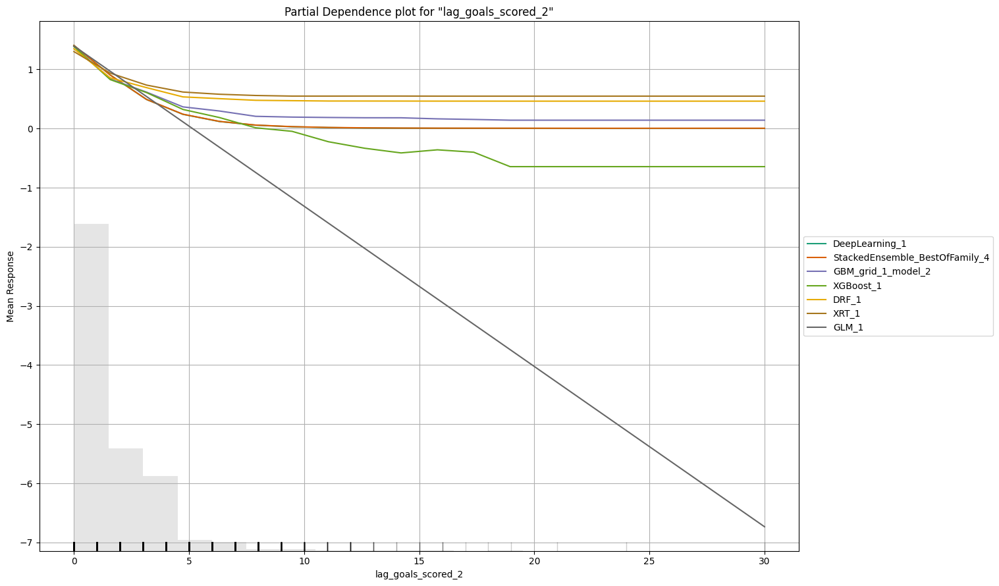

# Individual Conditional Expectation

> An Individual Conditional Expectation (ICE) plot gives a graphical depiction of the marginal effect of a variable on the response. ICE plots are similar to partial dependence plots (PDP); PDP shows the average effect of a feature while ICE plot shows the effect for a single instance. This function will plot the effect for each decile. In contrast to the PDP, ICE plots can provide more insight, especially when there is stronger feature interaction.

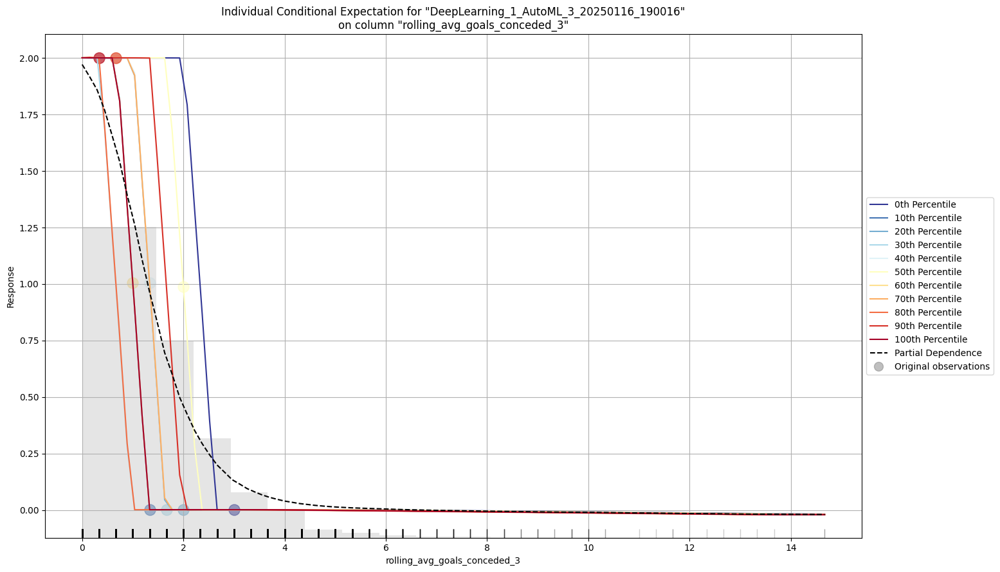

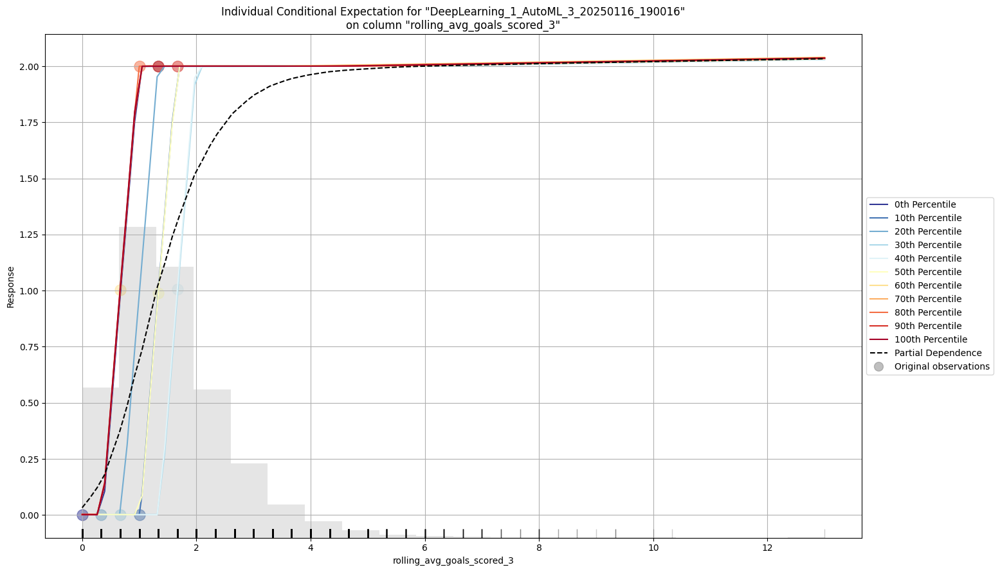

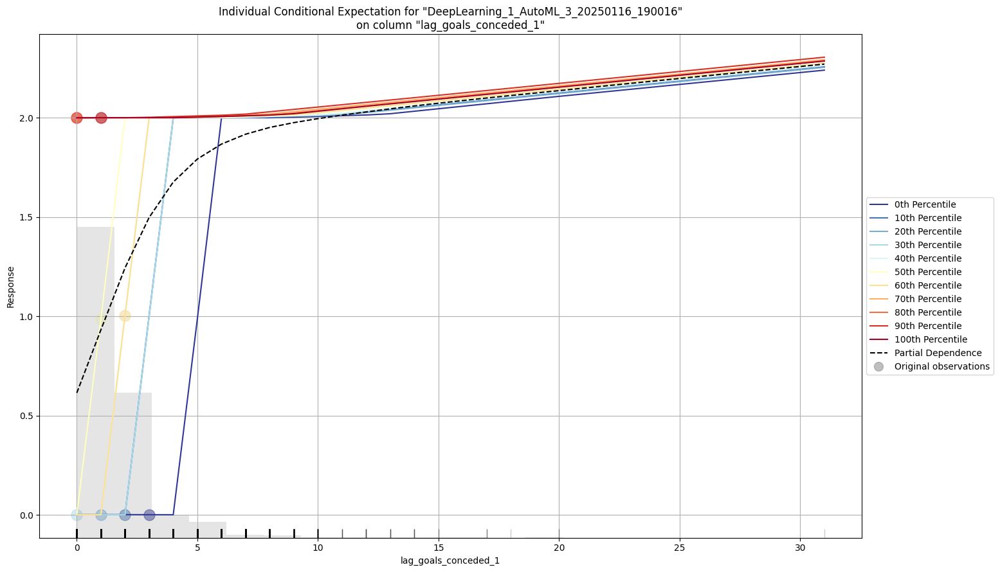

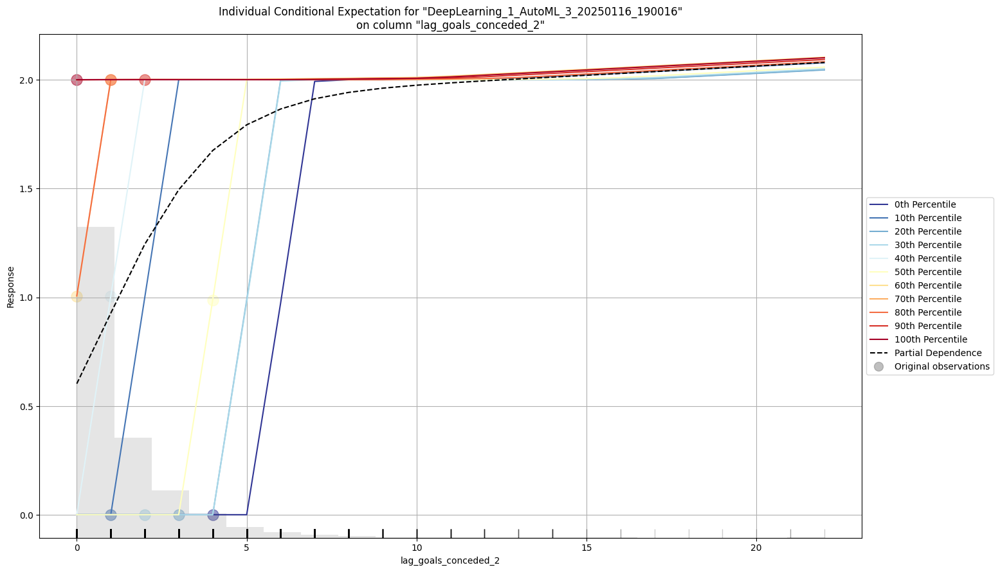

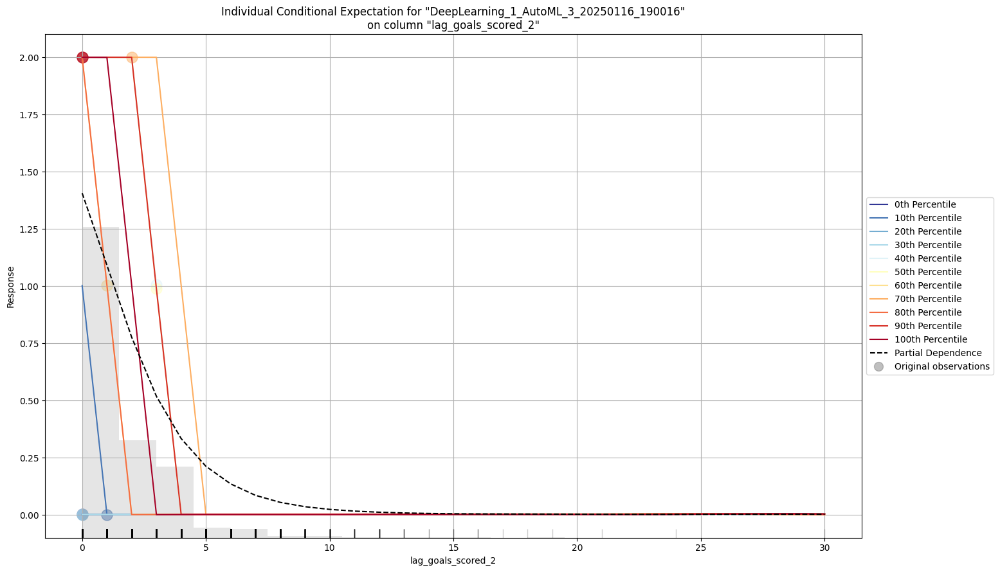

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,rmse,mse,mae,rmsle,mean_residual_deviance,training_time_ms,predict_time_per_row_ms,algo
DeepLearning_1_AutoML_3_20250116_190016,0.00524926,2.75548e-05,0.00249665,0.002723,2.75548e-05,7471,0.004022,DeepLearning
StackedEnsemble_AllModels_2_AutoML_3_20250116_190016,0.00576169,3.31971e-05,0.00395999,0.00342879,3.31971e-05,1071,0.004255,StackedEnsemble
StackedEnsemble_AllModels_3_AutoML_3_20250116_190016,0.00576169,3.31971e-05,0.00395999,0.00342879,3.31971e-05,2818,0.004914,StackedEnsemble
StackedEnsemble_BestOfFamily_4_AutoML_3_20250116_190016,0.00576169,3.31971e-05,0.00395999,0.00342879,3.31971e-05,747,0.004694,StackedEnsemble
StackedEnsemble_BestOfFamily_3_AutoML_3_20250116_190016,0.00576169,3.31971e-05,0.00395999,0.00342879,3.31971e-05,890,0.003223,StackedEnsemble
DRF_1_AutoML_3_20250116_190016,0.112695,0.0127003,0.0637346,0.0726592,0.0127003,19665,0.0229,DRF
StackedEnsemble_AllModels_1_AutoML_3_20250116_190016,0.115386,0.0133138,0.0902772,0.0827359,0.0133138,3306,0.157608,StackedEnsemble
StackedEnsemble_BestOfFamily_2_AutoML_3_20250116_190016,0.122491,0.015004,0.0962692,0.0868541,0.015004,2460,0.137713,StackedEnsemble
XGBoost_1_AutoML_3_20250116_190016,0.123503,0.015253,0.0920879,0.0859845,0.015253,81036,0.037374,XGBoost
XGBoost_grid_1_AutoML_3_20250116_190016_model_1,0.124864,0.015591,0.0875015,0.0866069,0.015591,70716,0.021994,XGBoost


# Residual Analysis

> Residual Analysis plots the fitted values vs residuals on a test dataset. Ideally, residuals should be randomly distributed. Patterns in this plot can indicate potential problems with the model selection, e.g., using simpler model than necessary, not accounting for heteroscedasticity, autocorrelation, etc. Note that if you see "striped" lines of residuals, that is an artifact of having an integer valued (vs a real valued) response variable.

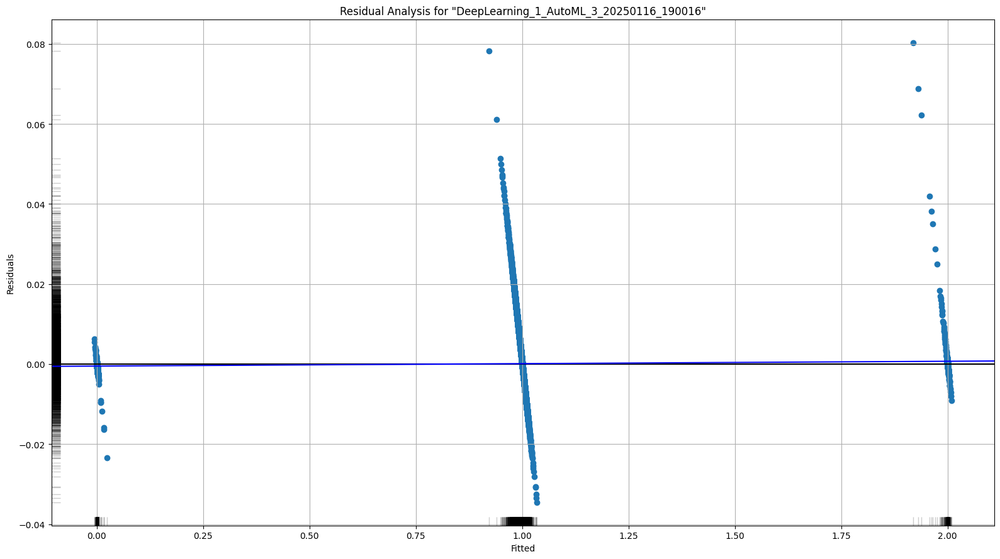

# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

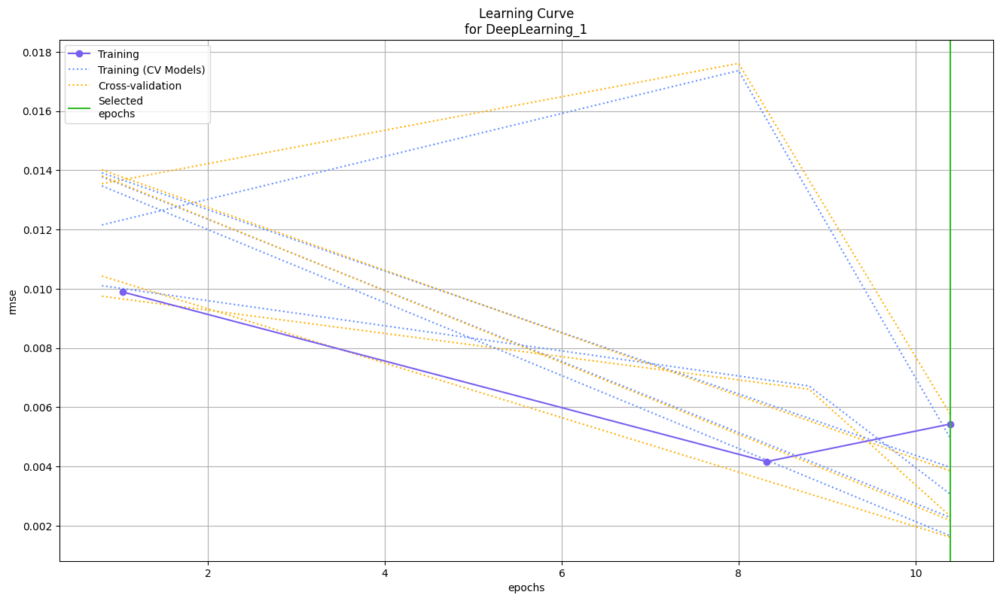

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

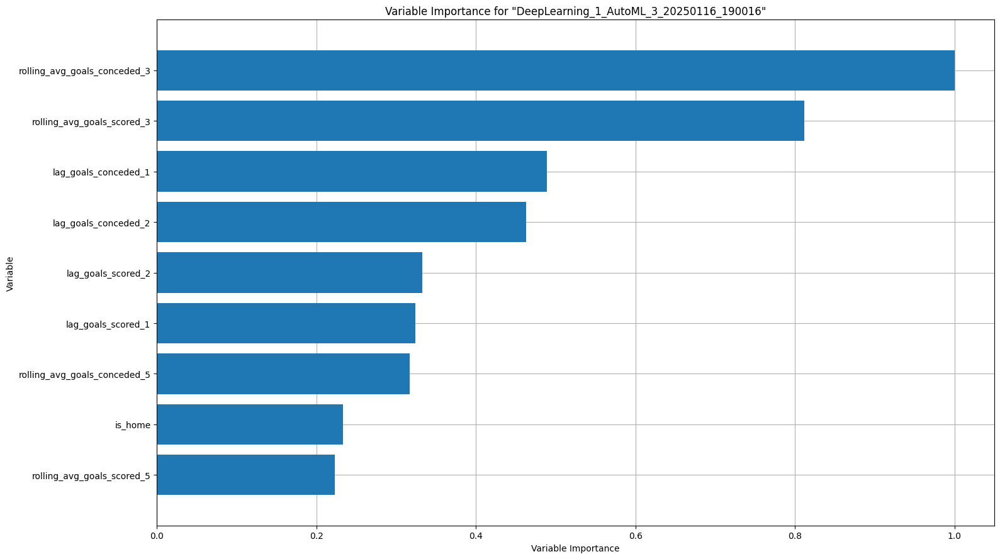

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

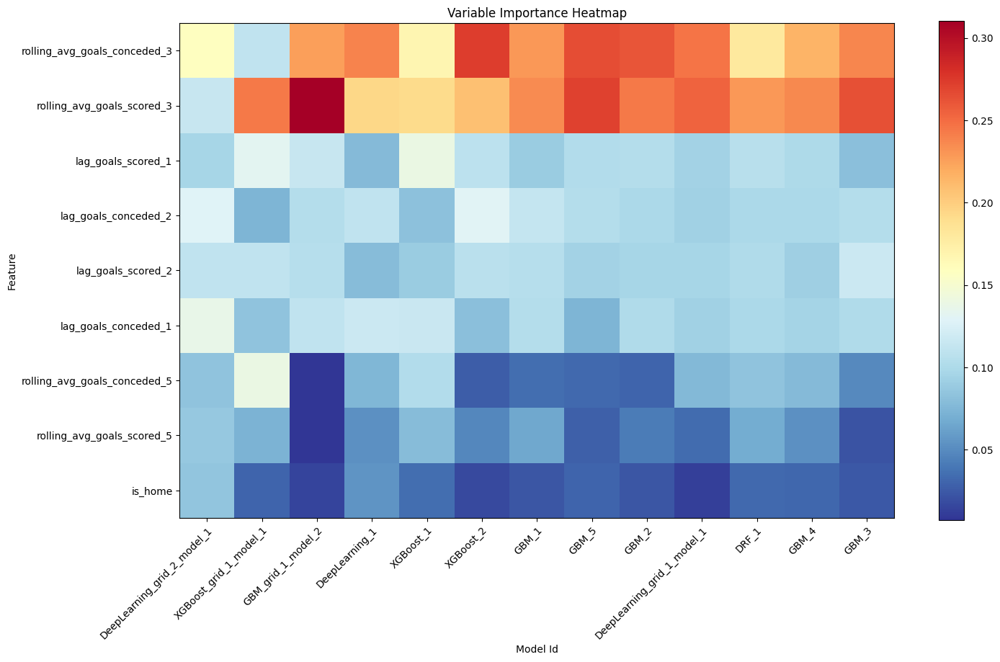

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

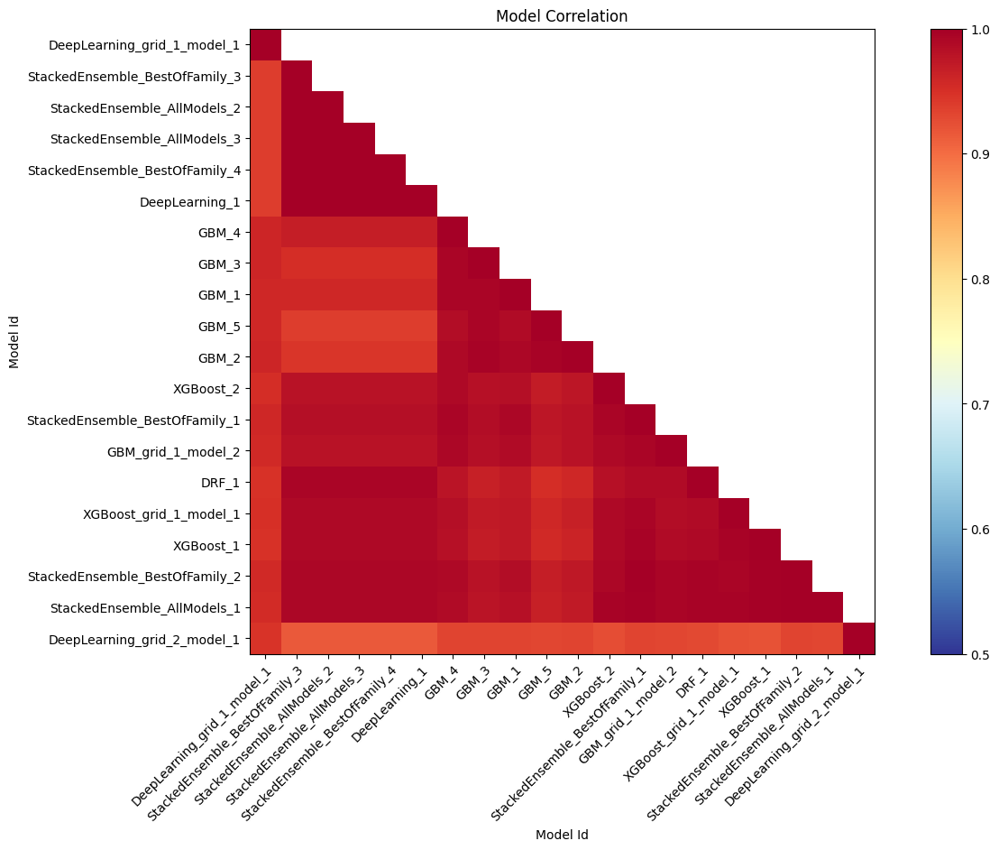

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

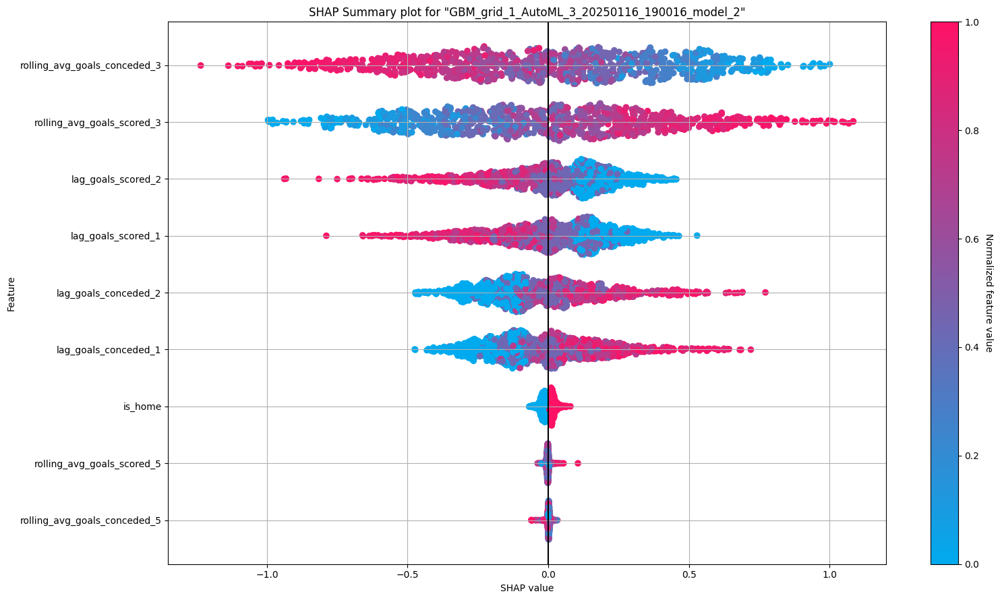

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

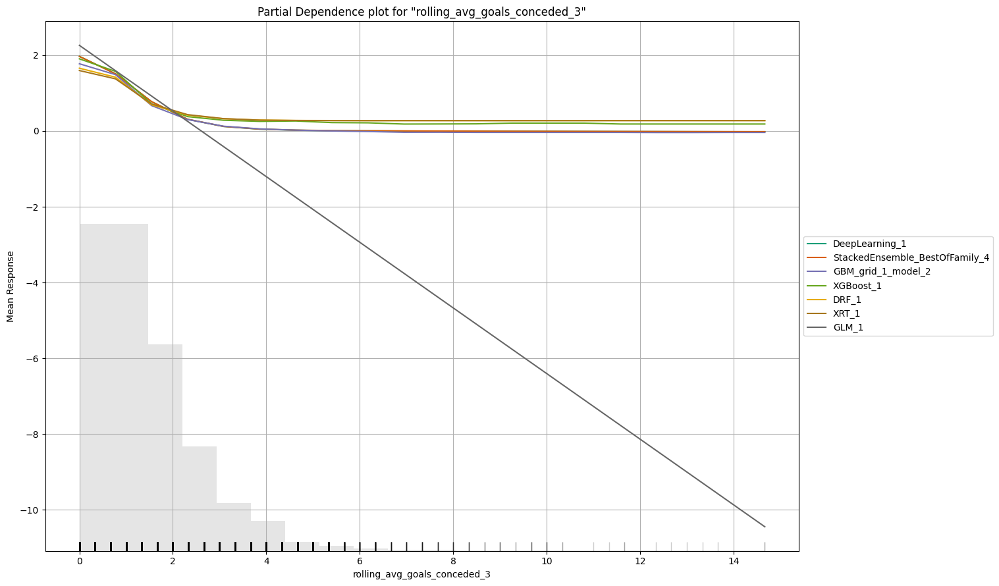

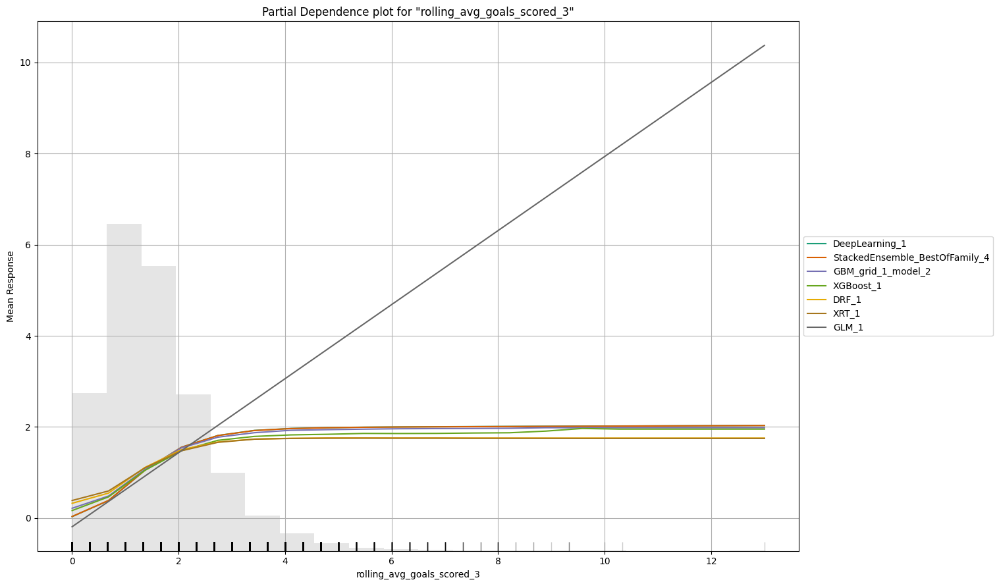

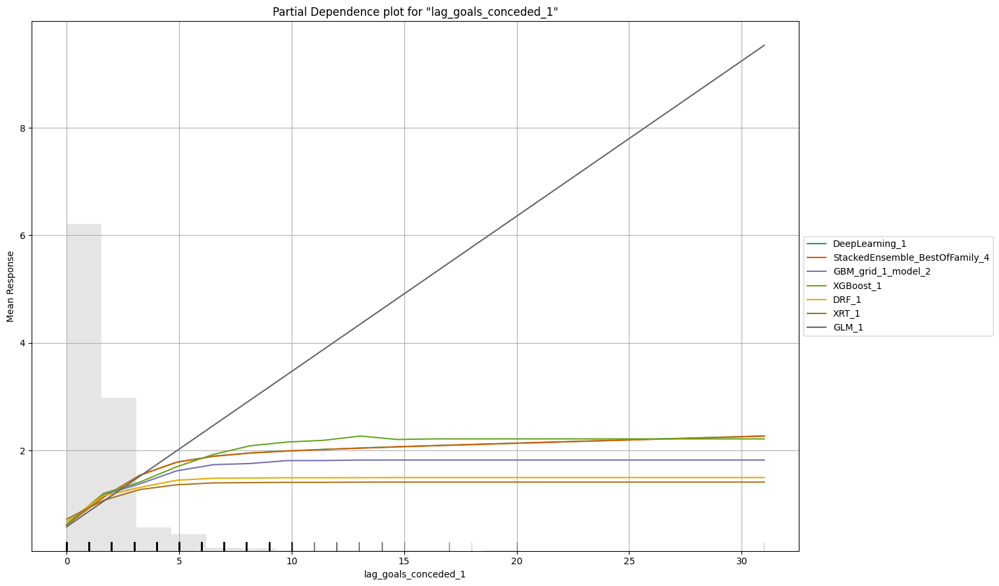

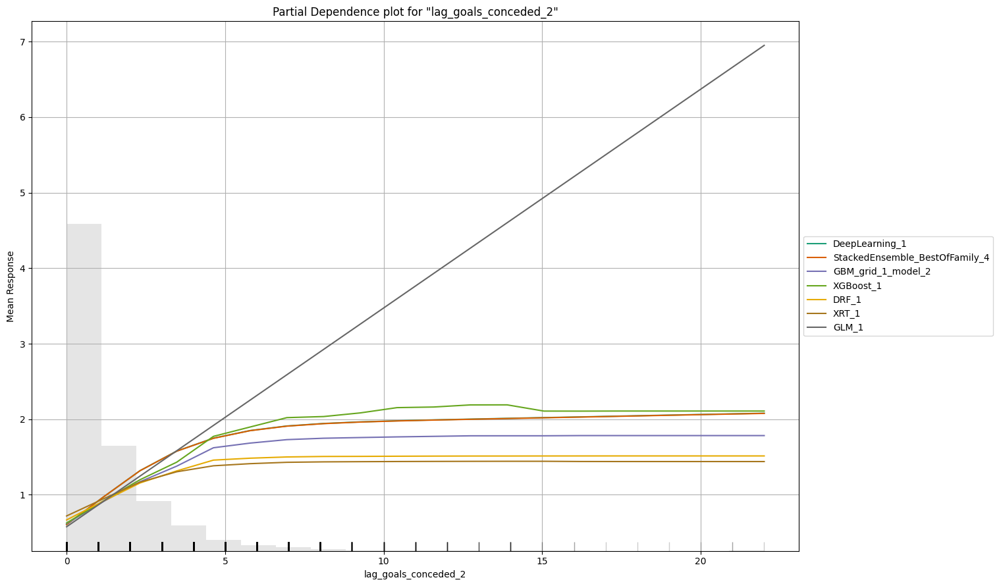

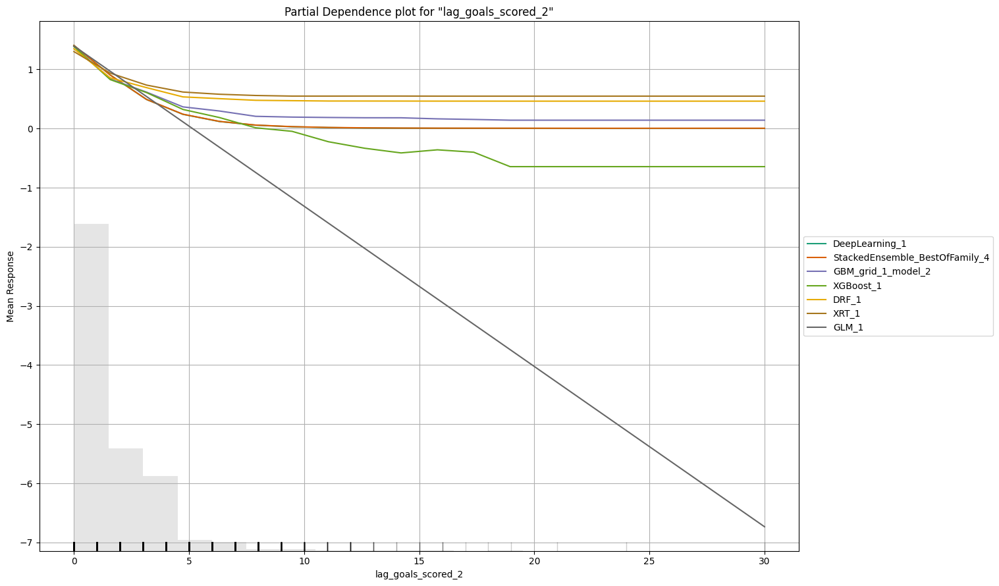

# Individual Conditional Expectation

> An Individual Conditional Expectation (ICE) plot gives a graphical depiction of the marginal effect of a variable on the response. ICE plots are similar to partial dependence plots (PDP); PDP shows the average effect of a feature while ICE plot shows the effect for a single instance. This function will plot the effect for each decile. In contrast to the PDP, ICE plots can provide more insight, especially when there is stronger feature interaction.

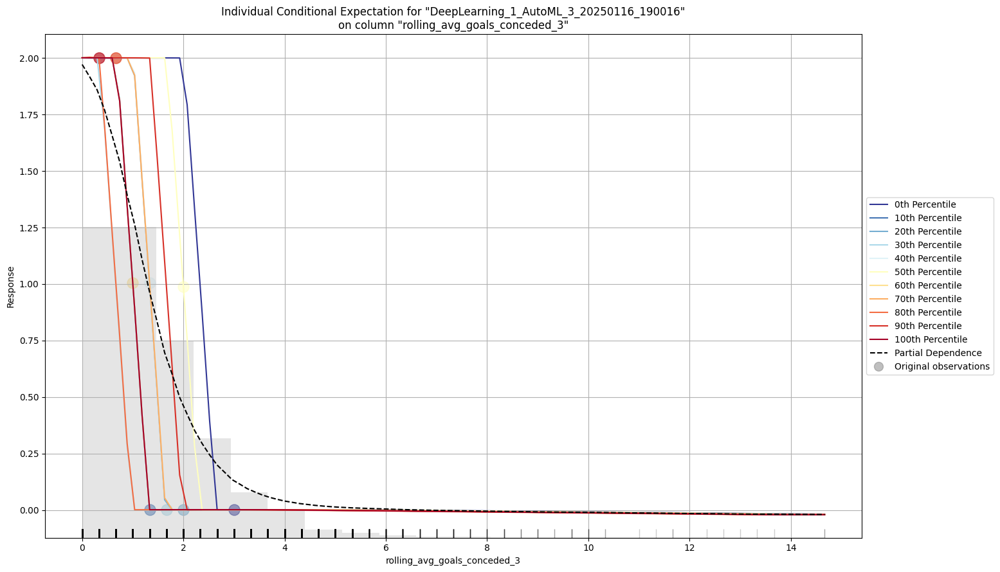

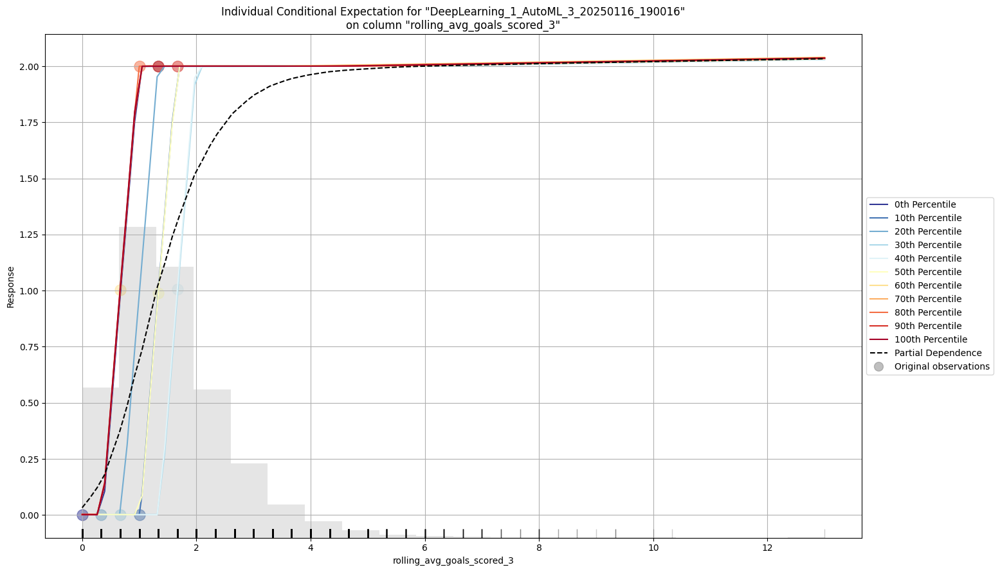

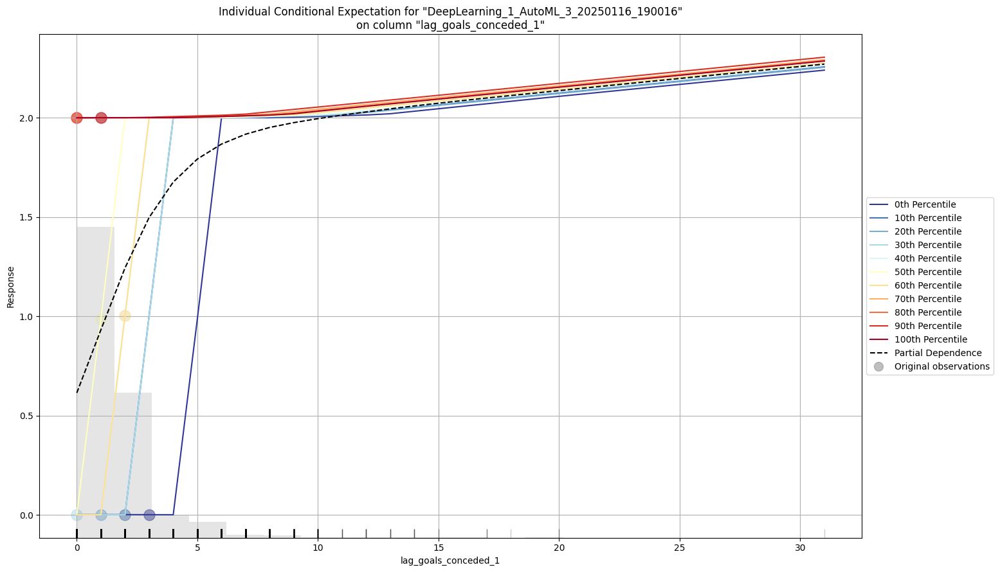

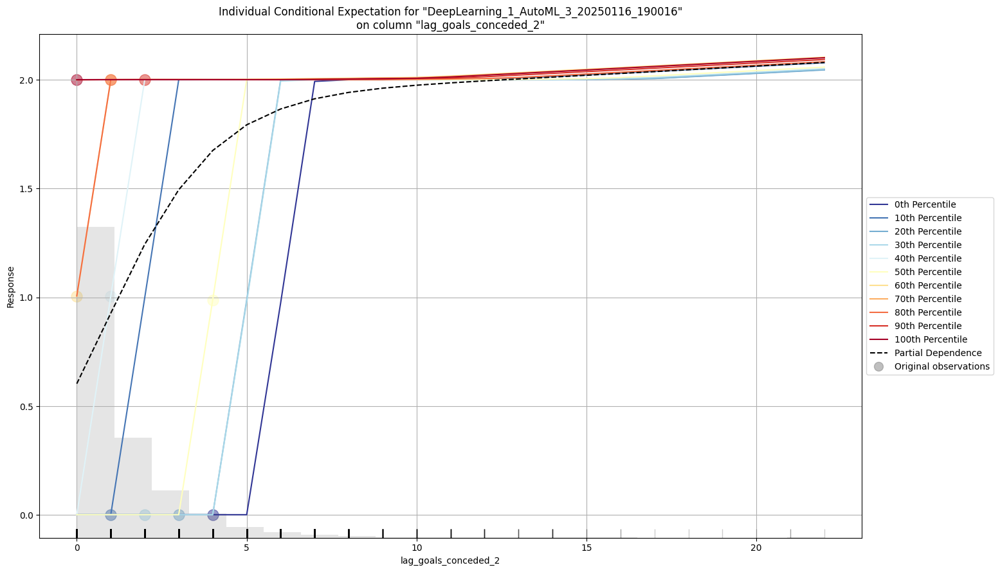

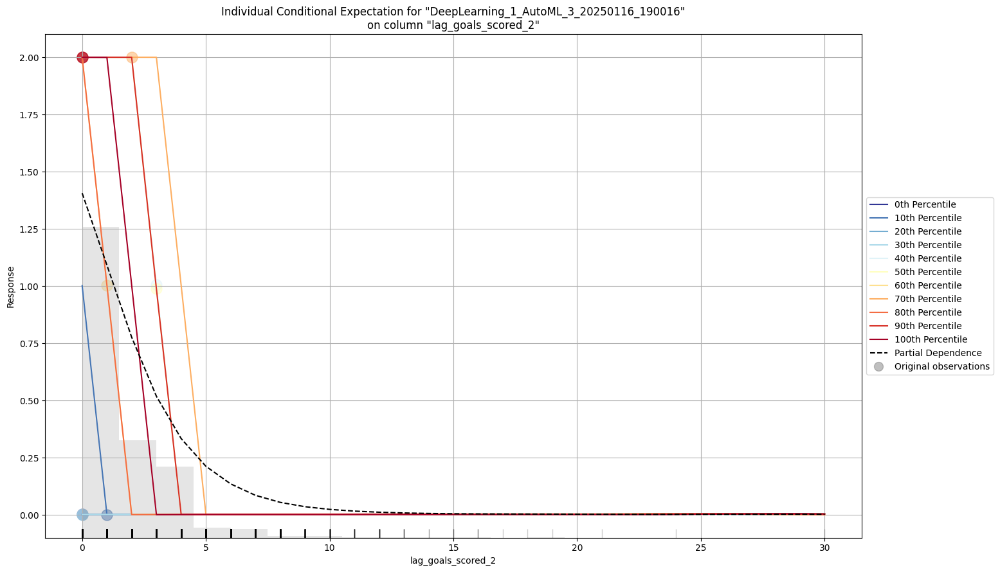

In [ ]:
amlw.explain(frame=test)

In [ ]:
best_model = amlw.leader
model_perf = best_model.model_performance(test)
print("Model Performance:", model_perf)

Model Performance: ModelMetricsRegression: deeplearning
** Reported on test data. **

MSE: 2.7554775462629197e-05
RMSE: 0.005249264278223111
MAE: 0.002496652765524997
RMSLE: 0.002722996632415275
Mean Residual Deviance: 2.7554775462629197e-05


In [ ]:
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

# Предсказания на тестовом наборе
y_pred = amlw.leader.predict(test)
y_pred_df = y_pred.as_data_frame()['predict']

# Извлечение истинных значений из тестового набора
y_test_df = test['match_result'].as_data_frame()['match_result']
y_pred_df = y_pred_df.astype(y_test_df.dtype)

# Вычисление accuracy
accuracy = accuracy_score(y_test_df, y_pred_df)

# Матрица ошибок (confusion matrix)
cm = confusion_matrix(y_test_df, y_pred_df)

print(f"Accuracy: {accuracy}")
print("Confusion Matrix:\n", cm)  # Вывод confusion matrix
print(classification_report(y_test_df, y_pred_df))

deeplearning prediction progress: |██████████████████████████████████████████████| (done) 100%
Accuracy: 0.7677652986249607
Confusion Matrix:
 [[7357    0    0]
 [2590 1763    0]
 [   0 1835 5509]]
              precision    recall  f1-score   support

           0       0.74      1.00      0.85      7357
           1       0.49      0.41      0.44      4353
           2       1.00      0.75      0.86      7344

    accuracy                           0.77     19054
   macro avg       0.74      0.72      0.72     19054
weighted avg       0.78      0.77      0.76     19054



/usr/local/lib/python3.11/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install polars and pyarrow and use it as pandas_df = h2o_df.as_data_frame(use_multi_thread=True)

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"
/usr/local/lib/python3.11/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install polars and pyarrow and use it as pandas_df = h2o_df.as_data_frame(use_multi_thread=True)

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


In [ ]:
y_pred_proba = y_pred.as_data_frame()[y_pred.as_data_frame().columns[1:]].to_numpy()
roc_auc = roc_auc_score(y_test_df, y_pred_proba, multi_class='ovr', average='weighted')

/usr/local/lib/python3.11/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install polars and pyarrow and use it as pandas_df = h2o_df.as_data_frame(use_multi_thread=True)

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"
/usr/local/lib/python3.11/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install polars and pyarrow and use it as pandas_df = h2o_df.as_data_frame(use_multi_thread=True)

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


ValueError: Found array with 0 feature(s) (shape=(19054, 0)) while a minimum of 1 is required.

## TPOT (переобученный)

In [ ]:
target = 'match_result'
X = data.drop(columns=[target])
y = data[target]

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
from sklearn.model_selection import StratifiedKFold

In [ ]:
tpot = TPOTClassifier(
        generations=5,
        population_size=25,
        verbosity=3,
        random_state=42,
        n_jobs=-1,
        max_time_mins=90,
        scoring='balanced_accuracy',
        cv=StratifiedKFold(n_splits=5),
        warm_start=True
    )

In [ ]:
# Запуск обучения
tpot.fit(X_train, y_train)

32 operators have been imported by TPOT.


Optimization Progress:   0%|          | 0/25 [00:00<?, ?pipeline/s]


Generation 1 - Current Pareto front scores:

-1	1.0	MLPClassifier(input_matrix, MLPClassifier__alpha=0.0001, MLPClassifier__learning_rate_init=0.001)
_pre_test decorator: _random_mutation_operator: num_test=0 Unsupported set of arguments: The combination of penalty='l2' and loss='hinge' are not supported when dual=False, Parameters: penalty='l2', loss='hinge', dual=False.
Skipped pipeline #71 due to time out. Continuing to the next pipeline.

Generation 2 - Current Pareto front scores:

-1	1.0	MLPClassifier(input_matrix, MLPClassifier__alpha=0.0001, MLPClassifier__learning_rate_init=0.001)
_pre_test decorator: _random_mutation_operator: num_test=0 Solver lbfgs supports only 'l2' or None penalties, got l1 penalty..
_pre_test decorator: _random_mutation_operator: num_test=0 Negative values in data passed to MultinomialNB (input X).
Skipped pipeline #77 due to time out. Continuing to the next pipeline.
Skipped pipeline #88 due to time out. Continuing to the next pipeline.
Skipped pipelin

TPOTClassifier(cv=StratifiedKFold(n_splits=5, random_state=None, shuffle=False),
               generations=5, max_time_mins=90, n_jobs=-1, population_size=25,
               random_state=42, scoring='balanced_accuracy', verbosity=3,
               warm_start=True)

In [ ]:
if hasattr(tpot.fitted_pipeline_, 'transform'):
    transformed_X_train = tpot.fitted_pipeline_.transform(X_train)
    print("Features после трансформации(TPOT):", transformed_X_train.shape)
if hasattr(tpot.fitted_pipeline_.steps[-1][1], 'feature_importances_'):
    importances = tpot.fitted_pipeline_.steps[-1][1].feature_importances_
    feature_names = X_train.columns
    feature_importance_df = pd.DataFrame({'feature': feature_names, 'importance': importances})
    feature_importance_df = feature_importance_df.sort_values(by=['importance'], ascending=False)

    # Визуализация
    plt.figure(figsize=(10, 6))
    sns.barplot(x='importance', y='feature', data=feature_importance_df)
    plt.title('TPOT Feature Importance')
    plt.show()

In [ ]:
y_pred = tpot.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
cm = confusion_matrix(y_test, y_pred)

print(f"Accuracy: {accuracy}")
print(f"F1-score: {f1}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print("Confusion Matrix:\n", cm)
print(classification_report(y_test, y_pred))

Accuracy: 1.0
F1-score: 1.0
Precision: 1.0
Recall: 1.0
Confusion Matrix:
 [[7373    0    0]
 [   0 4299    0]
 [   0    0 7383]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      7373
           1       1.00      1.00      1.00      4299
           2       1.00      1.00      1.00      7383

    accuracy                           1.00     19055
   macro avg       1.00      1.00      1.00     19055
weighted avg       1.00      1.00      1.00     19055



## AutoGluon

In [ ]:
!pip install autogluon.tabular[all]
from autogluon.tabular import TabularPredictor

In [ ]:
target = 'match_result'
features = data.drop(columns=['match_result'])
data.dropna(subset=[target], inplace=True)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(
    features, data[target], test_size=0.2, random_state=42)

In [ ]:
# Объединяем X и y для AutoGluon (он требует один датафрейм)
train_data = pd.concat([X_train, y_train.reset_index(drop=True)], axis=1)
test_data = pd.concat([X_test, y_test.reset_index(drop=True)], axis=1)

In [ ]:
# Инициализируем AutoGluon
predictor = TabularPredictor(label=target, problem_type='multiclass', eval_metric='f1_weighted')

No path specified. Models will be saved in: "AutogluonModels/ag-20250116_201952"


In [ ]:
train_data.dropna(subset=[target], inplace=True)
test_data.dropna(subset=[target], inplace=True)

In [ ]:
train_data.head()

,date,team,is_home,rolling_avg_goals_scored_3,rolling_avg_goals_conceded_3,rolling_avg_goals_scored_5,rolling_avg_goals_conceded_5,lag_goals_scored_1,lag_goals_conceded_1,lag_goals_scored_2,lag_goals_conceded_2,rolling_goal_diff,match_result
41934,2018-05-28,Italy,1.0,1.000000,1.333333,0.6,1.0,1.0,1.0,0.0,2.0,-0.333333,2.0
16132,1999-05-29,Colombia,0.0,1.333333,1.000000,1.4,1.2,2.0,0.0,1.0,1.0,0.333333,0.0
20648,2014-06-05,Darfur,1.0,0.000000,17.000000,0.2,14.8,0.0,19.0,0.0,20.0,-17.000000,1.0
41996,2023-09-12,Italy,1.0,2.000000,1.333333,1.8,1.2,1.0,1.0,3.0,2.0,0.666667,1.0
53074,2014-11-14,Martinique,1.0,0.666667,1.333333,0.8,0.8,1.0,1.0,1.0,0.0,-0.666667,2.0


In [ ]:
predictor.fit(
    train_data=train_data,
    time_limit=7200,  # Время выполнения (1 час)
    presets='good_quality_faster_inference_only_refit'  # Акцент на качество
)

Preset alias specified: 'good_quality_faster_inference_only_refit' maps to 'good_quality'.
Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.2
Python Version:     3.11.11
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #1 SMP PREEMPT_DYNAMIC Thu Jun 27 21:05:47 UTC 2024
CPU Count:          2
Memory Avail:       7.84 GB / 12.67 GB (61.8%)
Disk Space Avail:   74.64 GB / 107.72 GB (69.3%)
Presets specified: ['good_quality_faster_inference_only_refit']
Setting dynamic_stacking from 'auto' to True. Reason: Enable dynamic_stacking when use_bag_holdout is disabled. (use_bag_holdout=False)
Stack configuration (auto_stack=True): num_stack_levels=1, num_bag_folds=8, num_bag_sets=1
Note: `save_bag_folds=False`! This will greatly reduce peak disk usage during fit (by ~8x), but runs the risk of an out-of-memory error during model refit if memory is small relative to the data size.
	You can avoid this risk by setting `s

In [ ]:
# Оценка на тестовом наборе
performance = predictor.evaluate(test_data)
print(performance)

{'f1_weighted': 0.2722964671102842, 'accuracy': 0.3872999212805038, 'balanced_accuracy': 0.3334376554884632, 'mcc': 0.0006317373305956232}


In [ ]:
!pip install dask[dataframe]

In [ ]:
# Важность признаков
feature_importances = predictor.feature_importance(test_data)
print("Feature Importances:\n", feature_importances)

Computing feature importance via permutation shuffling for 12 features using 5000 rows with 5 shuffle sets...
	131.18s	= Expected runtime (26.24s per shuffle set)
	110.99s	= Actual runtime (Completed 5 of 5 shuffle sets)


Feature Importances:
                               importance    stddev   p_value  n  p99_high  \
is_home                         0.006606  0.002354  0.001647  5  0.011453   
lag_goals_conceded_2            0.000991  0.003104  0.257386  5  0.007383   
lag_goals_conceded_1            0.000896  0.003017  0.271432  5  0.007109   
rolling_avg_goals_scored_3     -0.002157  0.002341  0.945793  5  0.002663   
rolling_avg_goals_conceded_5   -0.003478  0.002371  0.984752  5  0.001404   
date                           -0.008534  0.004587  0.992927  5  0.000911   
lag_goals_scored_1             -0.010380  0.002234  0.999758  5 -0.005781   
rolling_avg_goals_scored_5     -0.010492  0.005474  0.993605  5  0.000779   
rolling_goal_diff              -0.012161  0.002088  0.999900  5 -0.007863   
rolling_avg_goals_conceded_3   -0.023875  0.003495  0.999946  5 -0.016679   
team                           -0.026047  0.004180  0.999923  5 -0.017440   
lag_goals_scored_2             -0.028476  0.003168  0.

In [ ]:
predictor.leaderboard(test_data, extra_info=True)

,model,score_test,score_val,eval_metric,pred_time_test,pred_time_val,fit_time,pred_time_test_marginal,pred_time_val_marginal,fit_time_marginal,...,hyperparameters,hyperparameters_fit,ag_args_fit,features,compile_time,child_hyperparameters,child_hyperparameters_fit,child_ag_args_fit,ancestors,descendants
0,LightGBMXT_BAG_L2_FULL,0.275122,NaN,f1_weighted,6.902522,NaN,398.169362,3.412553,NaN,31.047171,...,"{'use_orig_features': True, 'valid_stacker': True, 'max_base_models': 0, 'max_base_models_per_type': 'auto', 'save_bag_folds': True}",{},"{'max_memory_usage_ratio': 1.15, 'max_time_limit_ratio': 1.0, 'max_time_limit': None, 'min_time_limit': 0, 'valid_raw_types': None, 'valid_special_types': None, 'ignored_type_group_special': None, 'ignored_type_group_raw': None, 'get_features_kwargs': None, 'get_features_kwargs_extra': None, 'predict_1_batch_size': None, 'temperature_scalar': None, 'drop_unique': False}","[LightGBM_BAG_L1_0, date, LightGBMXT_BAG_L1_1, LightGBMLarge_BAG_L1_2, rolling_avg_goals_scored_3, team, RandomForestEntr_BAG_L1_1, CatBoost_BAG_L1_2, rolling_avg_goals_conceded_5, date.dayofweek, NeuralNetFastAI_BAG_L1_1, CatBoost_BAG_L1_0, ExtraTreesEntr_BAG_L1_1, NeuralNetTorch_BAG_L1_1, XGBoost_BAG_L1_1, LightGBMLarge_BAG_L1_1, lag_goals_scored_2, is_home, date.year, NeuralNetTorch_BAG_L1_0, date.day, ExtraTreesGini_BAG_L1_1, rolling_avg_goals_conceded_3, date.month, ExtraTreesEntr_BAG_L1_0, XGBoost_BAG_L1_2, lag_goals_scored_1, NeuralNetFastAI_BAG_L1_0, lag_goals_conceded_1, rolling_a...",None,"{'learning_rate': 0.05, 'extra_trees': True, 'num_boost_round': 467}",{'num_boost_round': 467},"{'max_memory_usage_ratio': 1.0, 'max_time_limit_ratio': 1.0, 'max_time_limit': None, 'min_time_limit': 0, 'valid_raw_types': ['bool', 'int', 'float', 'category'], 'valid_special_types': None, 'ignored_type_group_special': None, 'ignored_type_group_raw': None, 'get_features_kwargs': None, 'get_features_kwargs_extra': None, 'predict_1_batch_size': None, 'temperature_scalar': None}","[LightGBMXT_BAG_L1_FULL, NeuralNetTorch_BAG_L1_FULL, LightGBM_BAG_L1_FULL, XGBoost_BAG_L1_FULL, ExtraTreesGini_BAG_L1_FULL, RandomForestGini_BAG_L1_FULL, ExtraTreesEntr_BAG_L1_FULL, NeuralNetFastAI_BAG_L1_FULL, CatBoost_BAG_L1_FULL, RandomForestEntr_BAG_L1_FULL, LightGBMLarge_BAG_L1_FULL]",[]
1,RandomForestEntr_BAG_L1_FULL,0.273561,NaN,f1_weighted,0.454687,3.680614,38.221711,0.454687,3.680614,38.221711,...,"{'use_orig_features': True, 'valid_stacker': True, 'max_base_models': 0, 'max_base_models_per_type': 'auto', 'save_bag_folds': True, 'use_child_oof': True}",{},"{'max_memory_usage_ratio': 1.0, 'max_time_limit_ratio': 1.0, 'max_time_limit': None, 'min_time_limit': 0, 'valid_raw_types': None, 'valid_special_types': None, 'ignored_type_group_special': None, 'ignored_type_group_raw': None, 'get_features_kwargs': None, 'get_features_kwargs_extra': None, 'predict_1_batch_size': None, 'temperature_scalar': None, 'drop_unique': False}","[date.year, rolling_avg_goals_scored_5, date, date.dayofweek, rolling_avg_goals_scored_3, team, rolling_avg_goals_conceded_5, lag_goals_conceded_2, date.day, date.month, rolling_avg_goals_conceded_3, lag_goals_scored_2, is_home, lag_goals_conceded_1, lag_goals_scored_1, rolling_goal_diff]",None,"{'n_estimators': 300, 'max_leaf_nodes': 15000, 'n_jobs': -1, 'random_state': 0, 'bootstrap': True, 'criterion': 'entropy', 'max_depth': 15}",{'n_estimators': 300},"{'max_memory_usage_ratio': 1.0, 'max_time_limit_ratio': 1.0, 'max_time_limit': None, 'min_time_limit': 0, 'valid_raw_types': ['bool', 'int', 'float', 'category'], 'valid_special_types': None, 'ignored_type_group_special': None, 'ignored_type_group_raw': None, 'get_features_kwargs': None, 'get_features_kwargs_extra': None, 'predict_1_batch_size': None, 'temperature_scalar': None}",[],"[NeuralNetFastAI_BAG_L2_FULL, ExtraTreesEntr_BAG_L2_FULL, RandomForestEntr_BAG_L2_FULL, XGBoost_BAG_L2_FULL, LightGBMXT_BAG_L2_FULL, ExtraTreesGini_BAG_L2_FULL, WeightedEnsemble_L3_FULL, RandomForest

In [ ]:
y_pred = predictor.predict(test_data)
y_pred_proba = predictor.predict_proba(test_data)

In [ ]:
best_model = predictor.model_best
print(best_model)
print(predictor.info())

WeightedEnsemble_L3_FULL
{'path': '/content/AutogluonModels/ag-20250116_201952', 'label': 'match_result', 'random_state': 0, 'version': '1.2', 'features': ['date', 'team', 'is_home', 'rolling_avg_goals_scored_3', 'rolling_avg_goals_conceded_3', 'rolling_avg_goals_scored_5', 'rolling_avg_goals_conceded_5', 'lag_goals_scored_1', 'lag_goals_conceded_1', 'lag_goals_scored_2', 'lag_goals_conceded_2', 'rolling_goal_diff'], 'feature_metadata_in': <autogluon.common.features.feature_metadata.FeatureMetadata object at 0x7ab3e16b8d50>, 'time_fit_preprocessing': 0.7591912746429443, 'time_fit_training': 5235.971549272537, 'time_fit_total': 5236.73074054718, 'time_limit': 5201.408203601837, 'time_train_start': 1737060807.4206376, 'num_rows_train': 76216, 'num_cols_train': 16, 'num_rows_val': None, 'num_rows_test': None, 'num_classes': 3, 'problem_type': 'multiclass', 'eval_metric': 'f1_weighted', 'best_model': 'WeightedEnsemble_L3_FULL', 'best_model_score_val': None, 'best_model_stack_level': 3, 'nu

In [ ]:
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')  # Или 'macro', 'micro'
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
roc_auc = roc_auc_score(y_test, y_pred_proba, multi_class='ovr', average='weighted')

print(f"Accuracy: {accuracy}")
print(f"F1-score: {f1}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"ROC-AUC: {roc_auc}")
print(classification_report(y_test, y_pred))

Accuracy: 0.3876672789294148
F1-score: 0.27298496024537816
Precision: 0.33921490183893926
Recall: 0.3876672789294148
ROC-AUC: 0.5002459022554391
              precision    recall  f1-score   support

           0       0.40      0.10      0.16      7373
           1       0.16      0.00      0.00      4299
           2       0.39      0.90      0.54      7383

    accuracy                           0.39     19055
   macro avg       0.31      0.33      0.24     19055
weighted avg       0.34      0.39      0.27     19055

